In [1]:
using Gen

In [2]:
using PyPlot

In [3]:
using Random

# Pool Ball World Generative Model Testing

A Hamilos [ahamilos at g.harvard.edu] modified 12/12/2020

### Our generative model for our machine will generate scenarios for poolballs on a table.
    It will simultaneously generate parameters to physically simulate the scenario
    It will also generate a set of linguistic descriptors for each scenario. All the possible descriptors will be generated, but only one will be provided to the inference module
    
### Example:
    -- Randomly decide there are 3 balls on the table
        ballcount = 3
        descriptor 1: "There are 3 balls on the table"
        descriptor 2: "There are > 2 balls on the table."
        descriptor 3: "There is > 1 ball on the table."
        descriptor 4: "There is at least 1 ball on the table."
        descriptor 5: "There are no more than 3+n balls on the table"
    -- Randomly decide positions for each ball
        for i ball, x = ix, y = iy
        descriptor 1: "There is a ball at (ix,iy), (i2x,i2y), and (i3x,i3y)
        descriptor 2: "At least 2 balls are on the left half of the table"
        descriptor 3: "All the balls are on the same side of the table"
        descriptor 4: "The balls are close to each other" (say close if distance is < 1/2 of table apart
        descriptor 5: "One of the balls is near a pocket"
    -- Randomly decide if each ball is moving--assign speed and angle heading (or whatever the engine needs to initialize)
        for i ball, speed = unif(0,1) -- if 1, assign new speed (fast or slow) and angle
        descriptor 1: "The ball at ix,iy is moving at angle 300-deg at 2 units/s, the other balls are stationary" (literal)
        descriptor 2: "One of the balls is moving fast"
        descriptor 3: "None of the balls is moving"
    
    
### The inference we wish to do is to model a visual/physical scenario from the verbal description
     -- Inference question type 1:
         Posterior distribution over ball positions
     -- Question type 2:
         Most likely ball positions
     -- Question type 3:
         What is probability of a ball going into a pocket?
         What is probability of two balls colliding?


## Generic functions

In [24]:
function warning(msg::String)
    red = "\033[1m\033[31m" 
    println("*************************************")
    println(string("     WARNING: ", msg))
    println("*************************************")
    return
end
function getEuclideanDistance(pos1::Tuple, pos2::Tuple)
    x1 = pos1[1];
    x2 = pos2[1];
    y1 = pos1[2];
    y2 = pos2[2];
    distance = sqrt((x2-x1)^2 + (y2-y1)^2)
    return distance 
end;
function isclose(pos1, pos2, threshold)
    d = getEuclideanDistance(pos1, pos2)
    if d < threshold
        return true
    else
        return false
    end
end;
@gen function flip(output1, output2, p)
    if ({:flip} ~ bernoulli(p))
        return output1
    else
        return output2
    end
end;
function pretty_print_list(myList)
    for i in myList
       println(i) 
    end
end;
warning("your mom")

*************************************
*************************************


## Dictionary of phrases for number of ball scenarios

In [25]:
#
# Now we need to assign some statements to the situation
#
function get_number_descriptors(n)
    statements = [];
    if n==1
        push!(statements, string("There is ", n, " ball on the table."))
    else
        push!(statements, string("There are ", n, " balls on the table."))
    end
    if n > 0  
        # at least 1 ball
        push!(statements,"There is at least 1 ball on the table.")
        if n > 1
            # at least 2 balls
            push!(statements, "There are at least 2 balls on the table.")
            push!(statements, "There are some balls on the table.")
            if n > 2
                # 3 balls
                push!(statements, "There are at least 3 balls on the table.")
                push!(statements, "There are a lot of balls on the table.")
            else    
                # 2 balls
                push!(statements, "There are no more than 2 balls on the table.")
                push!(statements, "There are fewer than 3 balls on the table.")
            end
        else
            # 1 ball
            push!(statements, "There are not many balls on the table.")
            push!(statements, "There is no more than 1 ball on the table.")
            push!(statements, "There are no more than 2 balls on the table.")
            push!(statements, "There are fewer than 2 balls on the table.")
            push!(statements, "There are fewer than 3 balls on the table.")
        end    
        push!(statements, "There are no more than 3 balls on the table.")
    else
        push!(statements, "There is fewer than 1 ball on the table.")
        push!(statements, "There are fewer than 2 balls on the table.")
        push!(statements, "There are fewer than 3 balls on the table.")
        push!(statements, "There is no more than 1 ball on the table.")
        push!(statements, "There are no more than 2 balls on the table.")
        push!(statements, "There are no more than 3 balls on the table.")
        push!(statements, "There are not many balls on the table.")        
    end
    # generic cases
    push!(statements, "There could be some balls on the table.")
    #
    # Get the statement ID #s for each statement from the dictionary
    #
    
    return statements
end;

function descriptor_dictionary()
    #     
    #     This exists for the purpose of numerical indexing for Gen choicemap
    #     
    statements = [];
    push!(statements, string("There are ", 0, " balls on the table."))
    push!(statements, string("There is ", 1, " ball on the table."))
    push!(statements, string("There are ", 2, " balls on the table."))
    push!(statements, string("There are ", 3, " balls on the table."))
    push!(statements, "There could be some balls on the table.")
    push!(statements, "There are some balls on the table.")
    push!(statements, "There are not many balls on the table.")
    push!(statements, "There are a lot of balls on the table.")
    push!(statements, "There is fewer than 1 ball on the table.")
    push!(statements, "There are fewer than 2 balls on the table.")
    push!(statements, "There are fewer than 3 balls on the table.")
    push!(statements, "There is no more than 1 ball on the table.")
    push!(statements, "There are no more than 2 balls on the table.")
    push!(statements, "There are no more than 3 balls on the table.")
    push!(statements, "There is at least 1 ball on the table.")
    push!(statements, "There are at least 2 balls on the table.")
    push!(statements, "There are at least 3 balls on the table.")
    return statements
end;

function get_statement_ID(statements)
    return findall(in.(descriptor_dictionary(), [statements]))
end;

## Dictionary of position descriptors

In [26]:
isodd(2), isodd(3)

(false, true)

In [27]:
function get_position_descriptors(xs,ys,tableSize)
    statements = [];
    isleft = [];
    isbottom = [];
    xs = [round.(x, digits=2) for x in xs]
    ys = [round.(x, digits=2) for x in ys]
    for i = 1:length(xs)
        push!(statements, string("There is a ball at (x,y) = (", xs[i], ",", ys[i], ")."))
        #
        #   Relative position
        #
        # left side
        if xs[i] < tableSize[1]/2
            push!(statements, string("There is a ball on the left half of the table."))
            push!(isleft,true)
            if ys[i] < tableSize[2] /2   
                push!(statements, string("There is a ball on the bottom half of the table."))
                push!(statements, string("There is a ball in the bottom left quadrant of the table."))
                push!(isbottom,true)
            else
                push!(statements, string("There is a ball on the top half of the table."))
                push!(statements, string("There is a ball in the top left quadrant of the table."))
                push!(isbottom,false)
            end
        else
            push!(statements, string("There is a ball on the right half of the table."))
            push!(isleft,false)
            if ys[i] < tableSize[2]/2   
                push!(statements, string("There is a ball on the bottom half of the table."))
                push!(statements, string("There is a ball in the bottom right quadrant of the table."))
                push!(isbottom,true)
            else
                push!(statements, string("There is a ball on the top half of the table."))
                push!(statements, string("There is a ball in the top right quadrant of the table."))
                push!(isbottom,false)
            end
        end    
        
        if i==2
            push!(statements, string("There are balls at (x,y) = (", xs[1], ",", ys[1], ") and (", xs[2], ",", ys[2], ")."))        
            if length(xs) == 2
                fetch_quadrant_descriptions(isleft, isbottom, statements, 1, 2, true)
            else
                fetch_quadrant_descriptions(isleft, isbottom, statements, 1, 2, false)
            end
        end
        if i==3
            push!(statements, string("There are balls at (x,y) = (", xs[1], ",", ys[1], ") and (", xs[3], ",", ys[3], ")."))
            push!(statements, string("There are balls at (x,y) = (", xs[2], ",", ys[2], ") and (", xs[3], ",", ys[3], ")."))
            push!(statements, string("There are balls at (x,y) = (", xs[1], ",", ys[1], "), (", xs[2], ",", ys[2], "), and (", xs[3], ",", ys[3],")."))
            fetch_quadrant_descriptions(isleft, isbottom, statements, 1, 3, false)
            fetch_quadrant_descriptions(isleft, isbottom, statements, 2, 3, false)

            q1 = get_quadrant(isleft[1], isbottom[1])
            q2 = get_quadrant(isleft[2], isbottom[2])
            q3 = get_quadrant(isleft[3], isbottom[3])
            
            if q1 == q2 == q3
                push!(statements, string("All 3 balls are in the same quadrant."))
                if q1 == 1
                    push!(statements, string("All 3 balls are in the top left quadrant."))
                elseif q1 == 2
                    push!(statements, string("All 3 balls are in the top right quadrant."))
                elseif q1 == 3
                    push!(statements, string("All 3 balls are in the bottom right quadrant."))
                else
                    push!(statements, string("All 3 balls are in the bottom left quadrant."))
                end
            else
                if isodd(q1) == isodd(q2) == isodd(q3)
                    push!(statements, string("All the balls are in opposite corner quadrants."))
                    if !isodd(q1)
                        push!(statements, string("All the balls are in opposite corner quadrants: bottom left and top right."))
                    else
                        push!(statements, string("All the balls are in opposite corner quadrants: top left and bottom right."))
                    end
                end
            end
            if !(isbottom[1] == isbottom[2] == isbottom[3]) && (isleft[1] == isleft[2] == isleft[3])
                push!(statements, string("All the balls are on the same half (left/right) of the table, but they are in different quadrants."))
                if isleft[1]
                    push!(statements, string("All the balls are on the left half of the table, but they are in different quadrants."))
                            push!(statements, string("There are 3 balls on the left half of the table, but they are in different quadrants."))
                else
                    push!(statements, string("All the balls are on the right half of the table, but they are in different quadrants."))
                    push!(statements, string("There are 3 balls on the right half of the table, but they are in different quadrants."))
                end
            end
            if !isleft[1] && !isleft[2] && !isleft[3]
                push!(statements, string("All the balls are on the right half of the table."))
                push!(statements, string("There are 3 balls on the same half (left/right) of the table."))
                push!(statements, string("There are 3 balls on the right half of the table."))
            end
            if isleft[1] && isleft[2] && isleft[3]
                push!(statements, string("All the balls are on the left half of the table."))
                push!(statements, string("There are 3 balls on the same half (left/right) of the table."))
                push!(statements, string("There are 3 balls on the left half of the table."))
            end
            # all 3 on bottom
            if isbottom[1] == isbottom[2] == isbottom[3]
                push!(statements, string("All the balls are on the same half (top/bottom) of the table."))
                push!(statements, string("There are 3 balls on the same half (top/bottom) of the table."))
                if isbottom[1]
                    push!(statements, string("All the balls are on the bottom half of the table."))
                    push!(statements, string("There are 3 balls on the bottom half of the table."))
                    if isleft[1] == isleft[2] == isleft[3]
                        push!(statements, string("All the balls are on the bottom half of the table, and they are in the same quadrant."))
                        push!(statements, string("There are 3 balls are on the bottom half of the table, and they are in the same quadrant."))        
                    else
                        push!(statements, string("There are 3 balls on the bottom half of the table, but they are in different quadrants."))
                        push!(statements, string("All the balls are on the bottom half of the table, but they are in different quadrants."))
                    end
                else
                    push!(statements, string("All the balls are on the top half of the table."))
                    push!(statements, string("There are 3 balls on the top half of the table."))
                    if isleft[1] == isleft[2] == isleft[3]
                        push!(statements, string("All the balls are on the top half of the table, and they are in the same quadrant."))
                        push!(statements, string("There are 3 balls are on the top half of the table, and they are in the same quadrant."))        
                    else
                        push!(statements, string("There are 3 balls on the top half of the table, but they are in different quadrants."))
                        push!(statements, string("All the balls are on the top half of the table, but they are in different quadrants."))
                    end
                end
                if isleft[1] == isleft[2] == isleft[3]
                    push!(statements, string("All the balls are on the same half (left/right) of the table."))
                    push!(statements, string("All the balls are in the same quadrant of the table."))
                    push!(statements, string("There are 3 balls in the same quadrant of the table."))
                    if isleft[1]
                        push!(statements, string("All the balls are in the same quadrant of the table and on the left side of the table."))
                        push!(statements, string("There are 3 balls in the same quadrant of the table and on the left side of the table."))
                        if isbottom[1]
                            push!(statements, string("All the balls are in the bottom left quadrant of the table."))
                            push!(statements, string("There are 3 balls in the bottom left quadrant of the table."))
                        else
                            push!(statements, string("All the balls are in the top left quadrant of the table."))
                            push!(statements, string("There are 3 balls in the top left quadrant of the table."))
                        end
                        
                    else
                        push!(statements, string("All the balls are in the same quadrant of the table and on the right side of the table."))
                        push!(statements, string("There are 3 balls in the same quadrant of the table and on the right side of the table."))
                        
                        if isbottom[1]
                            push!(statements, string("All the balls are in the bottom right quadrant of the table."))
                            push!(statements, string("There are 3 balls in the bottom right quadrant of the table."))
                        else
                            push!(statements, string("All the balls are in the top right quadrant of the table."))
                            push!(statements, string("There are 3 balls in the top right quadrant of the table."))
                        end
                    end
                end
            end
        end           
    end
    
    
    return statements
end;

function get_quadrant(isleft,isbottom)
    if isleft && !isbottom
        q = 1
    elseif !isleft && !isbottom
        q = 2
    elseif !isleft && isbottom
        q = 3
    else
        q = 4
    end
    return q
end

function fetch_quadrant_descriptions(isleft, isbottom, statements, i1, i2, all_accounted)
    # both in same top/bottom half
    if isbottom[i1] == isbottom[i2]
        push!(statements, string("There are two balls on the same half (top/bottom) of the table.")) 
        if all_accounted
            push!(statements, string("All the balls are on the same half (top/bottom) of the table.")) 
        end
        # both balls on bottom half
        if isbottom[i1]
            push!(statements, string("There are two balls on the bottom half of the table.")) 
            if all_accounted
                push!(statements, string("All the balls are on the bottom half of the table.")) 
            end
            if isleft[i1] == isleft[i2]
                push!(statements, string("There are two balls on the bottom half of the table, and they are in the same quadrant."))
                if all_accounted
                    push!(statements, string("All the balls are on the bottom half of the table, and they are in the same quadrant.")) 
                end
                if isleft[1]
                    push!(statements, string("There are two balls in the bottom left quadrant of the table."))
                    if all_accounted
                        push!(statements, string("All the balls are in the bottom left quadrant of the table."))
                    end
                else
                    push!(statements, string("There are two balls in the bottom right quadrant of the table."))
                    if all_accounted
                        push!(statements, string("All the balls are in the bottom right quadrant of the table."))
                    end
                end
            else
                push!(statements, string("There are two balls on the bottom half of the table, but they are in different quadrants."))
                if all_accounted
                    push!(statements, string("All the balls are on the bottom half of the table, but they are in different quadrants."))
                end
            end

        # both balls on upper half
        else
            push!(statements, string("There are two balls on the top half of the table.")) 
            if all_accounted
                push!(statements, string("All the balls are on the top half of the table.")) 
            end
            # balls in same upper quadrant
            if isleft[i1] == isleft[i2]
                push!(statements, string("There are two balls on the top half of the table, and they are in the same quadrant."))
                if all_accounted
                    push!(statements, string("All the balls are on the top half of the table, and they are in the same quadrant."))
                end
                # balls in upper left quad    
                if isleft[i1]
                    push!(statements, string("There are two balls in the top left quadrant of the table."))
                    if all_accounted
                        push!(statements, string("All the balls are in the top left quadrant of the table."))
                    end
                # balls in upper right quad
                else
                    push!(statements, string("There are two balls in the top right quadrant of the table."))
                    if all_accounted
                        push!(statements, string("All the balls are in the top right quadrant of the table."))
                    end
                end
            # balls in different upper quads
            else
                push!(statements, string("There are two balls on the top half of the table, but they are in different quadrants."))
                if all_accounted
                    push!(statements, string("All the balls are on the top half of the table, but they are in different quadrants."))
                end
            end
        end

    # balls in opposite top/bottom half 
    else
        push!(statements, string("There are two balls on opposite halves (top/bottom) of the table."))   
        if all_accounted
            push!(statements, string("All the balls are on opposite halves (top/bottom) of the table."))   
        end
        # both on same L/R side, oppo quads
        if isleft[i1] == isleft[i2]
            push!(statements, string("There are two balls on the same half (left/right) of the table, but they are in different quadrants."))
            if all_accounted
                push!(statements, string("All the balls are on the same half (left/right) of the table, but they are in different quadrants."))
            end
            # balls on left, oppo quads
            if isleft[i1]
                push!(statements, string("There are two balls on the left half of the table, but they are in different quadrants."))
                if all_accounted
                    push!(statements, string("All the balls are on the left half of the table, but they are in different quadrants."))
                end
            # balls in oppo right quads
            else
                push!(statements, string("There are two balls on the right half of the table, but they are in different quadrants."))
                if all_accounted
                    push!(statements, string("All the balls are on the right half of the table, but they are in different quadrants."))
                end
            end
        # balls in opposite corners
        else
            push!(statements, string("There are two balls in opposite corner quadrants."))
            if all_accounted
                push!(statements, string("All the balls are in opposite corner quadrants."))
            end
            if isleft[i1] && isbottom[i1] || isleft[i2] && isbottom[i2]
                push!(statements, string("There are two balls in opposite corner quadrants: bottom left and top right."))
                if all_accounted
                    push!(statements, string("All the balls are in opposite corner quadrants: bottom left and top right."))
                end
            else
                push!(statements, string("There are two balls in opposite corner quadrants: top left and bottom right."))
                if all_accounted
                    push!(statements, string("All the balls are in opposite corner quadrants: top left and bottom right."))
                end
            end
        end
    end

    # simple l/r cases
    if isleft[i1] == isleft[i2]
        push!(statements, string("There are two balls on the same half (left/right) of the table."))                  
        if all_accounted
            push!(statements, string("All the balls are on the same half (left/right) of the table."))                  
        end
        if isleft[i1]
            push!(statements, string("There are two balls on the left half of the table."))                  
            if all_accounted
                push!(statements, string("All the balls are on the left half of the table."))                  
            end
            if isbottom[i1] && isbottom[i2]
                push!(statements, string("There are two balls in the same quadrant of the table and on the left side of the table."))
                push!(statements, string("There are two balls in the bottom left quadrant of the table."))
                if all_accounted
                    push!(statements, string("All the balls are in the same quadrant of the table and on the left side of the table."))
                    push!(statements, string("All the balls are in the bottom left quadrant of the table."))
                end
            elseif !isbottom[i1] && !isbottom[i2]
                push!(statements, string("There are two balls in the same quadrant of the table and on the left side of the table."))
                push!(statements, string("There are two balls in the top left quadrant of the table."))
                if all_accounted
                    push!(statements, string("All the balls are in the same quadrant of the table and on the left side of the table."))
                    push!(statements, string("All the balls are in the top left quadrant of the table."))
                end
            end
        else
            push!(statements, string("There are two balls on the right half of the table."))                  
            if all_accounted
                push!(statements, string("All the balls are on the right half of the table."))                  
            end
            if isbottom[i1] && isbottom[i2]
                push!(statements, string("There are two balls in the same quadrant of the table and on the right side of the table."))
                push!(statements, string("There are two balls in the bottom right quadrant of the table."))
                if all_accounted
                    push!(statements, string("All the balls are in the same quadrant of the table and on the right side of the table."))
                    push!(statements, string("All the balls are in the bottom right quadrant of the table."))
                end
            elseif !isbottom[i1] && !isbottom[i2]
                push!(statements, string("There are two balls in the same quadrant of the table and on the right side of the table."))
                push!(statements, string("There are two balls in the top right quadrant of the table."))
                if all_accounted
                    push!(statements, string("All the balls are in the same quadrant of the table and on the right side of the table."))
                    push!(statements, string("All the balls are in the top right quadrant of the table."))
                end
            end
        end
        
       
    else
        push!(statements, string("There are two balls on opposite halves (left/right) of the table."))   
        if all_accounted
            push!(statements, string("All the balls are on opposite halves (left/right) of the table."))   
        end
        if !isbottom[i1] && !isbottom[i2]
            push!(statements, string("There are 2 balls on the top half of the table, but they are in different quadrants."))
            if all_accounted
                push!(statements, string("All the balls are on the top half of the table, but they are in different quadrants."))   
            end
        elseif isbottom[i1] && isbottom[i2]
            push!(statements, string("There are 2 balls on the bottom half of the table, but they are in different quadrants."))
            if all_accounted
                push!(statements, string("All the balls are on the bottom half of the table, but they are in different quadrants."))   
            end
        end
    end   
end;
            

## Dictionary of velocity descriptors

## Numerical statement IDs

In [28]:
a = ["my", "dog", "doggy", "my dog"];
b = ["my", "black", "Dog", "is", "really", "great", "and", "is", "my dog"];
c = in.(b, [a]);
findall(c);

println("No balls:")
println("----")
pretty_print_list(get_statement_ID(get_number_descriptors(0)));
println("----")
println("1 ball:")
println("----")
pretty_print_list(get_statement_ID(get_number_descriptors(1)));
println("----")
println("2 balls:")
println("----")
pretty_print_list(get_statement_ID(get_number_descriptors(2)));
println("----")
println("3 balls:")
println("----")
pretty_print_list(get_statement_ID(get_number_descriptors(3)));

No balls:
----
1
5
7
9
10
11
12
13
14
----
1 ball:
----
2
5
7
10
11
12
13
14
15
----
2 balls:
----
3
5
6
11
13
14
15
16
----
3 balls:
----
4
5
6
8
14
15
16
17


### Now, let's debug the get_number_descriptors command

In [29]:
function test_number_descriptions()
    for i in 0:3
        n=i
        statements = get_number_descriptors(n);
        println("------------------")
        println(string(" ", i," ball statements:"))
        pretty_print_list(statements)
    end
end;


test_number_descriptions()

------------------
 0 ball statements:
There are 0 balls on the table.
There is fewer than 1 ball on the table.
There are fewer than 2 balls on the table.
There are fewer than 3 balls on the table.
There is no more than 1 ball on the table.
There are no more than 2 balls on the table.
There are no more than 3 balls on the table.
There are not many balls on the table.
There could be some balls on the table.
------------------
 1 ball statements:
There is 1 ball on the table.
There is at least 1 ball on the table.
There are not many balls on the table.
There is no more than 1 ball on the table.
There are no more than 2 balls on the table.
There are fewer than 2 balls on the table.
There are fewer than 3 balls on the table.
There are no more than 3 balls on the table.
There could be some balls on the table.
------------------
 2 ball statements:
There are 2 balls on the table.
There is at least 1 ball on the table.
There are at least 2 balls on the table.
There are some balls on the table

In [30]:
function test_position_descriptions()
    xs_left = [1,1,1]
    xs_right = [2,2,2]
    ys_lower = [1,1,1]
    ys_upper = [2,2,2]
    xs_mix = [2,1,2]
    ys_mix = [1,2,1]
    for i in 1:3
        n=i
        statements = get_position_descriptors(xs_left[1:i],ys_lower[1:i],(2,2));
        println("------------------")
        println(string(" ", i," ball statements: lower left"))
        pretty_print_list(statements)
        
        statements = get_position_descriptors(xs_right[1:i],ys_upper[1:i],(2,2));
        println("------------------")
        println(string(" ", i," ball statements: upper right"))
        pretty_print_list(statements)
        
        statements = get_position_descriptors(xs_mix[1:i],ys_mix[1:i],(2,2));
        println("------------------")
        println(string(" ", i," ball statements: mix"))
        pretty_print_list(statements)
    end
end;


test_position_descriptions()

------------------
 1 ball statements: lower left
There is a ball at (x,y) = (1.0,1.0).
There is a ball on the right half of the table.
There is a ball on the top half of the table.
There is a ball in the top right quadrant of the table.
------------------
 1 ball statements: upper right
There is a ball at (x,y) = (2.0,2.0).
There is a ball on the right half of the table.
There is a ball on the top half of the table.
There is a ball in the top right quadrant of the table.
------------------
 1 ball statements: mix
There is a ball at (x,y) = (2.0,1.0).
There is a ball on the right half of the table.
There is a ball on the top half of the table.
There is a ball in the top right quadrant of the table.
------------------
 2 ball statements: lower left
There is a ball at (x,y) = (1.0,1.0).
There is a ball on the right half of the table.
There is a ball on the top half of the table.
There is a ball in the top right quadrant of the table.
There is a ball at (x,y) = (1.0,1.0).
There is a ball 

There are two balls in the top right quadrant of the table.
There are two balls on the same half (left/right) of the table.
There are two balls on the right half of the table.
There are two balls in the same quadrant of the table and on the right side of the table.
There are two balls in the top right quadrant of the table.
There are two balls on the same half (top/bottom) of the table.
There are two balls on the top half of the table.
There are two balls on the top half of the table, and they are in the same quadrant.
There are two balls in the top right quadrant of the table.
There are two balls on the same half (left/right) of the table.
There are two balls on the right half of the table.
There are two balls in the same quadrant of the table and on the right side of the table.
There are two balls in the top right quadrant of the table.
All 3 balls are in the same quadrant.
All 3 balls are in the top right quadrant.
All the balls are on the right half of the table.
There are 3 balls 

## Plotting tools

In [31]:
function getPockets(tableSize)
    pocketSize = 0.1*tableSize[2];
    return holeEdges = [[(0,0),(0,pocketSize)], [(0,0),(pocketSize,0)],[(0,tableSize[2]),(0,tableSize[2]-pocketSize)], [(0,tableSize[2]),(pocketSize,tableSize[2])],[(tableSize[1],0),(tableSize[1]-pocketSize,0)], [(tableSize[1],0),(tableSize[1],pocketSize)],[(tableSize[1],tableSize[2]),(tableSize[1]-pocketSize,tableSize[2])], [(tableSize[1],tableSize[2]),(tableSize[1],tableSize[2]-pocketSize)]]; 
end;
function draw_grid(tableSize; ax=gca())
    for i = 0:tableSize[1]
        ax.plot([i, i], [0, tableSize[2]], "k-", linewidth=0.5)
    end
    for i = 0:tableSize[2]
        ax.plot([0, tableSize[1]], [i, i], "k-", linewidth=0.5)
    end
end;
function render_pool_world(ax,trace,verbose; alpha=1)
    tableSize = Gen.get_args(trace);
    tableSize = tableSize[1];
    n = trace[:n];

    holeEdges = getPockets(tableSize);

    xlabel("x");
    ylabel("y");
    title("Simulated pool ball world")
    draw_grid(tableSize, ax=gca())
    colors = ["steelblue", "darkorange", "limegreen"]
    for i in 1:n
        xi = trace[(:x,i)]
        yi = trace[(:y,i)]
        h = plot(xi,yi, ".",markersize=50, color=colors[i], markerfacecolor=colors[i], label=string("ball ", i), alpha=alpha)
        h = plot(xi,yi, "k.",markersize=10, alpha=alpha)
        ax.legend(bbox_to_anchor=(1.3, 1.), markerscale=0.3);
    end
    for (i,xx) in enumerate(holeEdges)
        plot([xx[1][1],xx[2][1]],[xx[1][2],xx[2][2]], "r-",linewidth=5)
    end
    ax.set_xlim((0, tableSize[1]))
    ax.set_ylim((0, tableSize[2]))
    ax.set_xticks(0:tableSize[1])
    ax.set_yticks(1:tableSize[2])
    #     
    # Draw vectors to represent movement
    #     
    for i in 1:n
        isMoving = trace[(:isMoving, i)];
        if isMoving
            drawVector(ax, (trace[(:x,i)],trace[(:y,i)]), trace[(:speed,i)], trace[(:angle,i)], tableSize)
        end
    end
    if verbose
        ret = Gen.get_retval(trace);
        statements = ret[1];
        posssibleStatements = ret[2];
        title(statements);
    end
end;
function plot_empty_pool_world(trace)
    tableSize = Gen.get_args(trace);
    tableSize = tableSize[1];
    n = trace[:n];
    holeEdges = getPockets(tableSize);
    figure(figsize=(tableSize[1],tableSize[2]));
    ax = gca();
    xlabel("dim 1");
    ylabel("dim 2");
    title("Here is the table for reference...")
    for (i,xx) in enumerate(holeEdges)
        plot([xx[1][1],xx[2][1]],[xx[1][2],xx[2][2]], "r-",linewidth=5)
    end
    ax.set_xlim((0, tableSize[1]))
    ax.set_ylim((0, tableSize[2]))
    draw_grid(tableSize, ax=ax)
    ax.set_xticks(0:tableSize[1])
    ax.set_yticks(1:tableSize[2])
end;
function plot_pool_world(trace,verbose; alpha=1)
    tableSize = Gen.get_args(trace);
    tableSize = tableSize[1];
    n = trace[:n];
    holeEdges = getPockets(tableSize);
#     println(tableSize)
#     println(holeEdges)
#     println(enumerate(holeEdges))
    figure(figsize=(tableSize[1],tableSize[2]));
    ax = gca();
    render_pool_world(ax,trace,verbose, alpha=alpha)
end;

function drawVector(ax, tail, speed, angle, tableSize)
    #    
    #    tail = ball position
    #    speed: units of s*1/10 of table max dim per time
    #
    s = speed*1/10*tableSize[2];
    dx = s*cos(deg2rad(angle))
#     println(dx)
    dy = s*sin(deg2rad(angle))
#     println(dy)
    head = Array{Float64}(undef, 1, 2)
    head[1] = tail[1]+dx;
    head[2] = tail[2]+dy;
#     println(string("x: ", tail[1], " y: ", tail[2]))
    if speed>1
        lw = 3;
    else
        lw = 1;
    end
    plot([tail[1],head[1]],[tail[2],head[2]], "k-", linewidth=lw)
end;

In [32]:
@dist rand_element(myList) = myList[uniform_discrete(1, length(myList))];
# @dist name(arg1, arg2, ..., argN) = body


println(rand_element(["your","mom","is","cool"]))
println(rand_element(["test"]))

cool
test


# Generative model for Pool Ball World

In [39]:
# 
# Our goal is to create a generative model for scenes that are described by language
# 
# Model structure
#     1. Decide how many balls on table (draw from uniform 0-3)
#           We need to mark the decision somehow in the count of balls passed to simulator AND in text
#     2. For each ball, stochastically determine a position
#           
#
@gen function pool_world_model(tableSize::Tuple{UInt8}, verbose, nStatements)
    # We begin by sampling the number of balls on the table
    n = ({:n} ~ uniform_discrete(0,3))
    if verbose 
        println(string("The number of balls drawn is ", n)) 
    end
    # Given this number of balls, we want to sample some positions and velocities
    xs = []
    ys = []
    if n>0    
        for i in 1:n
            xi = ({(:x, i)} ~ uniform(0,tableSize[1]))
            yi = ({(:y, i)} ~ uniform(0,tableSize[2]))
            push!(xs, xi)
            push!(ys, yi)
            if verbose
                println(string("The ", i, "th ball position: (", round(xi, digits=2), ",", round(yi, digits=2), ")"))
            end
            vi = ({(:isMoving, i)} ~ bernoulli(0.5))
            if vi
                si = ({(:speed, i)} ~ flip(1,5,0.5))
                ai = ({(:angle, i)} ~ uniform_discrete(0,359))
                if verbose
                    println(string("The ", i, "th ball is moving"))
                    println(string("     The speed is ", si))
                    println(string("     The angle is ", ai))
                end
            else
                si = ({(:speed, i)} ~ bernoulli(0))
                ai = ({(:angle, i)} ~ bernoulli(0))
                if verbose
                    println(string("The ", i, "th ball is NOT moving"))
                    println(string("     The speed is ", si))
                    println(string("     The angle is ", ai))
                end
            end
        end
    else
        {(:x, 1)} ~ bernoulli(0)
        {(:y, 1)} ~ bernoulli(0)
        si = ({(:speed, 1)} ~ bernoulli(0))
        ai = ({(:angle, 1)} ~ bernoulli(0))
        if verbose
            println(string("There are no balls"))
            println(string("     The speed is ", si))
            println(string("     The angle is ", ai))
        end
    end
    numberDescriptors = get_number_descriptors(n)
    positionDescriptors = get_position_descriptors(xs,ys, tableSize)
    
    descriptors = append!(numberDescriptors,positionDescriptors)
#     descriptors = numberDescriptors#,positionDescriptors)
    statements = [];
    d = descriptors;
    for i = 1:nStatements
        s = ({(:statement, i)} ~ rand_element(d));
        d = filter(e->e≠s,d);
        push!(statements, s)
    end
#     if descriptors != unique(descriptors)
#         warning("redundancy!")
#     end
    
    return [statements, descriptors]
end;


trace = Gen.simulate(pool_world_model, ((3,3),true,1));
plot_pool_world(trace,false)
ret = Gen.get_retval(trace);
statements = ret[1]
posssibleStatements = ret[2]

println(" ")
println("    Generated statements:")
pretty_print_list(statements)

println(" ")
println("    Possible statements:")
pretty_print_list(posssibleStatements)





LoadError: MethodError: no method matching ##pool_world_model#267(::Gen.GFSimulateState, ::Tuple{Int64,Int64}, ::Bool, ::Int64)
Closest candidates are:
  ##pool_world_model#267(::Any, !Matched::Tuple{UInt8}, ::Any, ::Any) at In[39]:10

In [19]:
choices = Gen.get_choices(trace)
println(choices)


LoadError: UndefVarError: trace not defined

### Alriiiiight! We made a cool generative model and can visualize it!!

Next, we want to try to make a rendering tool that will allow us to visualize the posterior inference, e.g., "Where are the balls?"

Our rendering function is plot_pool_world(trace)

First, make a grid option to show inferences separately



In [20]:
@gen function Grid(renderer::Function, traces)
    tableSize = Gen.get_args(traces[1]);
    tableSize = tableSize[1];
    println(tableSize)
    n = traces[1][:n];
    println(n);
    print(length(traces)*tableSize[1]);
    figure(figsize=((tableSize[1]+2),(2+tableSize[2])*length(traces)));
#     figure(figsize=(length(traces)*tableSize[1], tableSize[2]))
    for (i, trace) in enumerate(traces)
        ax = subplot(length(traces), 1, i);
        renderer(ax,trace,true);
    end
#     suptitle("Grid")
end;

In [21]:
unique(["a", "stupid", "wog"]) == ["a", "stupid", "wog", "wog"]

false

In [22]:
traces = [Gen.simulate(pool_world_model, ((8,4),false,1)) for _=1:12];
Grid(render_pool_world, traces);

LoadError: MethodError: no method matching ##pool_world_model#258(::Gen.GFSimulateState, ::Tuple{Int64,Int64}, ::Bool, ::Int64)
Closest candidates are:
  ##pool_world_model#258(::Any, !Matched::Tuple{UInt8}, ::Any, ::Any) at In[18]:10

In [38]:
function overlay(renderer, traces, verbose)#overlay(renderer::Function, traces; args...)
    if !isempty(traces)
        a = 1/length(traces)
        if a < 0.25
            a = 0.25
        end
        plot_pool_world(traces[1],verbose, alpha=a)
        ax = gca();
        if length(traces) > 1
            for i=2:length(traces)
                renderer(ax, traces[i], verbose, alpha=a) #render_pool_world(ax,trace,verbose)
            end
        end
    end
end;

traces = [Gen.simulate(pool_world_model, ((6,3),false,1)) for _=1:12];
overlay(render_pool_world, traces,true);

LoadError: MethodError: no method matching ##pool_world_model#264(::Gen.GFSimulateState, ::Tuple{Int64,Int64}, ::Bool, ::Int64)
Closest candidates are:
  ##pool_world_model#264(::Any, !Matched::Tuple{UInt8}, ::Any, ::Any) at In[34]:10

Since we can successfully generate worlds and simple statements, I will move onto the inference part and build on more statements later!

Trying out some inference

In [37]:
# 
# Start by generating a world to test out on our subject or machine
# 
@gen function present_world(tableSize, nStatements)
    trace = Gen.simulate(pool_world_model, (tableSize,false,nStatements));
    ret = Gen.get_retval(trace);
    statements = ret[1];
#     println("---------------------")
#     println(" ")
#     pretty_print_list(statements)
#     println(" ")
#     println("How many balls are there on the table?")
    plot_empty_pool_world(trace)
    title(string(statements[1], "\n How many balls are there on the table?"))
    return [statements, trace]
end;


@gen function infer_n_balls(model, tableSize, nStatements, constraint, amount_of_computation)
    #
    #  We want to constrain the statement to be possible for a given world.
    #
    println(constraint[1])
    println("----------------")
    constraints = Gen.choicemap();
    if length(constraint) > 1
        for i in 1:length(constraint)
            constraints[(:statement,i)] = constraint[i];
        end
    else
        constraints[(:statement,1)] = constraint[1]; 
    end
    (trace, WT) = importance_resampling(model,
        (tableSize, false, nStatements), constraints,
        amount_of_computation, verbose=false)
    println(WT)
    ret = Gen.get_retval(trace);
    statements = ret[1]
    posssibleStatements = ret[2]
    println("selected trace statement:", statements)
    pretty_print_list(posssibleStatements)
    return trace
end;

ret = present_world((8,4),1)
reference_statements = ret[1];
reference_trace = ret[2];

plot_pool_world(reference_trace,false);
title("Ground Truth");

# inferred_trace = infer_n_balls(pool_world_model, (6,3),1,2,reference_trace,100);
inferred_trace = infer_n_balls(pool_world_model, (8,4),1,reference_statements,1000);
plot_pool_world(inferred_trace,true);
title("Prediction");





LoadError: MethodError: no method matching ##pool_world_model#264(::Gen.GFSimulateState, ::Tuple{Int64,Int64}, ::Bool, ::Int64)
Closest candidates are:
  ##pool_world_model#264(::Any, !Matched::Tuple{UInt8}, ::Any, ::Any) at In[34]:10

# Yippeeeee! The above inference works!

Now to get some posteriors...

In [274]:
isinf(-Inf)

true

In [14]:
@gen function importance_resample_pbw(args::Tuple, constraints, amount_of_computation::Int, verbose=false)
    (trace, WT) = importance_resampling(pool_world_model,
        args, constraints,
        amount_of_computation, verbose=false)
    if verbose
        println(WT)
    end
    if isinf(WT) || WT < -10000
        println("WARNING: did not converge. Trying again with amt_of_computation=", 10*amount_of_computation)
        (trace, WT) = importance_resampling(pool_world_model,
        args, constraints,
        amount_of_computation*10, verbose=false)
        if isinf(WT)
            println("WARNING: did not converge. Trying again with amt_of_computation=", 10*amount_of_computation)
            (trace, WT) = importance_resampling(pool_world_model,
            args, constraints,
            amount_of_computation*10, verbose=false)
            if isinf(WT)
                error("Did not converge!")
            end
        end
    end
    return trace
end;

In [599]:
t = split("an (x,y) = (1.41,2.83) and (5.67,3.01)", "(")
t = t[3:end]

for i = 1:length(t)
    tt = split(t[i], ",")
    tt = [split(tt[i], ")") for i=1:length(tt)]
    println(parse(Float64,tt[1][1]))
    println(parse(Float64,tt[2][1]))
    
end

1.41
2.83
5.67
3.01


In [15]:
@gen function gen_numerical_proposal(statements)
    #
    # Check if statement contains x,y coordinates --  if so, parse and extract the numbers as a proposal
    #
    casefound_1_ball = false
    casefound_2_ball = false
    casefound_3_ball = false
    xys = []
    for i = 1:length(statements)
        (xysi, ni) = parse_xy(statements[i])
        append!(xys, xysi)
        if ni == 1
            casefound_1_ball = true
        elseif ni == 2
            casefound_2_ball = true
        elseif ni == 3
            casefound_3_ball = true
            break
        end
    end
    xys = get_unique_balls(xys)
    if casefound_3_ball
        n ~ rand_element([3])
    elseif casefound_2_ball
        n ~ uniform_discrete(2,3)
    elseif casefound_1_ball
        n ~ uniform_discrete(1,3)
    end
    xx = []
    yy = []
    for i = 1:length(xys)
        xi = {(:x, i)} ~ rand_element([xys[i][1]])
        yi = {(:y, i)} ~ rand_element([xys[i][2]])
        push!(xx, xi)
        push!(yy, yi)
    end
#     println("n:", n, " x:", xx, " y:", yy)
end;

gen_numerical_proposal(["There is a ball at (x,y) = (2.1,3.4)."])

LoadError: UndefVarError: parse_xy not defined

In [18]:
function get_unique_balls(xys)
    # balls can't occupy the same space, so their positions must be unique
    unique(xys)
end

function parse_xy(statement)
    xs = []
    ys = []
    if occursin("(x,y)",statement)
        # find the statement
        ti = findfirst("(x,y)", statement)
        t = split(statement[ti[end]:end], "(")
        t = t[2:end]
        for j = 1:length(t)
            tt = split(t[j], ",")
            tt = [split(tt[i], ")") for i=1:length(tt)]
            xi = parse(Float64,tt[1][1])
            yi = parse(Float64,tt[2][1])
            push!(xs, xi)
            push!(ys, yi)
        end
    end
    n = length(xs)
    xys = []
    for i = 1:n
        push!(xys, (xs[i], ys[i]))
    end
    return (xys, n)
end;

@gen function DDP_importance_resample_pbw(args::Tuple, statements, constraints, amount_of_computation::Int, verbose=false)
    (trace, WT) = importance_resampling(pool_world_model,
        args, constraints,gen_numerical_proposal,(statements,),
        amount_of_computation, verbose=false)
    if verbose
        println(WT)
    end
    if isinf(WT) || WT < -10000
        println("WARNING: did not converge. Trying again with amt_of_computation=", 10*amount_of_computation)
        (trace, WT) = importance_resampling(pool_world_model,
            args, constraints,gen_numerical_proposal,(statements,),
            amount_of_computation, verbose=false)
        if isinf(WT)
            println("WARNING: did not converge. Trying again with amt_of_computation=", 10*amount_of_computation)
            (trace, WT) = importance_resampling(pool_world_model,
                args, constraints,gen_numerical_proposal,(statements,),
                amount_of_computation, verbose=false)
            if isinf(WT)
                error("Did not converge!")
            end
        end
    end
    return trace
end;

In [684]:
parse_xy("There is a ball at (x,y) = (1.0,2.0).")
parse_xy("There are balls at (x,y) = (1.0,2.3) and (5.6,7.8).")
parse_xy("There are balls at (x,y) = (1.0,2.3), (5.6,7.8), and (4.1,3.1).")

(Any[(1.0, 2.3), (5.6, 7.8), (4.1, 3.1)], 3)

In [16]:
function infer_worlds(tableSize, nStatements, constraint, amount_of_computation, ntraces; verbose=false)
    #
    #  We want to constrain the statement to be possible for a given world.
    #
    statements = constraint
    println(constraint[1])
    println("----------------")
    constraints = Gen.choicemap();
    if length(constraint) > 1
        for i in 1:length(constraint)
            constraints[(:statement,i)] = constraint[i];
        end
    else
        constraints[(:statement,1)] = constraint[1]; 
    end

    args = (tableSize, false, nStatements)
#     traces = [importance_resample_pbw(args, constraints, amount_of_computation, verbose) for _=1:ntraces]
    @time traces = [DDP_importance_resample_pbw(args, statements, constraints, amount_of_computation, verbose) for _=1:ntraces]

    overlay(render_pool_world, traces,true);
    return traces
end;
                
function get_infered_n_balls(traces)
    ns = []
    for i = 1:length(traces)
        push!(ns, traces[i][:n])
    end
    return ns
end;

function render_distribution(data, xl; t="data", condition="", ax=nothing)
    if isnothing(ax)
        figure(figsize=(2,2))
        ax = gca()
    end
    weights = ones(size(data))./length(data)
    ax.hist(data, weights=weights)
    ax.set_xlabel(xl)
    ax.set_ylabel(join(["p(", t, "|", condition, ")"]))
    ax.set_xticks(minimum(data):maximum(data))
    title(t)
end;

# One shot imagining with explicit positional descriptors and numerical_proposal heuristic

["There is a ball at (x,y) = (2.0,1.0)."]
There is a ball at (x,y) = (2.0,1.0).
----------------


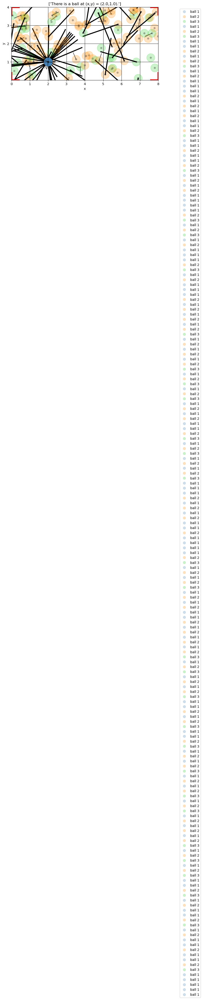

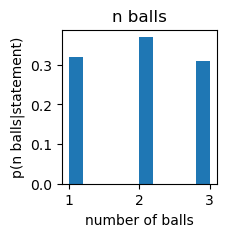

-7.491087593534876
-7.6246189861593985
-6.318367332713044
-7.249925536717988
-7.943072717277933
-7.049254841255835
-6.318367332713044
-6.318367332713044
-7.049254841255835
-7.049254841255835
-7.049254841255835
-6.318367332713044
-7.491087593534876
-6.318367332713044
-7.049254841255835
-6.318367332713044
-7.491087593534876
-6.972293800119707
-7.049254841255835
-6.318367332713044
-6.318367332713044
-6.318367332713044
-7.491087593534876
-7.491087593534876
-7.049254841255835
-6.318367332713044
-6.318367332713044
-7.6246189861593985
-7.049254841255835
-6.318367332713044
-6.318367332713044
-7.049254841255835
-6.972293800119707
-7.249925536717988
-7.391004134977892
-7.049254841255835
-6.972293800119707
-7.6246189861593985
-7.391004134977892
-7.391004134977892
-7.049254841255835
-6.972293800119707
-6.318367332713044
-7.491087593534876
-7.491087593534876
-6.972293800119707
-7.491087593534876
-6.318367332713044
-6.318367332713044
-7.049254841255835
-7.049254841255835
-7.049254841255835
-6.318367

PyObject Text(0.5, 1.0, 'n balls')

In [19]:
reference_statements = ["There is a ball at (x,y) = (2.0,1.0)."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 1, 100, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

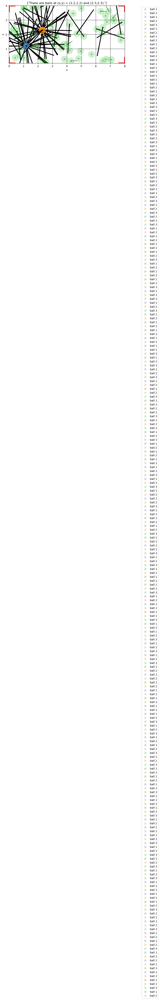

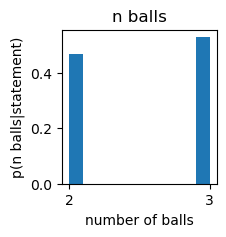

["There are balls at (x,y) = (1.2,1.2) and (2.3,2.3)."]
There are balls at (x,y) = (1.2,1.2) and (2.3,2.3).
----------------
-10.920455852163727
-11.262205145885783
-10.920455852163727
-10.920455852163727
-10.920455852163727
-11.262205145885783
-11.495819997067288
-10.920455852163727
-10.920455852163727
-10.920455852163727
-11.262205145885783
-11.262205145885783
-11.262205145885783
-11.262205145885783
-11.262205145885783
-11.495819997067288
-11.495819997067288
-11.495819997067288
-11.262205145885783
-11.262205145885783
-11.495819997067288
-10.920455852163727
-10.920455852163727
-10.920455852163727
-11.495819997067288
-10.920455852163727
-10.920455852163727
-11.495819997067288
-11.495819997067288
-11.495819997067288
-10.920455852163727
-10.920455852163727
-10.920455852163727
-10.920455852163727
-11.495819997067288
-11.495819997067288
-11.495819997067288
-10.920455852163727
-11.495819997067288
-10.920455852163727
-11.262205145885783
-11.262205145885783
-11.495819997067288
-10.92045585216

PyObject Text(0.5, 1.0, 'n balls')

In [20]:
reference_statements = ["There are balls at (x,y) = (1.2,1.2) and (2.3,2.3)."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 1, 100, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are balls at (x,y) = (1.2,1.2), (3.1,2.4), and (2.3,2.3)."]
There are balls at (x,y) = (1.2,1.2), (3.1,2.4), and (2.3,2.3).
----------------


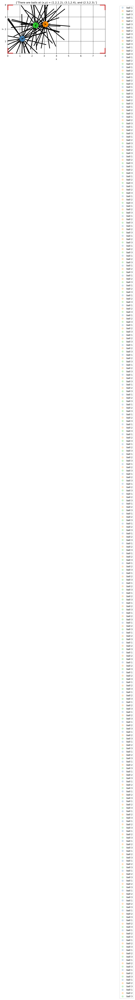

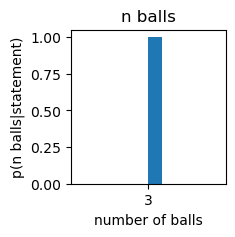

-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308042696
-15.65470308

PyObject Text(0.5, 1.0, 'n balls')

In [21]:
reference_statements = ["There are balls at (x,y) = (1.2,1.2), (3.1,2.4), and (2.3,2.3)."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 1, 100, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

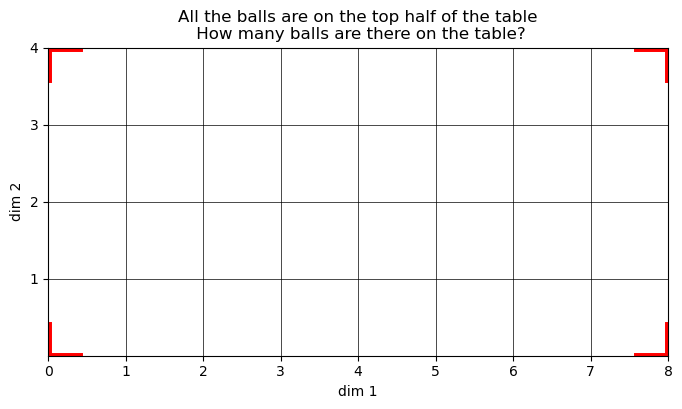

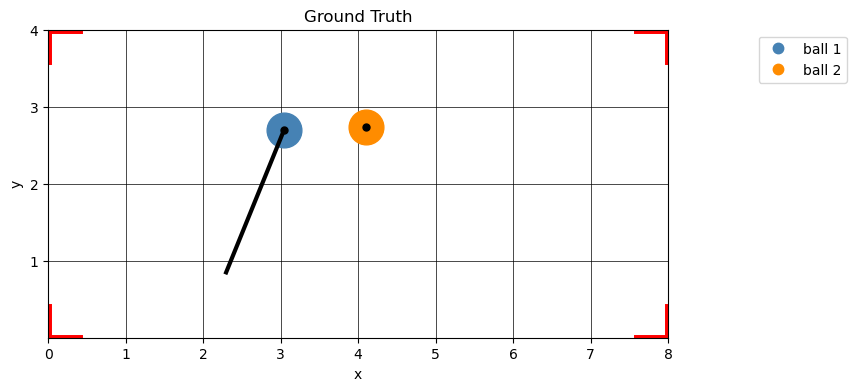

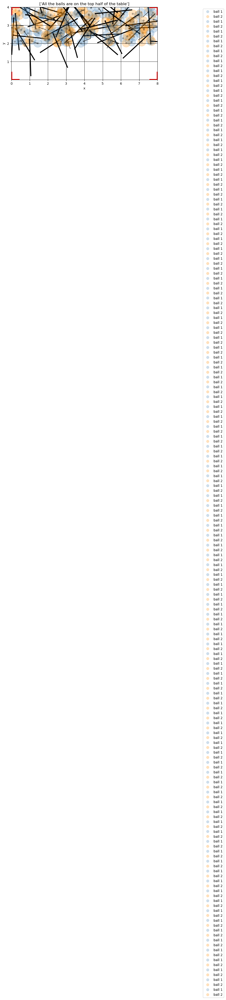

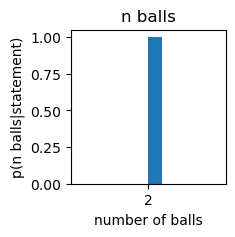

All the balls are on the top half of the table
----------------


PyObject Text(0.5, 1.0, 'n balls')

In [175]:
ret = present_world((8,4),1)
reference_statements = ret[1];
reference_trace = ret[2];
plot_pool_world(reference_trace,false);
title("Ground Truth");

traces = infer_worlds((8,4), 1, reference_statements, 1000, 100, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

### We really ought to test each statement individually to see how it is working out. The inference at the end won't change as we add more statements, but the speed will slow down, so we can anticipate which statements will be hard.

# Testing the specific position statements at different amounts of computation. 
Clearly, a heuristic was needed. 1,000,000 draws from heuristic-less g.m. needed to reliably converge for precision statements!

In [626]:
reference_statements = ["There is a ball at (x,y) = (2.0,1.0)"]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 1, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is a ball at (x,y) = (2.0,1.0)"]
There is a ball at (x,y) = (2.0,1.0)
----------------
Go on...
DynamicChoiceMap(Dict{Any,Any}((:statement, 1) => "There is a ball at (x,y) = (2.0,1.0)"), Dict{Any,Any}())
-Inf


LoadError: Did not converge!

In [608]:
reference_statements = ["There are 0 balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 0 balls on the table."]
There are 0 balls on the table.
----------------


LoadError: KeyError: key (:x, 3) not found

["There is fewer than 1 ball on the table."]
There is fewer than 1 ball on the table.
----------------
-3.8066624897703205
-3.757872325600889
-3.247046701834898
-3.4350989333378372

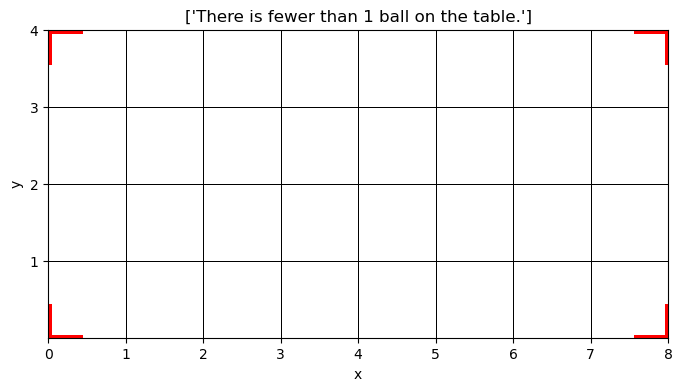

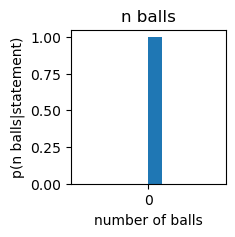


-3.7113523099659957
-3.757872325600889
-3.666900547395162
-3.7113523099659957
-3.583518938456111
-3.368407558839165


PyObject Text(0.5, 1.0, 'n balls')

In [212]:
reference_statements = ["There is fewer than 1 ball on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are fewer than 2 balls on the table."]
There are fewer than 2 balls on the table.
----------------
-2.875483145402415
-3.012539391870373
-2.9683332993658773
-2.865679145305794
-2.995732273553992
-3.1072847594597386
-2.925998935539317
-2.9737533668352163
-3.029633825229673
-2.890371757896165
-3.023903150520688
-3.035397529946423
-3.0182051294060503
-3.268708198616077
-2.8608129556546213
-3.1648086035979253
-3.239929234066034

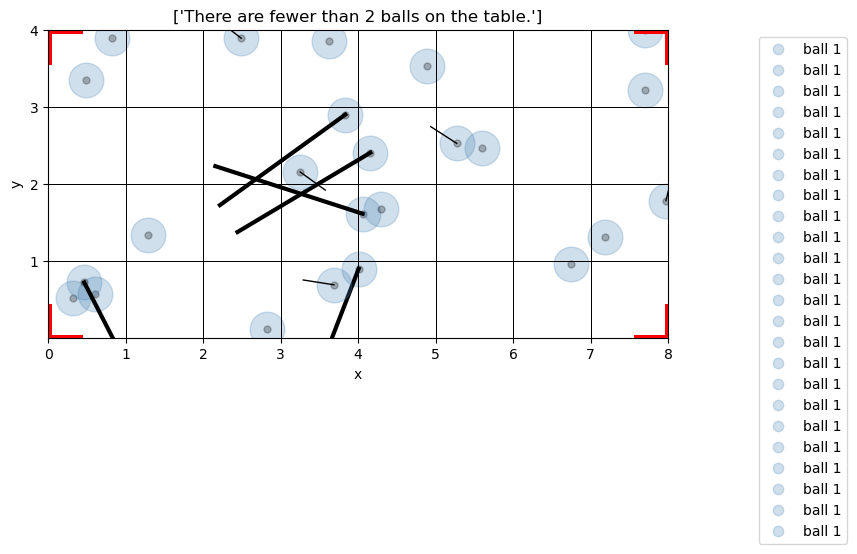

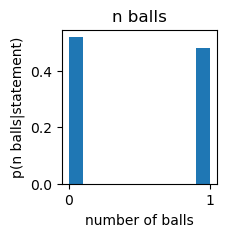


-2.9957322735539913
-2.9792029716027812
-2.957580507589615
-2.979202971602782
-3.11978492222397
-2.957580507589615
-3.11978492222397
-3.012539391870373
-2.9683332993658773
-3.0827436505436214
-3.001303318603447
-2.836830990968135
-3.0767013360876585
-3.1388331171946646
-3.0296338252296726
-3.2542151913135102
-2.8656791453057937
-2.846354872479391
-2.9846824373674066
-3.126094091417235
-3.1714092876292774
-2.9957322735539917
-3.2119553820236275
-3.0470255679415423
-2.962942450731001
-2.851151044742884
-3.023903150520688
-3.064725145040943
-2.9957322735539913
-3.0069055741521162
-2.995732273553992
-3.076701336087659
-2.8754831454024146


PyObject Text(0.5, 1.0, 'n balls')

In [217]:
reference_statements = ["There are fewer than 2 balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are fewer than 3 balls on the table."]
There are fewer than 3 balls on the table.
----------------
-2.933100225227406
-2.8047552229784003
-2.7511521530026357
-2.9218199052767693
-2.9119424406503396
-2.7662164560808185
-2.9571011830593013
-2.802255951225783
-2.888921351358502
-2.7789648371576527
-2.8236764131820493
-2.7624338754905287
-2.7959957012517127
-2.948515022277926
-2.8653802100254704
-2.897525133850455
-2.8878737311393445
-2.7616505896130534
-2.868725509431317
-2.851571455486284
-2.8258378786791827
-2.850999386516309
-2.867670473474342
-2.750059780372838
-2.9963305465989603
-2.9090822284969997
-2.842866744049293
-2.865814238858284
-3.0066421450788714
-2.899432666542255
-2.8480964750835094
-2.963188528370688
-2.852170403805423
-2.823882885289196
-2.86156143515816
-2.9400948770266657
-2.9450821174612347

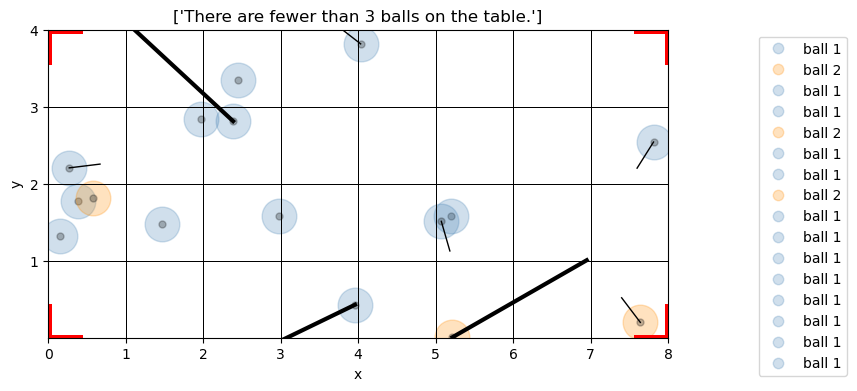

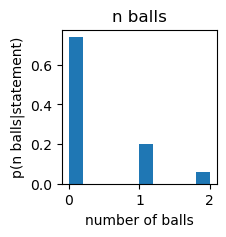


-2.9716075141339515
-2.872079953883383
-2.840819642495487
-2.846572005015794
-2.7256932874390287
-2.9065248618300425
-2.787261198548481
-2.848049012082604
-2.9132500491934894
-3.0457203255500973
-2.844770707906326
-2.988246071088904
-3.02669618471127


PyObject Text(0.5, 1.0, 'n balls')

In [221]:
reference_statements = ["There are fewer than 3 balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is no more than 1 ball on the table."]
There is no more than 1 ball on the table.
----------------
-3.2603212330435936
-3.185259214069216
-3.0199549111298376
-2.997443137957621
-3.1811354968853545
-2.8980938039900757
-3.00087367305441
-3.1154402376199593
-2.988917937134261
-3.050179434038564
-3.1212373553042854
-3.1001435722444857
-3.0907006314442045
-3.042985158404537
-2.973753366835216
-3.2603212330435936
-3.1811354968853545
-3.0501794340385637
-3.1001435722444857
-3.0199549111298376
-3.119301246277419
-3.0376232152631513
-3.1708999929913277
-3.0483760070394137
-2.948979184849637
-3.0147147244662813
-2.9248039543176487
-3.059245679276317

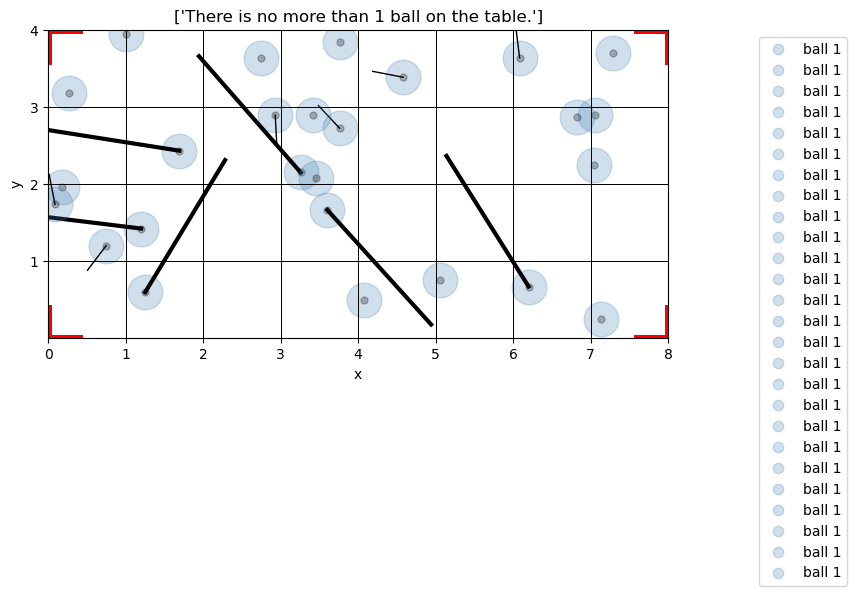

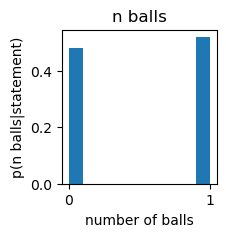


-3.068394873929906
-3.0794855606240636
-2.921624301400269
-3.0008736730544103
-2.910574465213685
-3.1039458581942245
-3.051986119263513
-3.218875824868201
-3.0963556889275488
-3.0252227020646973
-3.236117631302707
-3.136862673207366
-2.9279937496857498
-3.0794855606240636
-2.968749186250641
-3.041194647630749
-3.1135153092103742
-3.0112364600899566
-3.187327467133275
-2.940855663328157
-3.1001435722444857
-2.994024331208835


PyObject Text(0.5, 1.0, 'n balls')

In [222]:
reference_statements = ["There is no more than 1 ball on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are no more than 2 balls on the table."]
There are no more than 2 balls on the table.
----------------
-2.8446024459605983
-2.885833178065403
-2.826635946111465
-2.9031275695044716
-2.9018803455255435
-2.8024528647366935
-2.882698356119424
-2.938445149830483
-2.941483022223686
-2.9359841648175653
-2.8928292401087057
-2.8468177956826066
-2.9127674525101335
-2.9253788321719405
-2.8486078622764697
-3.019248193906429
-2.8430542787909907
-2.828615618584225
-2.8968934198655423
-2.897000220579073
-2.8365650200810775
-2.7986355158838703
-2.8605537462076454
-2.9142210126848704
-2.8492097893433916
-2.818034811210724
-2.700344627972653
-2.753066681143261
-2.9401417122480984
-3.0127086479523304
-2.851160566654502
-2.915768101690059
-2.846865200280861
-2.788387332701702

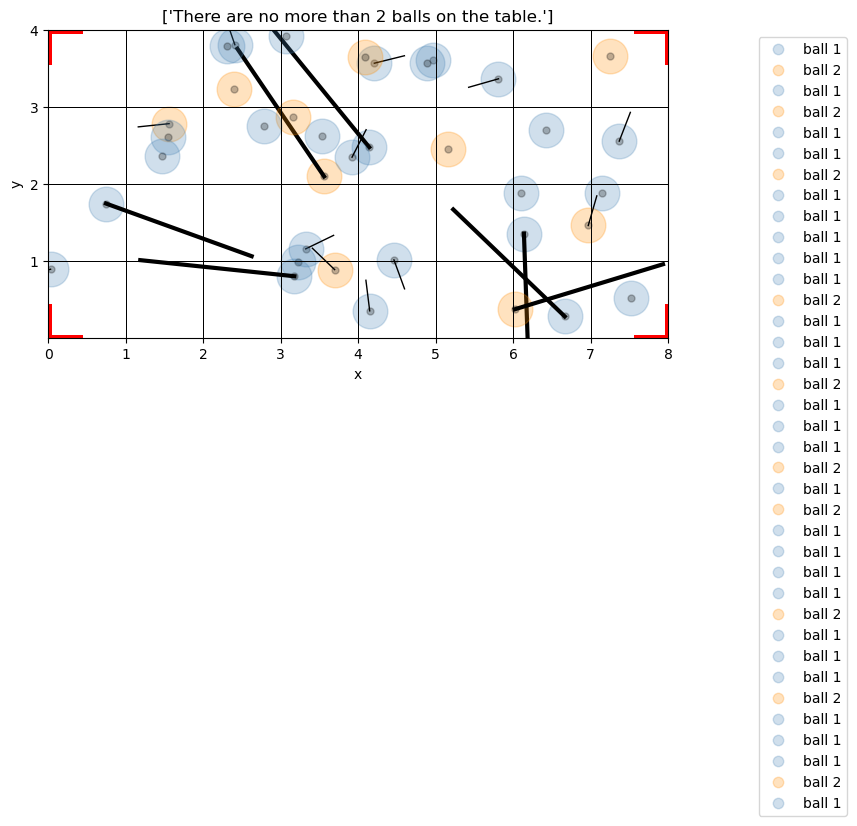

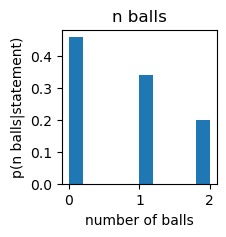


-2.9047408130755032
-2.810537029408483
-2.90574017778677
-3.052843671283841
-2.974604072641553
-2.7860713264755557
-2.7920695150938526
-2.752712204672008
-3.024273662501529
-2.901060688591174
-2.8643569514924083
-2.8885506055301775
-2.8127219537824937
-2.9587123222877576
-2.942865642404474
-2.923549890702368


PyObject Text(0.5, 1.0, 'n balls')

In [223]:
reference_statements = ["There are no more than 2 balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are no more than 3 balls on the table."]
There are no more than 3 balls on the table.
----------------
-2.826389103220631
-2.742068726092282
-2.6349853352236314
-2.802427192429298
-2.756455080086438
-2.6431417696578463
-2.742053298538346
-2.778725115862433
-2.8004471246342098
-2.7107359335686665
-2.6411111904094637
-2.8120331177060374
-2.670177182980953
-2.753643044623968
-2.699323454281364
-2.8024751096881877
-2.7818632862189245
-2.715438788493553
-2.715175133618696
-2.777226510004546
-2.726070570981631
-2.736271101069514
-2.802476200984426
-2.6895522125389855
-2.6884185838597014
-2.7738644446005423
-2.6261789001219267
-2.8264617791417086
-2.814457929084944
-2.7604683557677614
-2.718189774299317
-2.769131724828437
-2.70967852718203
-2.7892080617148265

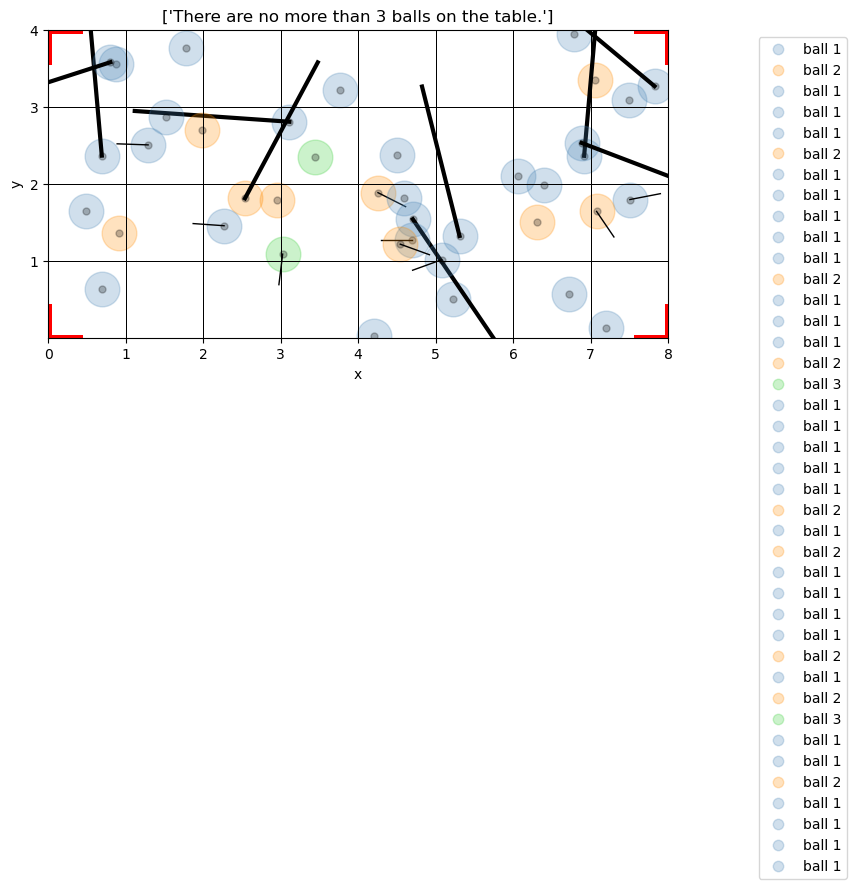

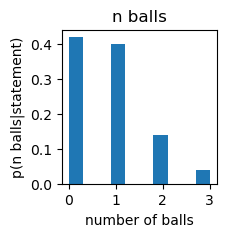


-2.687767260729201
-2.777631402446917
-2.8510577478422685
-2.7034622416847327
-2.7570219478754465
-2.828339669428394
-2.8746328771167535
-2.8471226796824904
-2.8420466192357328
-2.735440849682923
-2.749306664513087
-2.775365084103922
-2.790465597946728
-2.7853548055187574
-2.863426266502896
-2.8119174697507345


PyObject Text(0.5, 1.0, 'n balls')

In [224]:
reference_statements = ["There are no more than 3 balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are not many balls on the table."]
There are not many balls on the table.
----------------
-2.982149721788123
-3.1290194957463404
-3.0720781193462017
-3.077628549876851
-2.9473491926387054
-3.0394073370566534
-2.9457218529793305
-2.9506118382735225
-2.9889179371342616
-3.050179434038564
-2.9408556633281573
-3.107762656720925
-3.204029316751207
-3.085077373889842
-3.1290194957463395
-3.0147147244662813
-3.113515309210375
-3.059245679276317
-3.072078119346202
-3.1708999929913273
-3.0234636866595173
-3.0982478370795863
-3.0982478370795867
-3.0610688338378327
-2.9923193009577513

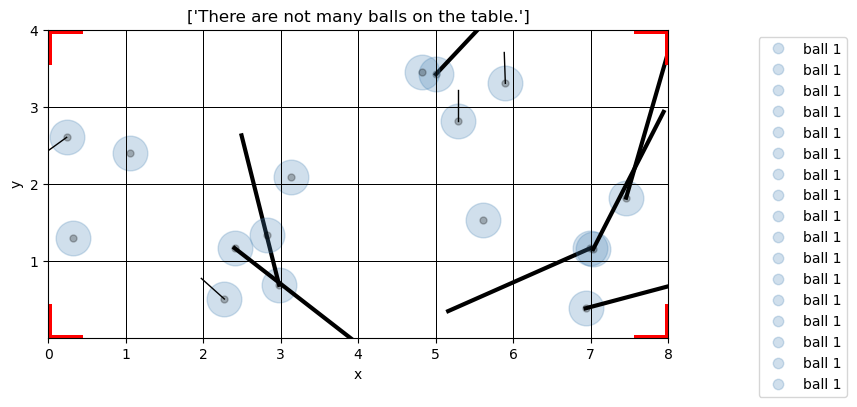

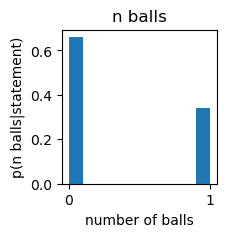


-3.081346026276983
-3.1708999929913277
-3.146753950686109
-3.041194647630749
-3.048376007039414
-2.9838374859018417
-3.0556093116329324
-3.1290194957463404
-3.0720781193462017
-3.041194647630749
-3.057425842559331
-2.810565764627806
-3.1231772201221117
-3.059245679276317
-3.0394073370566534
-3.068394873929905
-3.083209959715046
-3.0776285498768505
-3.041194647630748
-3.1231772201221126
-3.032289869287789
-3.2253067151984918
-2.910574465213685
-3.044778880858564
-3.1388331171946646


PyObject Text(0.5, 1.0, 'n balls')

In [225]:
reference_statements = ["There are not many balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There could be some balls on the table."]
There could be some balls on the table.
----------------
-2.880410425424978
-2.7446550403931766
-2.4847379730565557
-2.581398634261133
-2.583490558468271
-2.8347996271364098
-3.0557949934942723
-2.789645038632252
-2.6903206708203484
-2.5493791961938697
-2.861109109457579
-2.8347996271364098
-2.759132586773714
-2.6276551211787793
-2.870715812711382
-2.4687074835184717
-2.718971014069144
-2.737055058266617
-2.99124095016226
-2.6295076318806228
-2.7896235107664995
-2.603049423363826
-3.011141629170991
-2.771479336725513
-3.0585192236946135
-2.6656158576070546
-2.798071471116506
-2.6662720205169474
-3.131793069159536
-2.6928449056824375
-2.5266216992834556
-3.367444145409283
-2.982130559009902
-2.889432060741306
-2.7182796668139844
-3.1750692775707274
-2.816704244999691
-2.8238038173907034
-2.835161668649712
-2.654334435343784
-2.670355702826468
-2.711015938769157
-2.580067268127626
-2.7459118093970285
-2.727079072494078
-2.7397217036095873
-2.77

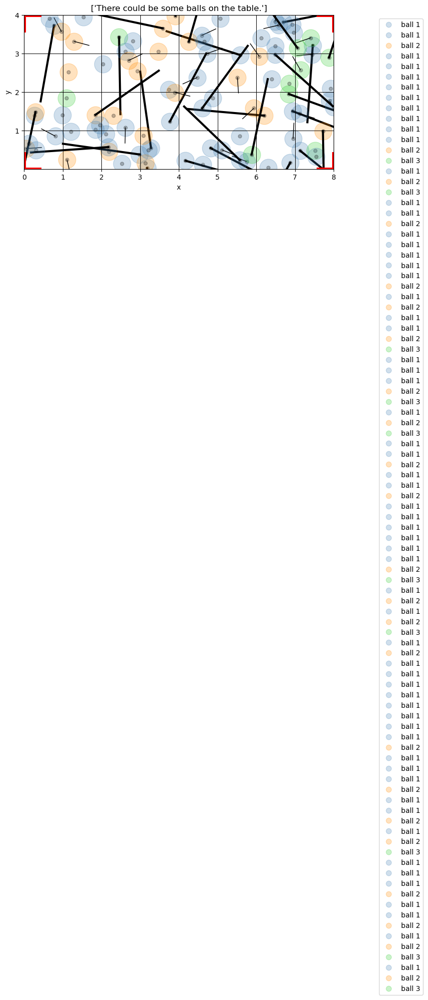

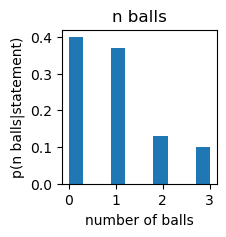

-2.747488147539827
-2.7070385672273662
-2.5697226362141947
-2.729218470314527
-2.479677587950063
-2.552885961454637
-2.577511854361667
-3.0307393707094414
-2.660675364450744
-2.8068487939973585
-3.0364462151418357
-2.8330795929991064
-2.6197992923796427
-2.9561672815235025
-3.042132185379269
-2.476417972248776
-2.6570774709103846
-3.115711984204491
-2.714814274472064
-2.7170326280354593
-3.0463121624823035
-2.6596916116822538
-2.6290717731878344
-2.966294357380529
-2.52062473239008
-2.7040135518129307
-2.8195468437908775
-2.5850575870048824
-2.9831093387415337
-2.9680697285769457
-2.971950732743351
-2.98083204405621
-2.627953513778989
-2.6273213976335836
-3.0594922794904997
-3.0621705051604584
  0.094822 seconds (283.04 k allocations: 20.080 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [27]:
reference_statements = ["There could be some balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 10, 100, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is 1 ball on the table."]
There is 1 ball on the table.
----------------
-4.034625327520479
-4.034625327520479
-4.225680564283189
-3.7361323389644823
-4.034625327520479
-3.8742826774452994
-3.9120230054281464
-3.951243718581428
-4.336906199393413
-3.8742826774452994
-3.951243718581428
-3.951243718581428
-3.951243718581428
-3.8742826774452994
-3.6736119819831483
-3.8742826774452994
-3.9920657131016832
-4.1255971057262055
-3.8742826774452994
-3.7361323389644823
-3.8028237134631544
-4.2797477855534645
-3.8742826774452994
-3.643759018833467
-3.768922161787473
-4.605170185988092
-4.1255971057262055
-4.2797477855534645
-4.034625327520479
-3.9920657131016832
-4.034625327520479
-3.951243718581428
-3.768922161787473
-3.8742826774452994
-4.1255971057262055
-3.8742826774452994
-4.079077090091313
-3.8379150332744247
-4.1255971057262055
-4.034625327520479
-4.336906199393413
-3.951243718581428
-4.1255971057262055
-3.8742826774452994
-3.9920657131016832
-4.1255971057262055


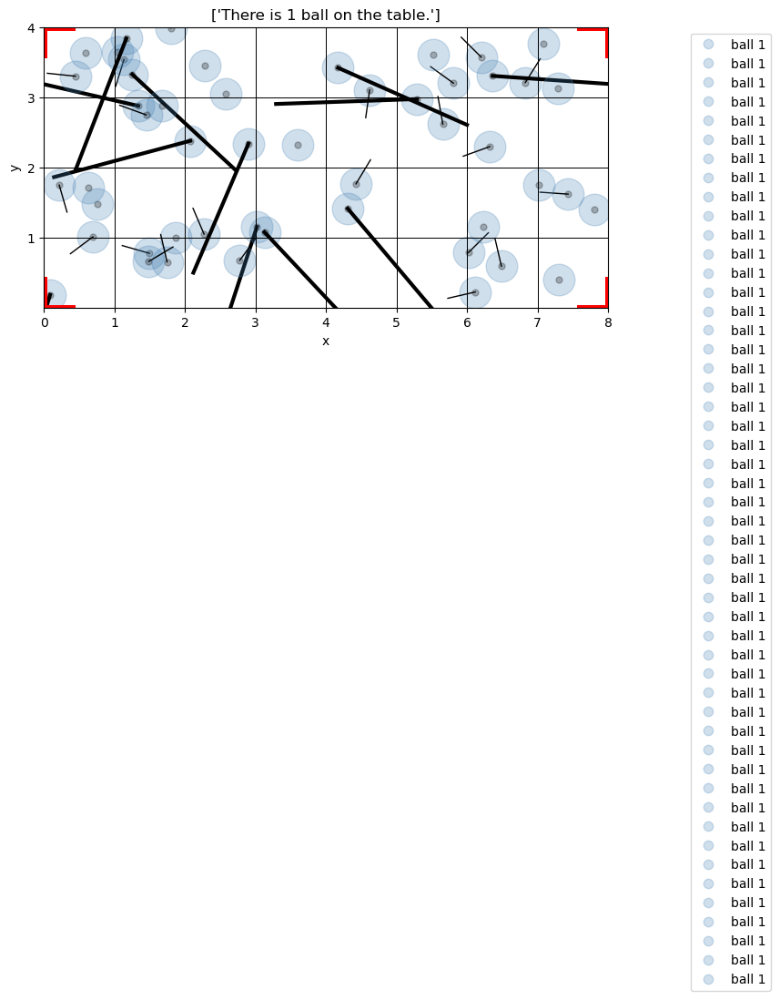

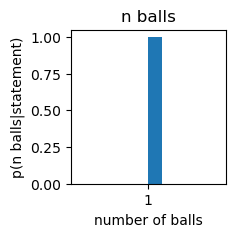

-4.2797477855534645
-3.951243718581428
-3.8028237134631544
-4.225680564283189


PyObject Text(0.5, 1.0, 'n balls')

In [227]:
reference_statements = ["There is 1 ball on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is at least 1 ball on the table."]
There is at least 1 ball on the table.
----------------
-3.343609271950565
-3.4540382543202295
-3.4160598341474486
-3.3628290381158967
-3.3632754929409523
-3.363555476763487
-3.2848188398723104
-3.4102063990337643
-3.40804237044412
-3.3850153221853434
-3.3760939896179814
-3.367519214529356
-3.316682946050803
-3.2848598235165483
-3.281747658391589
-3.3049474718400065

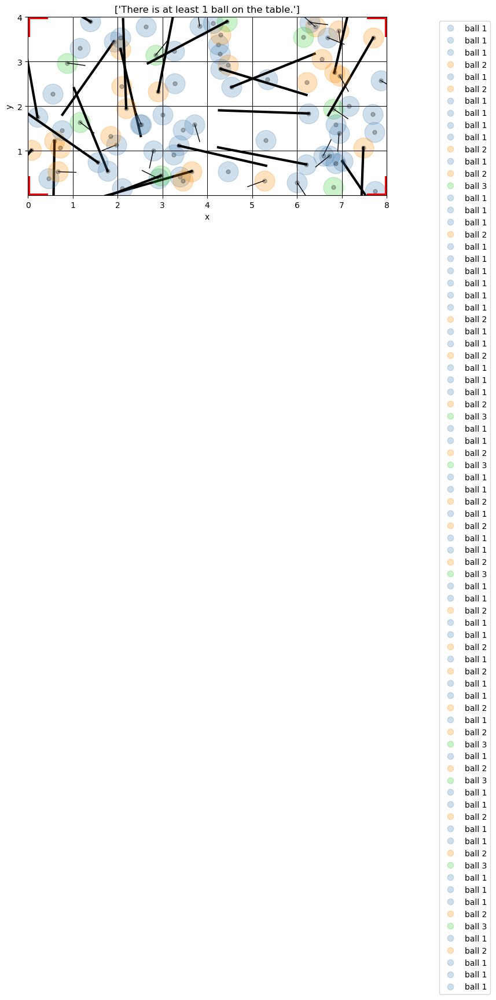

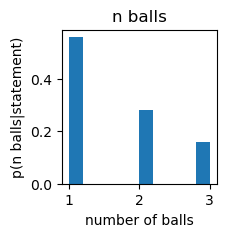


-3.2895770247149514
-3.2951877125247324
-3.2682348890945394
-3.3658236896779368
-3.2331501463901136
-3.3032377823993766
-3.2821018721901094
-3.348520032854776
-3.3409998684972377
-3.41753139149969
-3.3572998177443756
-3.404026071049799
-3.342927174889469
-3.2667095438155345
-3.3797858539730807
-3.338309723868308
-3.4257807251912595
-3.327271191604031
-3.312525985323986
-3.402448918402678
-3.4440930232924245
-3.346426703105797
-3.270687931048582
-3.44674030769999
-3.3525776543282397
-3.620001253337379
-3.4059562771687846
-3.2572583808103843
-3.282251218476028
-3.368893712040606
-3.402698143762959
-3.2850645082591563
-3.2990788018672212
-3.3280632933386363


PyObject Text(0.5, 1.0, 'n balls')

In [228]:
reference_statements = ["There is at least 1 ball on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 2 balls on the table."]
There are 2 balls on the table.
----------------
-5.042636156199969
-4.55393819616162
-4.471702652362921
-4.538717788668237
-4.405796046469926
-4.589759529712574
-4.86393429766575
-5.183256921249383
-4.948326267930876
-4.793548361299443
-4.706989370655461
-5.041371033867871
-4.655563166548763
-4.70982143145518
-4.77231251325345
-4.607983846880011
-4.55471504607445
-4.44667210065288
-4.985662373164876
-4.738650494349111
-4.823917285606453
-4.559584078967735
-4.548710185415722
-4.993164283816671
-4.956132595971951
-4.478790744485598
-4.852813201241839
-4.658253075637872
-4.79923862900355
-4.871639928991293
-4.456265866055729
-4.6841194091454605
-4.439114733203724
-4.748388926351373
-4.694399276295389
-4.511975326769368
-5.159322001443074


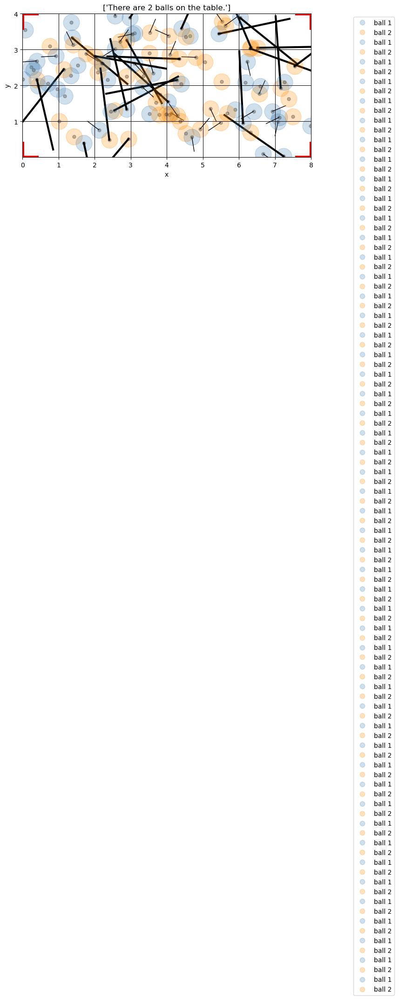

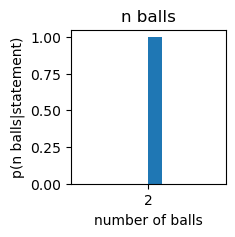

-4.785929744945281
-5.281348490348798
-4.643175801145859
-4.3571135062624755
-4.758699517810697
-4.7032632894518125
-4.573988378849583
-4.688829472434271
-4.725485159928854
-4.782386025222867
-4.744975552039122
-4.936445223506463
-4.739117647642278


PyObject Text(0.5, 1.0, 'n balls')

In [229]:
reference_statements = ["There are 2 balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are at least 2 balls on the table."]
There are at least 2 balls on the table.
----------------
-4.118688730487634
-3.9739018154621566
-4.110179903740242
-4.321933506394663
-4.240707515879872
-4.118617224771411
-4.277281929654223
-4.0437377206411105
-4.091249462176589
-4.250609610572765
-4.014868016501008
-4.078688054918866
-4.184581154519568
-4.209719520814773
-4.030551334974698
-4.258347743383632
-4.229746638013379
-4.2165173691823465
-4.207531368482069
-4.144688378687633
-4.342810847581217
-4.289245343301702
-4.22383912095585
-4.047705688539501
-4.0657329695211715
-4.116953114237843
-4.187874601589552
-4.238718721414001

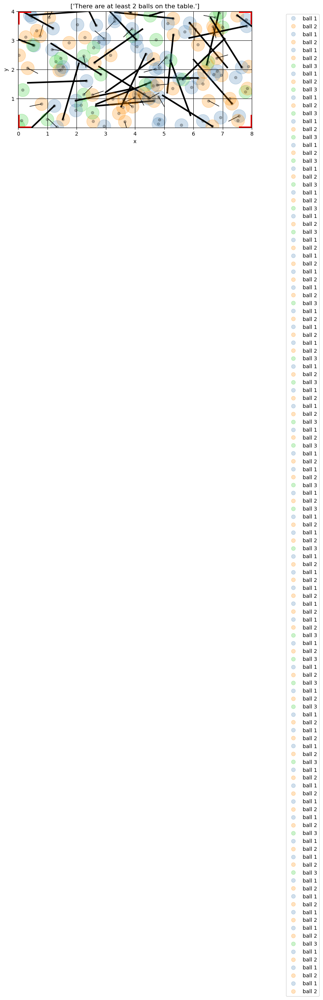

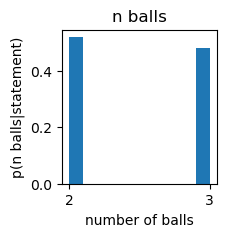


-4.125109381382152
-4.013384088895253
-4.173533605659551
-4.144720492791321
-4.201914691179418
-4.066357288599769
-4.184561435197103
-4.094922390278302
-4.374548141950264
-4.320631712178869
-4.0510607460722365
-4.073296861107973
-4.158853228905048
-4.048834001009173
-4.251980030610898
-4.054193929196103
-4.157538627666459
-4.103862444342831
-4.10223479426004
-4.19041514616642
-4.067728757053725
-4.093067885872545


PyObject Text(0.5, 1.0, 'n balls')

In [230]:
reference_statements = ["There are at least 2 balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are some balls on the table."]
There are some balls on the table.
----------------
-4.079656667649614
-4.187431707260019
-4.1178796099539134
-4.244784662309669
-4.133355966063409
-4.161056077848057
-4.060824491024358
-4.223984456766637
-4.18399777375245
-4.278910476090745
-4.089554073303777
-4.227791260824065
-4.14319606474528
-4.032384220509128
-4.152790275759573
-4.316760674527765
-4.0284182110540865
-4.284072942702984
-4.127753381232278
-4.264550332253525
-3.94297903016726
-4.264289476153626
-4.101662597838019
-4.163841651881452
-4.088475963000889
-4.064166164913484
-4.075067879255578
-4.213025619559748
-4.0027505200437785
-4.13751274606752

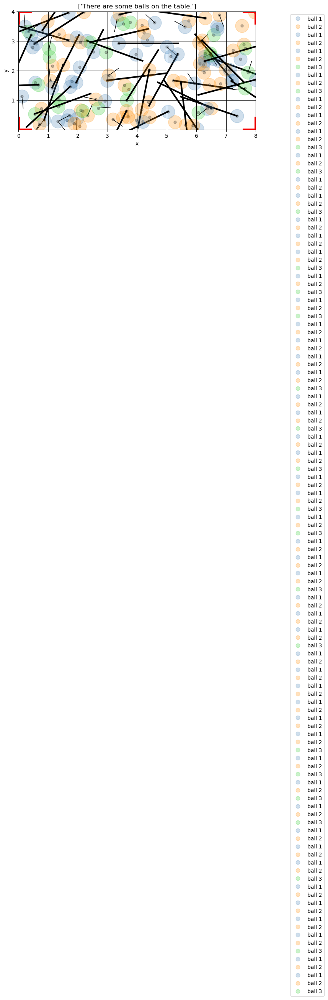

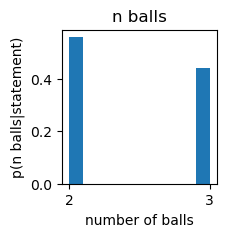


-4.209196436608644
-4.13646214548662
-3.9881671634502776
-4.106729756434711
-3.928229015655486
-4.354142498095746
-4.211750866231448
-4.2117485188085215
-4.134031815192667
-4.038802694756789
-4.189001023230218
-4.231749083736079
-4.268618712000504
-4.188009823240721
-4.283570078407631
-4.067387323671613
-4.082778526159837
-4.131609125105631
-4.202583512554596
-4.343499721821604


PyObject Text(0.5, 1.0, 'n balls')

In [231]:
reference_statements = ["There are some balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are no more than 2 balls on the table."]
There are no more than 2 balls on the table.
----------------
-3.0011328210593944
-2.7326739094941765
-2.9094008277011785
-2.868007963890534
-2.7373172451430348
-2.961744115942102
-2.8355513929748684
-2.763144278124426
-2.996045123350911
-3.0994580780077134
-2.8729394415996583
-2.8247628549145256
-2.8396961254868747
-2.8862346159225805
-2.765267284161995
-2.929073249546425
-2.7858005191526716
-2.7657817234345448
-2.8982948399676376
-2.8659157004225566
-2.8901525069555127
-2.919474451969265
-2.9645900809659116
-2.7846327462377305
-2.8545158778486046
-2.8883649311876143
-2.8437635860314012
-2.9276985415288115
-2.804330022681558
-2.894830844899431
-2.825662826876
-2.8198399591701255
-2.743616603222181

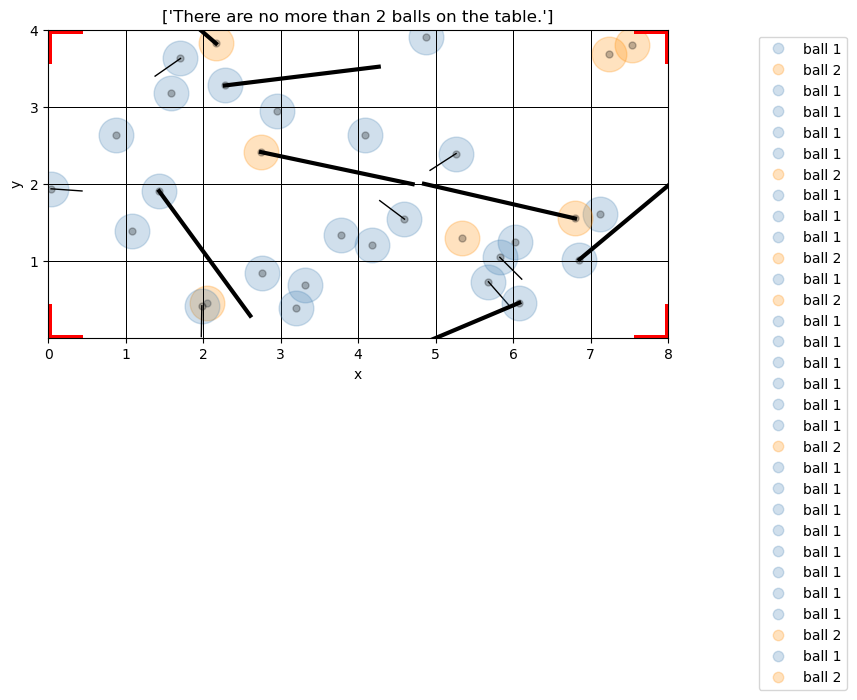

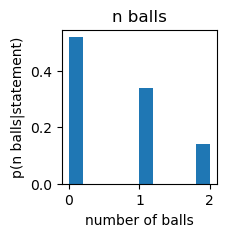


-2.9043160984063467
-2.7842910772162472
-2.8339830674694766
-2.9031569431193023
-2.780681742122743
-2.954870763162568
-3.0123034403498234
-2.8136681425624013
-2.8213717187367005
-2.8635165116862797
-2.9312755417911425
-2.920328297934009
-2.7420974995489296
-2.883602853103834
-2.7834568011407663
-2.903487993260657
-2.766772014601698


PyObject Text(0.5, 1.0, 'n balls')

In [232]:
reference_statements = ["There are no more than 2 balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are no more than 3 balls on the table."]
There are no more than 3 balls on the table.
----------------
-2.7903681792231643
-2.6745687777486413
-2.8023762591309236
-2.8339646862588523
-2.673837095370038
-2.69901714455992
-2.8370190978965186
-2.645434141263636
-2.799120589541057
-2.7165669580373453
-2.8093010615395264

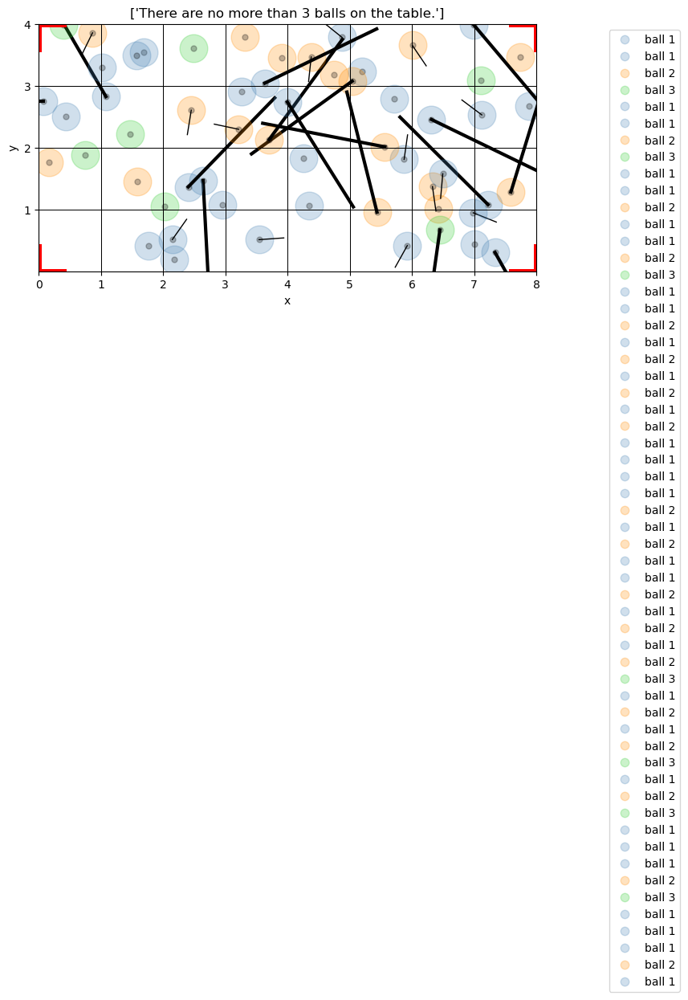

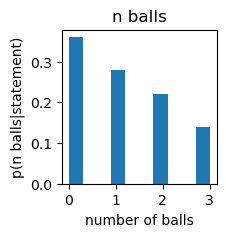


-2.767550756088765
-2.836055267286528
-2.7777240061891044
-2.73789350954202
-2.678748414301059
-2.6565655630367013
-2.755396157708695
-2.823919088971786
-2.822608480924583
-2.7706443599034927
-2.8714968170764354
-2.675949296378193
-2.791805179425683
-2.713997483835963
-2.8442429653550416
-2.823140121659549
-2.828331520532182
-2.7905063379396786
-2.736062741689256
-2.8013162579102193
-2.7596086115039276
-2.7144689286850188
-2.6864102573187916
-2.7749278279830563
-2.6522435218549756
-2.888560147818414
-2.906380021201804
-2.74123727624585
-2.8471471769174297
-2.763507412263815
-2.8536678068412087
-2.8035502820593052
-2.6979976408227206
-2.686926213775888
-2.728036816846055
-2.6894434690105062
-2.831234097637985
-2.63860151445178
-2.7151844846037525


PyObject Text(0.5, 1.0, 'n balls')

In [233]:
reference_statements = ["There are no more than 3 balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the table."]
There are 3 balls on the table.
----------------
-5.32135452228305
-5.295419719567297
-5.061486970057398
-5.4260214304997145
-4.957293423798259
-5.322330267093992
-5.376209708920385
-4.93143438937561
-5.1923823360123915
-4.926851916659339
-5.06903621662365
-4.909722064064747
-5.2379571927147195
-5.347770623914894
-5.218620489539119
-5.108779143558861
-5.046524152950531
-5.142883218907471
-5.18066710404891
-4.900381719214952
-4.900591947791523


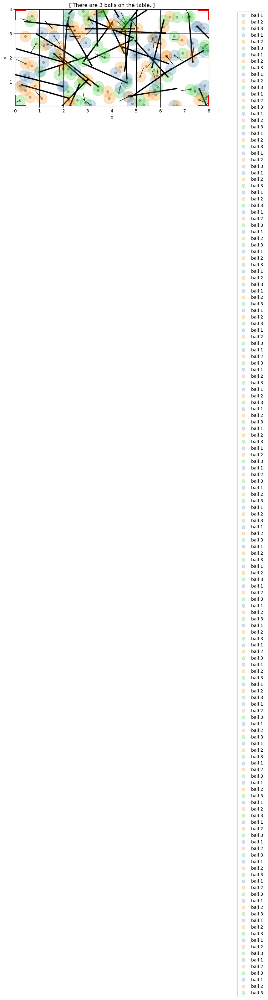

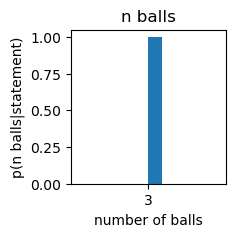

-4.669727673640281
-5.178557465252576
-5.168662610669448
-5.293690816706257
-4.796000098134556
-4.886132355641287
-5.001833461338323
-5.017887702893657
-5.286636213263044
-4.953779794788414
-4.955312965018434
-4.913113027651388
-5.091592359923876
-5.111560425919321
-5.32378837589393
-4.9103588039780135
-5.092749847841611
-5.258782117025604
-5.040977190927557
-5.0612849385173435
-5.435570367911149
-4.909895680199909
-4.908902617097361
-4.964317193323008
-5.135337661289154
-5.241028567657143
-5.048738282208092
-4.95057982425876
-4.796034529839273


PyObject Text(0.5, 1.0, 'n balls')

In [234]:
reference_statements = ["There are 3 balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are at least 3 balls on the table."]
There are at least 3 balls on the table.
----------------
-5.185967111383578
-4.914904925847395
-5.162620823111299
-4.911507890870159
-4.92503850179721
-5.124662943394091
-5.143285140830415
-4.9998789841725095
-4.863961183578546
-5.003950715628013
-5.332626123306162
-5.120070006045224
-4.723231532061972
-4.899426691398808
-5.099361576620143
-5.095881773982752
-4.878419222029949
-5.071300812908278
-4.955797612800055
-4.868300746830618
-5.221250962436361
-5.004851907913306
-4.969760953862135
-5.379798994224268
-4.990738536848379
-5.303951987924869
-5.142651882573852
-5.1774854037018585
-5.045949281451641
-5.119724897362316
-4.938059942666297
-5.042848469556539
-4.878727729836242
-4.8115716697029045
-5.183808215899116
-5.480525131807958
-5.113923515575727
-5.17288231679364
-4.927470209308105
-5.040812246101226
-5.141666259209015
-5.099198372217925

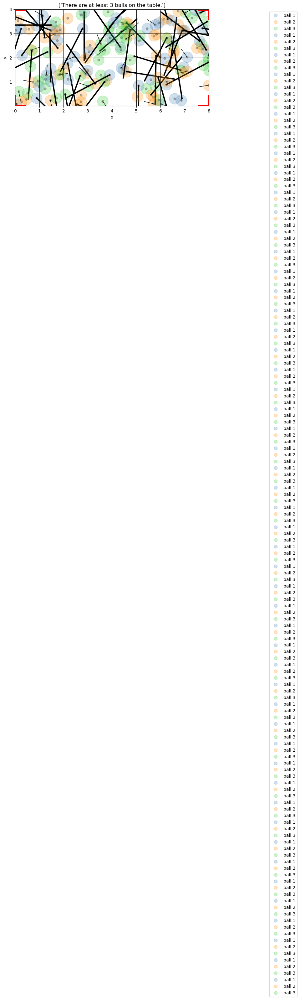

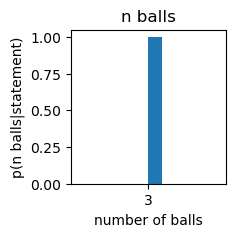


-5.343802897464416
-5.127896595324954
-5.267723317514744
-4.897519367653288
-5.036752195753854
-4.98846120264224
-4.851090733865736
-4.886405562955521


PyObject Text(0.5, 1.0, 'n balls')

In [235]:
reference_statements = ["There are at least 3 balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are a lot of balls on the table."]
There are a lot of balls on the table.
----------------
-4.984202037028101
-4.991090698023285
-4.726023120352844
-4.991090698023286
-5.295814236329918
-4.752400422970776
-5.480638923341992
-5.940171252720432
-4.787491742782047
-4.217192092538311
-5.247024072160486
-5.295814236329918
-4.948243106640657
-4.841558964052322
-5.247024072160486
-6.040254711277415
-4.718498871295095
-5.357024967374815
-4.948243106640657
-4.913532463677411
-5.485435095605484
-6.1737861039019375
-5.627242397533867
-5.940171252720432
-4.913532463677411
-4.991090698023285
-5.247024072160486
-4.841558964052322
-4.991090698023286
-4.991090698023286
-5.480638923341992
-4.994027557696596
-4.658906774092849
-4.841558964052322
-5.41164605185504
-5.0751738152338275
-4.690815442546678
-Inf
-4.873819826270544
-5.940171252720432
-4.723775928395939
-4.3933689112778165
-5.41164605185504
-4.873819826270544
-4.723775928395939
-5.078368706130346
-5.41164605185504
-5.028653799598935
-4.

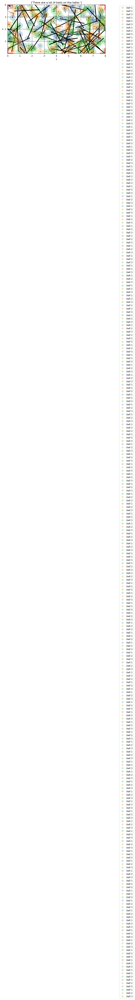

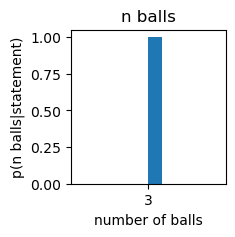

-4.690815442546678
-4.6589067740928485
-5.627242397533867
-5.480638923341992
-5.357024967374815
-6.1737861039019375
-6.1737861039019375
-4.577974443179602
-4.948243106640657
-5.357024967374815
-Inf
-6.040254711277415
-5.940171252720432
-6.1737861039019375
-4.6638777868148695
-4.948243106640657
-4.948243106640657
-5.295814236329918
-4.984202037028101
-4.991090698023286
-6.040254711277415
-5.799092654460526
-4.464264732910854
-5.357024967374815
-6.1737861039019375
-5.295814236329918
-5.295814236329918
-6.1737861039019375
-5.347107530717469
-4.873819826270544
-5.170483995038152
-5.357024967374815
-5.295814236329918
-5.0751738152338275
-5.357024967374815
-4.913532463677411
-4.718498871295095
-4.723775928395939
-5.357024967374815
  0.162628 seconds (287.07 k allocations: 20.424 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [28]:
reference_statements = ["There are a lot of balls on the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 10, 100, verbose=true);
ns = get_infered_n_balls(traces)

render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

# HUMAN COMPARISON:
30/38 subjects said "There are a lot of balls on the table." could be 2 or 3 balls, and only 8 said it could only be 3 balls

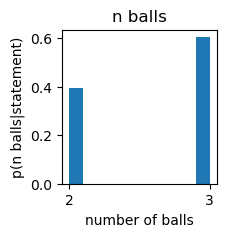

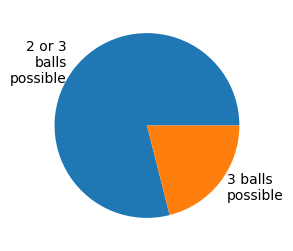

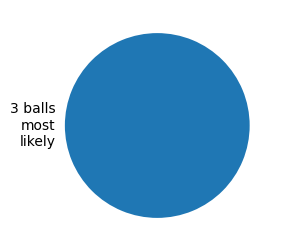

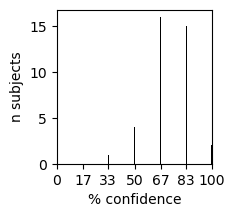

[2.0 2.0 2.0 2.0 2.0 2.0 2.0 2.0 2.0 2.0 2.0 2.0 2.0 2.0 2.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0 3.0]


7-element Array{PyCall.PyObject,1}:
 PyObject <matplotlib.axis.XTick object at 0x2161e18e0>
 PyObject <matplotlib.axis.XTick object at 0x2161e18b0>
 PyObject <matplotlib.axis.XTick object at 0x2161d8e20>
 PyObject <matplotlib.axis.XTick object at 0x216213d30>
 PyObject <matplotlib.axis.XTick object at 0x216221280>
 PyObject <matplotlib.axis.XTick object at 0x216221790>
 PyObject <matplotlib.axis.XTick object at 0x216221ca0>

In [64]:
s1 = 2 * ones(1,(15))
s2 = 3 * ones(1, (15+8))
s3 = hcat(s1,s2)

println(s3)
render_distribution(s3', "number of balls"; t="n balls", condition="statement", ax=nothing)

figure(figsize=(3,3))
pie([30,8], labels=["2 or 3\nballs\npossible", "3 balls\npossible"])

figure(figsize=(3,3))
pie([38], labels=["3 balls\nmost\nlikely"])

figure(figsize=(2,2))
ax = gca()
bar([33.3,50,66.67,83.33,100],[1,4,16,15,2], color="black", linewidth=50)
ax.set_xlabel("% confidence")
ax.set_ylabel("n subjects")
ax.set_xlim([0,100])
ax.set_xticks([0,17, 33,50,67,83, 100])

["There are 3 balls in the top right quadrant of the table."]
There are 3 balls in the top right quadrant of the table.
----------------


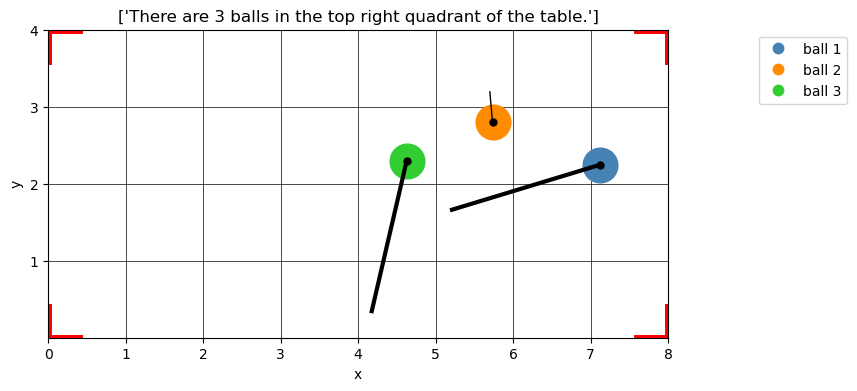

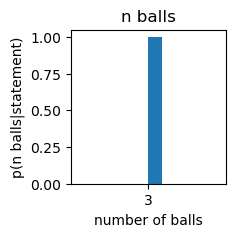

-10.404262840448617
  0.659331 seconds (272.87 k allocations: 19.479 MiB, 42.31% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [69]:
reference_statements = ["There are 3 balls in the top right quadrant of the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 1000, 1, verbose=true);
ns = get_infered_n_balls(traces)

render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

# verifying positional statements

["There is a ball on the left half of the table."]
There is a ball on the left half of the table.
----------------
-3.517578487002301
-3.457673926688403
-3.569658877120844
-3.5499703503060482
-3.610949874727077
-3.4518342390285235
-3.5413644464106295
-3.387745948023303
-3.4571346160191223
-3.347283162342108
-3.6947988166093504
-3.4054279936299827
-3.5588473943394567
-3.5452855068411977
-3.474233876781062
-3.4813050865701305
-3.5545361714657187
-3.5545420133286125
-3.3655455124555136
-3.486231313020251
-3.5901486206269686
-3.680666178572889
-3.486963490489685
-3.467049068859987
-3.791139807030192
-3.765964029561898
-3.4858344371970977
-3.5177225032389177
-3.3749720475392078
-3.480732056886982
-3.5856467189748384
-3.6542380660340763
-3.513608206721959
-3.65739242423137
-3.4741878765831244
-3.5011833628616955
-3.5936558794530455

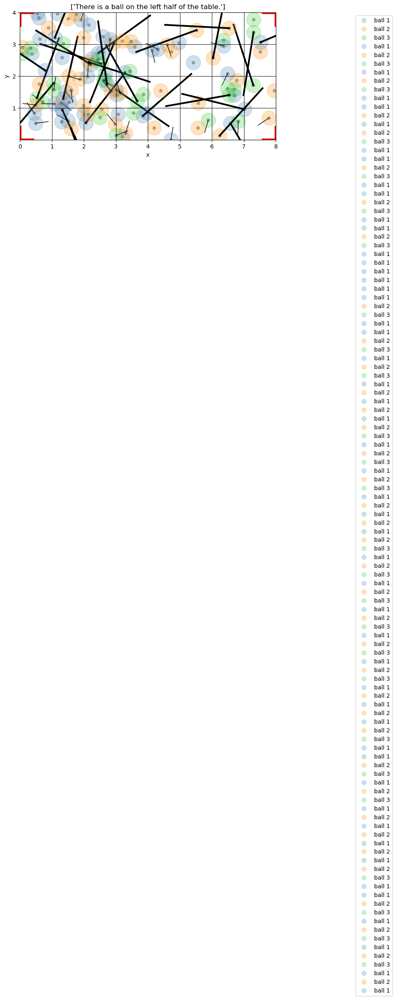

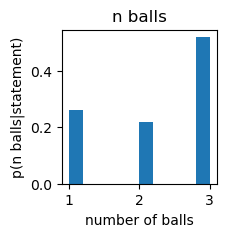


-3.76114685865295
-3.6515010012822415
-3.681995944763897
-3.5466774381906347
-3.52768204585694
-3.6478953480354304
-3.5316469645456303
-3.6979759327668185
-3.535936095409663
-3.7808668238024485
-3.5160152712253963
-3.4594511736896556
-3.6336048250646837


PyObject Text(0.5, 1.0, 'n balls')

In [237]:
reference_statements = ["There is a ball on the left half of the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is a ball on the bottom half of the table."]
There is a ball on the bottom half of the table.
----------------
-3.6056193145584636
-3.700440448704918
-3.475563157406145
-3.5955423333151337
-3.5497783074367923
-3.5083321070996103
-3.5838202230638636
-3.5109301606023218
-3.451031585248606
-3.456803298209187
-3.77210312572288
-3.4561864429223963
-3.689556484577507
-3.4239135594086947
-3.5038393485712636
-3.4899767763537266
-3.656070427662444
-3.534165341352381
-3.7989282187371085
-3.5885233280476205
-3.49137490800135
-3.6618947287905037
-3.668527395453226
-3.407115221653426

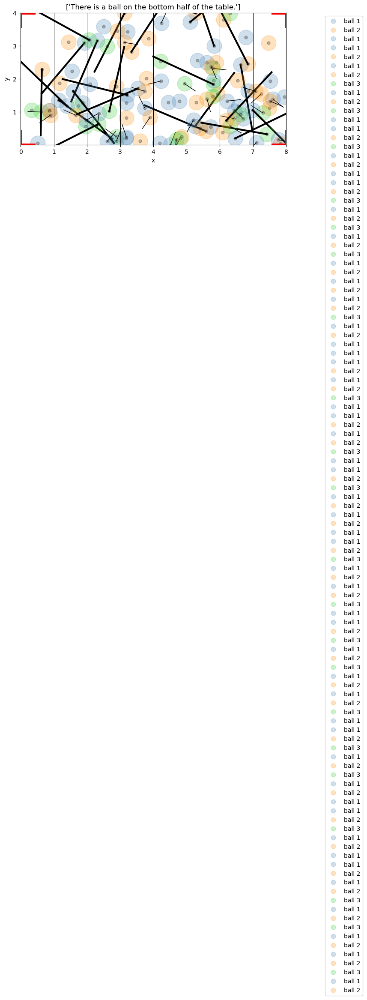

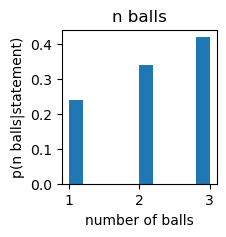


-3.4662582849869796
-3.5735582797032333
-3.553902379969112
-3.712489366971022
-3.67086825493609
-3.603281400676436
-3.6351726120607433
-3.4575402542208034
-3.4644408754121114
-3.6649393481576062
-3.8329694339156655
-3.3725504682976837
-3.6908096760966025
-3.6780082567078667
-3.7390790131336886
-3.440435672838179
-3.568093239512284
-3.7134440094729255
-3.6765845127358903
-3.484633654600601
-3.4831918989996153
-3.5429360746379057
-3.363663837779251
-3.701173128147387
-3.4723710987943024
-3.515345974951308


PyObject Text(0.5, 1.0, 'n balls')

In [238]:
reference_statements = ["There is a ball on the bottom half of the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is a ball in the lower left quadrant of the table."]
There is a ball in the lower left quadrant of the table.
----------------
-4.272274294115947
-4.181299629945898
-4.434939441726481
-3.948066743117069
-3.9938414097084776
-4.251480956312796
-4.271551424770826
-4.546526301402188
-4.236647894213849
-4.279603246328088
-4.543873952203233
-4.1748413709928345
-4.212790517868151
-4.196592365702985

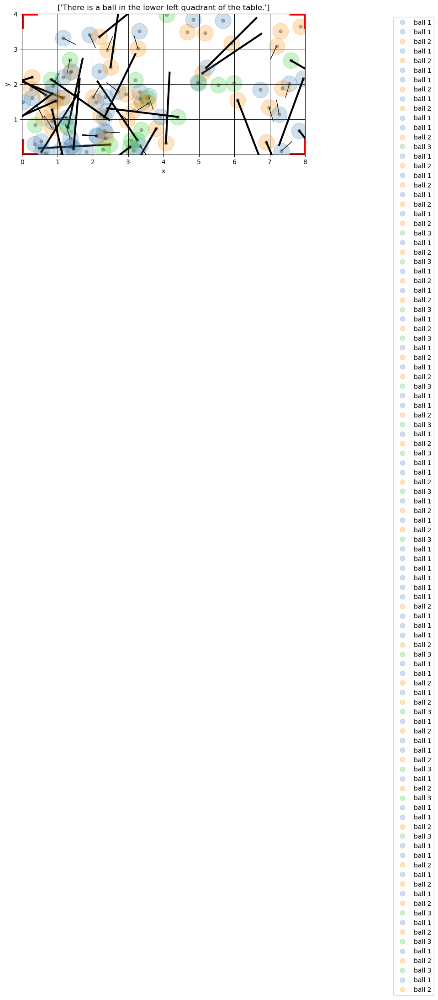

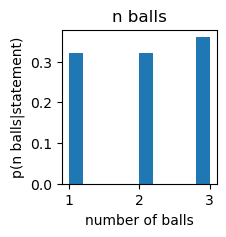


-4.323415992461217
-4.239398164319323
-4.642124933422288
-4.209072784496488
-4.05689154160053
-4.377004063681127
-4.216656714482487
-4.124241413964967
-4.495202247964102
-4.006350801250339
-4.074640530217952
-4.24413930427422
-4.157961372783557
-4.2881340100165035
-4.3679595573524965
-4.0697158370252025
-4.280656216879741
-4.082887562362842
-3.9610301820152314
-4.269080997286645
-4.2290139339226265
-4.330429339215982
-4.870560026661066
-4.015051601421034
-4.143643016229503
-4.134038045179832
-4.229624099083056
-3.987320934074107
-4.035394561975048
-4.162929068027158
-4.1867892266031435
-4.246808622200569
-4.262864184891288
-4.521216897279108
-4.497219842762865
-4.047541417681915


PyObject Text(0.5, 1.0, 'n balls')

In [239]:
reference_statements = ["There is a ball in the lower left quadrant of the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is a ball on the top half of the table."]
There is a ball on the top half of the table.
----------------
-3.5240025453900357
-3.475208957160701
-3.6090668657864327
-3.5725666388055672
-3.315574710558692
-3.546463405799014
-3.643242469523586
-3.600971390127394
-3.714538970915737
-3.6550229898366053
-3.585779426544766
-3.3985464567887447
-3.415938789729189
-3.6415725710048363
-3.7067937416663197
-3.8756457091310885


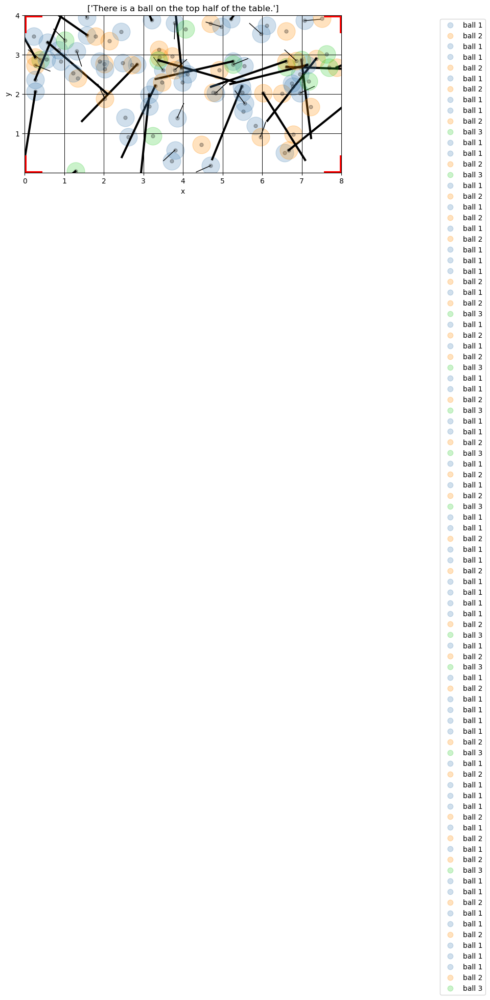

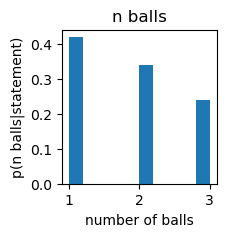

-3.509146599565807
-3.664507193654871
-3.3957294262393347
-3.564300569601233
-3.5554342486226322
-3.7757452770215654
-3.6381214742271464
-3.627086100342848
-3.531620313661092
-3.492573440376263
-3.426331398119355
-3.5374869290228403
-3.5548555576429104
-3.63849716207363
-3.512074167943614
-3.558539900753276
-3.5310421291038647
-3.4817986678448656
-3.6823870178506035
-3.4603887626255383
-3.412227887876611
-3.595189597235286
-3.5416495939299453
-3.4865468837858185
-3.3972049125511488
-3.5518096673443598
-3.56792570818061
-3.5862068777395386
-3.5514086096417703
-3.6832009441608298
-3.5290301226475616
-3.657721855650777
-3.511435994217248
-3.616608854464639


PyObject Text(0.5, 1.0, 'n balls')

In [240]:
reference_statements = ["There is a ball on the top half of the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is a ball in the upper left quadrant of the table."]
There is a ball in the upper left quadrant of the table.
----------------
-4.208431097526331
-4.226603288605854
-4.150006198322907
-4.1939859933128565
-4.244447939380443
-4.153900795007069
-4.150040193276528
-4.385015538933097
-4.468450410897523
-4.415963056586235
-4.483407741733648
-4.080896866830769
-4.048445586891165
-4.1082431728989155
-4.624222524007949
-4.058709569567725
-4.379410926856137
-4.1180083393365665
-4.030915335785199
-4.174581167235302
-4.0303381483073295
-3.895346045637607
-4.080813126404264
-4.448062910417595
-4.483550107198398
-4.5073334108899035
-4.281598393055648
-4.195191314249459
-3.929379252303294
-4.380243191443618
-4.0257944137851265
-4.480301736901508
-4.2163461253518335
-4.508644297960619
-3.8927022286580124
-4.374760138742153
-4.086690569844456
-4.692777905815546

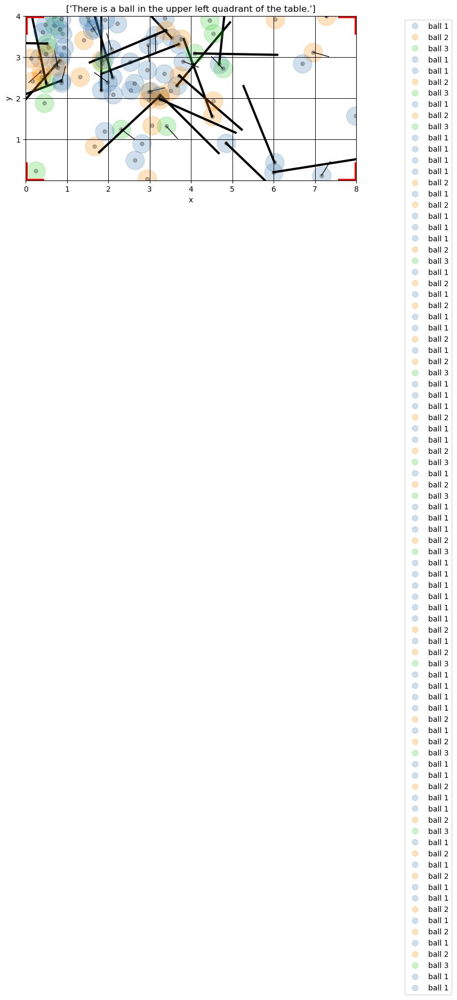

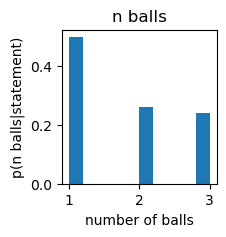


-4.410314548608345
-4.70537764181051
-4.35264335992845
-4.236140461225315
-4.3350612932068495
-4.128579782668773
-4.513577661365183
-4.700004549640212
-4.378949533905968
-4.468197806841271
-3.859145042175697
-4.271285931556451


PyObject Text(0.5, 1.0, 'n balls')

In [241]:
reference_statements = ["There is a ball in the upper left quadrant of the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is a ball on the right half of the table."]
There is a ball on the right half of the table.
----------------
-3.627854119128794
-3.3995880830875755
-3.532122355499024
-3.3680605642935673
-3.5781408936532584
-3.5048003984594756
-3.6320280483661476
-3.5273867538725945
-3.540783903783485
-3.6945599156311744
-3.5234220497600575
-3.396877877311823
-3.4383784714719217
-3.548580844991083
-3.4437549769590587
-3.675886871786061
-3.634396475707371
-3.4367228331882114
-3.609086263234454
-3.7443081733964325
-3.4892978711816065
-3.5790082507469165
-3.656241107021767
-3.444508673256502
-3.4552082172329897
-3.554579186575883
-3.528504387661151
-3.654084780069209
-3.45781109352093
-3.6864630472537616
-3.699772640443813
-3.5603341935531176
-3.6670454723085237
-3.433369366517038
-3.6323662608558185
-3.514327090673973
-3.4495653091072014
-3.4653545526369838
-3.4923923308920113
-3.499799867345934
-3.483370901147386
-3.517776327098959
-3.6241448477843496
-3.6215119006418393
-3.4174821619898488
-3.5

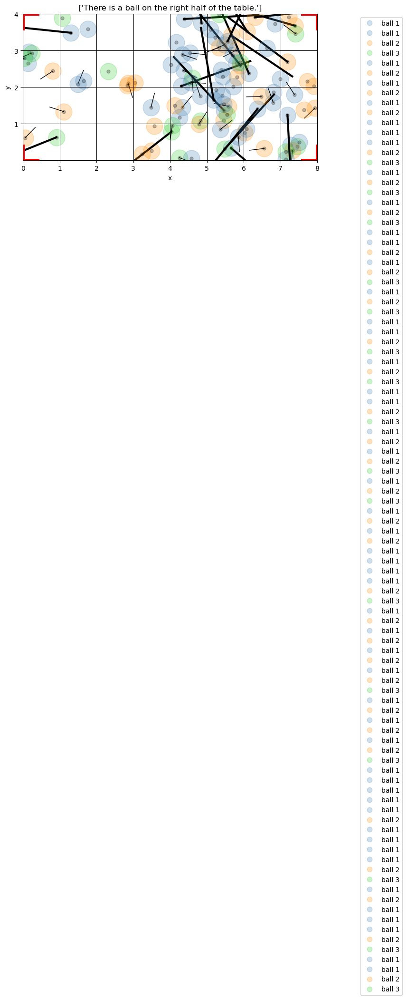

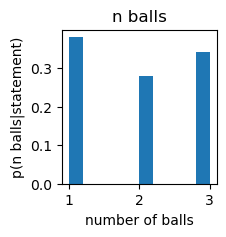

-3.4695000941396628
-3.7024533974116856
-3.538985248853042
-3.49633880704235


PyObject Text(0.5, 1.0, 'n balls')

In [242]:
reference_statements = ["There is a ball on the right half of the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is a ball on the bottom half of the table."]
There is a ball on the bottom half of the table.
----------------
-3.427150953110195
-3.652159502180139
-3.4885505184102943
-3.579820792036048
-3.6347328797672707
-3.5879314218539284
-3.525901948201388
-3.5175318580264863
-3.6252368604671457
-3.553747110372164
-3.4996819318346652
-3.460499921856626
-3.5698688323644507
-3.6559570274770996
-3.521456202076535
-3.677123501096428
-3.608665608199447
-3.508901233977489
-3.419284691851078
-3.507479574052594
-3.4329335062646273
-3.6608797314905632
-3.622501028130832
-3.547628916593145
-3.6908195567985738
-3.6748920656864996
-3.466541722983129
-3.3930365939537594
-3.7131269739315034
-3.553024861479877
-3.7619348030214033
-3.363952383176964
-3.505394333591557
-3.590534992864958
-3.5489237724789153
-3.456267869852406
-3.39828844681273
-3.533277269071698
-3.543626553713646
-3.3941923396711227
-3.6267072383131462
-3.6195561173175146
-3.7760645702601705

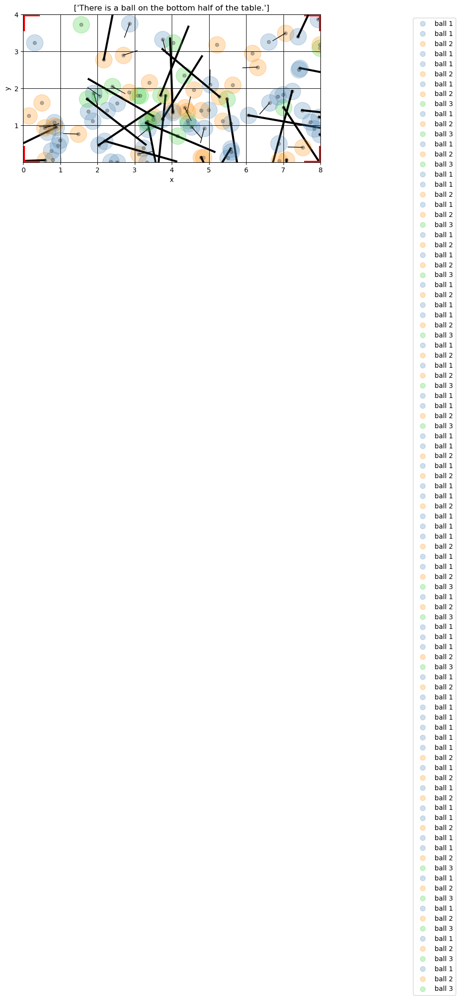

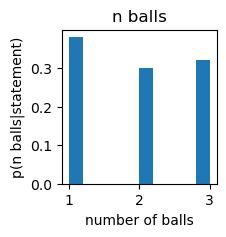


-3.750533556679672
-3.6204213194532677
-3.4943412446815634
-3.6645030855858236
-3.455804328810467
-3.5250045994316954
-3.612436331833187


PyObject Text(0.5, 1.0, 'n balls')

In [243]:
reference_statements = ["There is a ball on the bottom half of the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is a ball in the lower right quadrant of the table."]
There is a ball in the lower right quadrant of the table.
----------------
-4.593082910167094
-4.245411733360495
-4.066021133152844
-4.275781954361672
-4.349927577833069
-4.656184414081665
-4.327971571737456
-4.315060979855341
-4.4480379041500155
-4.200982735752142
-4.09522801382892
-4.227280232940601
-4.232124105875033
-4.401232494221421
-4.382283211160962
-4.159098190431309
-4.225461930326023
-4.105337732215169
-4.110165921414831
-4.314660583845065
-4.112165669327497
-4.160292814073615
-4.3282860001278065
-4.502103591066324
-4.312210341772552
-4.167594437355435
-4.246379783378871
-4.549182293809471
-4.305219055281006
-4.429999649730494
-4.644923749469867
-4.195596201680177
-4.339317886861785
-4.535006802746615
-4.381286039116388
-4.156031294897875
-4.032903741062975
-4.171237042861189


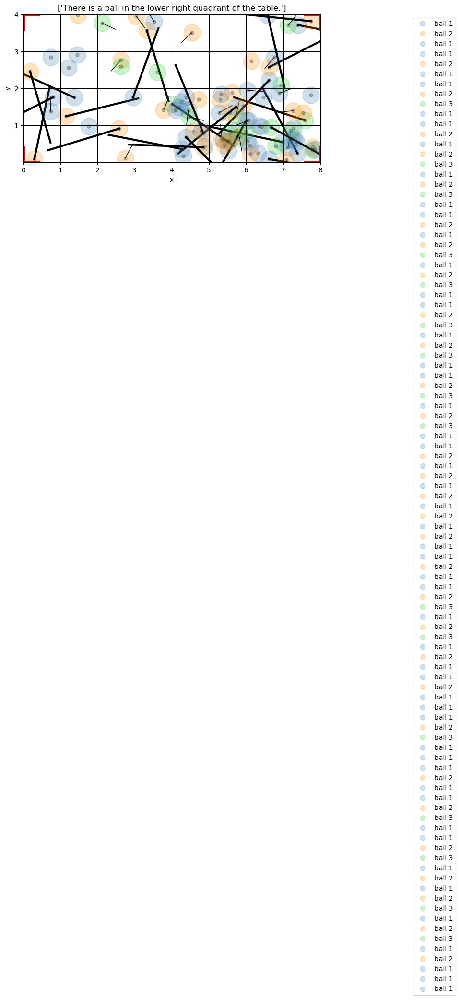

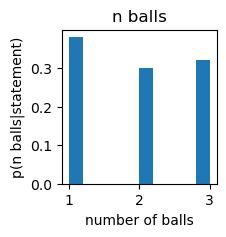

-4.291591037016201
-4.140155715865526
-4.14591577819974
-4.482252326319714
-4.4171449349813665
-4.257709763823025
-3.84009934564184
-4.301844862856979
-4.138407507596712
-4.301973210814185
-4.300745956266523
-3.889065777170619


PyObject Text(0.5, 1.0, 'n balls')

In [244]:
reference_statements = ["There is a ball in the lower right quadrant of the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is a ball on the top half of the table."]
There is a ball on the top half of the table.
----------------
-3.391397080007652
-3.447229506277348
-3.548755664335161
-3.4851280974871788
-3.5647614314224665
-3.6076335537345727
-3.452265955221195
-3.6282775573688735
-3.5480350105063323
-3.5323828246765734
-3.7294410951581556
-3.5691703861779973
-3.5550120604709985
-3.57723488161857
-3.7313800965123347
-3.502130363559063
-3.595856013836847
-3.4238688032548064
-3.595186455744434
-3.5260911219593862
-3.5992678086357843
-3.669272161832927
-3.5474616376475048
-3.59878887144574
-3.472338936414083
-3.5566421332137965
-3.5696867220695383
-3.592607825415616
-3.4694881052398427


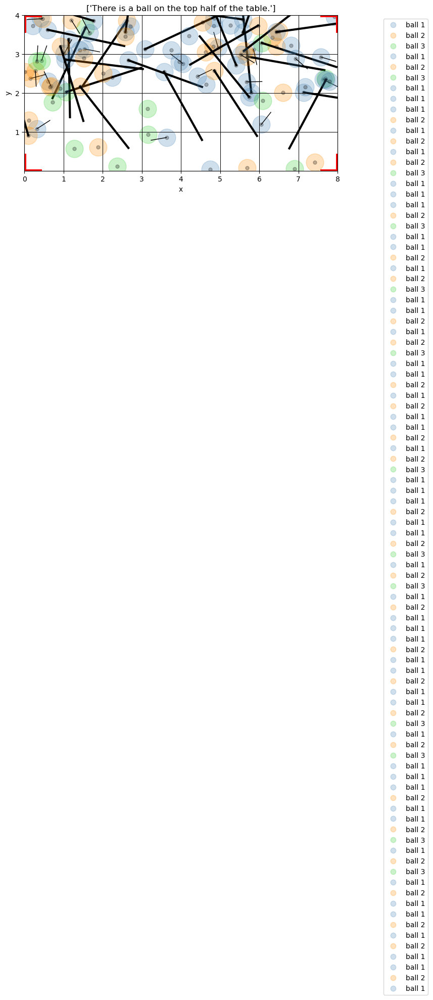

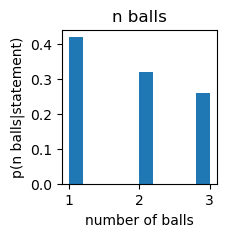

-3.704247406608819
-3.8503377538560066
-3.705504039717192
-3.42899046671082
-3.7500996121100894
-3.52656138605873
-3.5107682106496245
-3.743410184002097
-3.5127505657168765
-3.520357701503569
-3.46966786022502
-3.6446504209832233
-3.6628887154120946
-3.740048606693624
-3.62028257974924
-3.3829557643615447
-3.6960097630446955
-3.56646028386042
-3.6350105493365708
-3.779074912088862
-3.4999143793291276


PyObject Text(0.5, 1.0, 'n balls')

In [245]:
reference_statements = ["There is a ball on the top half of the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There is a ball in the upper right quadrant of the table."]
There is a ball in the upper right quadrant of the table.
----------------
-4.359639353254162
-4.232678396873442
-4.204716418169006
-4.21037351613919
-4.113646295081
-4.481885140505464
-4.429326138272576
-4.274255289136055
-4.574307521546918
-4.5561040820616
-4.228730166388101
-4.2186794016304034
-4.062066946175869
-3.971921812105775
-4.4536974346446305
-4.222999030930134
-4.081407510181707
-4.397105371621827
-4.244208186820308


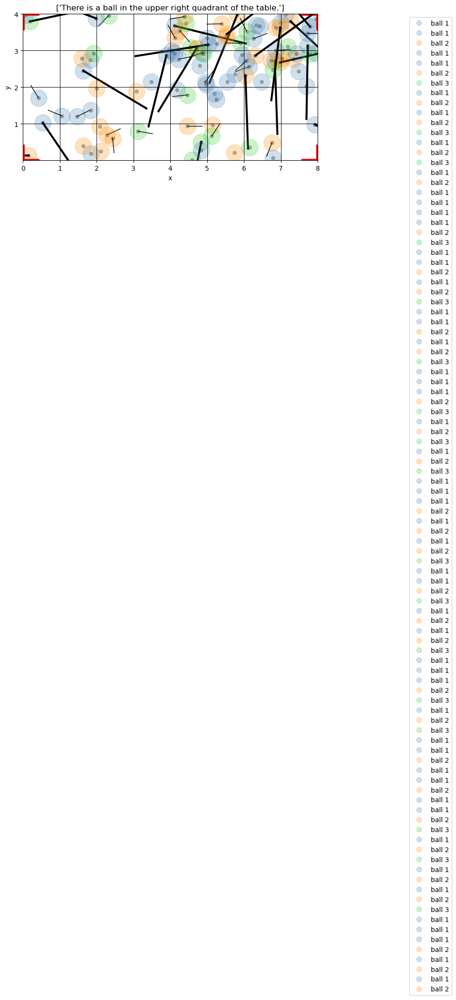

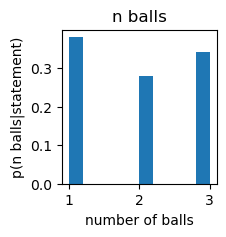

-4.359669059715017
-4.29887847238431
-3.9620682600071047
-4.396608575412662
-4.222484774530655
-4.627423353253742
-4.162282081067635
-4.417112906071794
-4.386907406333821
-4.386185244626773
-4.356034790347383
-4.607409456178792
-4.391404554839524
-4.206605650811883
-4.4202777195490635
-4.193101290939311
-4.164056724126203
-4.060294935367267
-4.140047590461875
-4.289080518903146
-4.325673424228175
-3.95349835656472
-4.358229602284111
-4.60797826512704
-4.031767076639463
-4.26881406411878
-4.079470531475129
-4.540659710967182
-4.048637412296283
-4.04644204559553
-4.759303331565577


PyObject Text(0.5, 1.0, 'n balls')

In [246]:
reference_statements = ["There is a ball in the upper right quadrant of the table."]
println(reference_statements)

traces = infer_worlds((8,4), 1, reference_statements, 100, 50, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

In [249]:
reference_statements = ["There are balls at (x,y) = (1.0,1.0) and (2.0,2.0)."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 1000000, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are balls at (x,y) = (1.0,1.0) and (2.0,2.0)."]
There are balls at (x,y) = (1.0,1.0) and (2.0,2.0).
----------------
-Inf
-Inf
-Inf
-Inf


LoadError: InterruptException:

["There is a ball at (x,y) = (2.0,2.0)."]
There is a ball at (x,y) = (2.0,2.0).
----------------
-15.543047415225644
-14.822366384252499
-16.078355322308806
-15.11415964741413
-15.43849818587379
-15.034698867867856
-15.28806036005658
-15.484524060233971
-15.641941344796784
-15.76798063793332


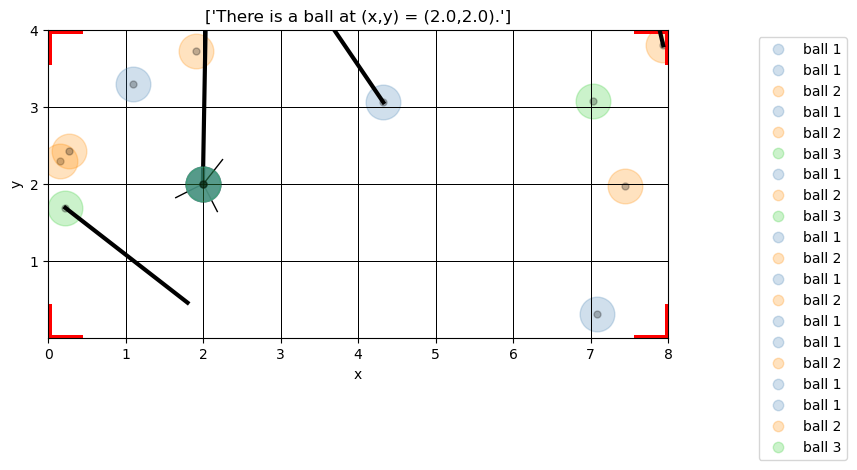

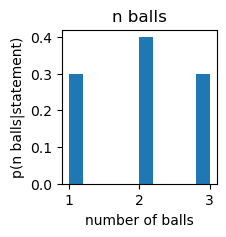

190.101929 seconds (2.30 G allocations: 147.649 GiB, 12.98% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [253]:
reference_statements = ["There is a ball at (x,y) = (2.0,2.0)."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 1000000, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

In [255]:
reference_statements = ["There are balls at (x,y) = (2.0,1.0) and (1.0,2.0)."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10000000, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)



["There are balls at (x,y) = (2.0,1.0) and (1.0,2.0)."]
There are balls at (x,y) = (2.0,1.0) and (1.0,2.0).
----------------
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf


LoadError: InterruptException:

["All the balls are on the same half (top/bottom) of the table."]
All the balls are on the same half (top/bottom) of the table.
----------------
-5.1475220634008565
-5.282579785500027
-5.0170350391941
-4.77195784846455
-5.280545196802239
-5.264082537082236
-4.825945853298506
-4.970006421671148
-5.072969350301401
-5.0737954552637055


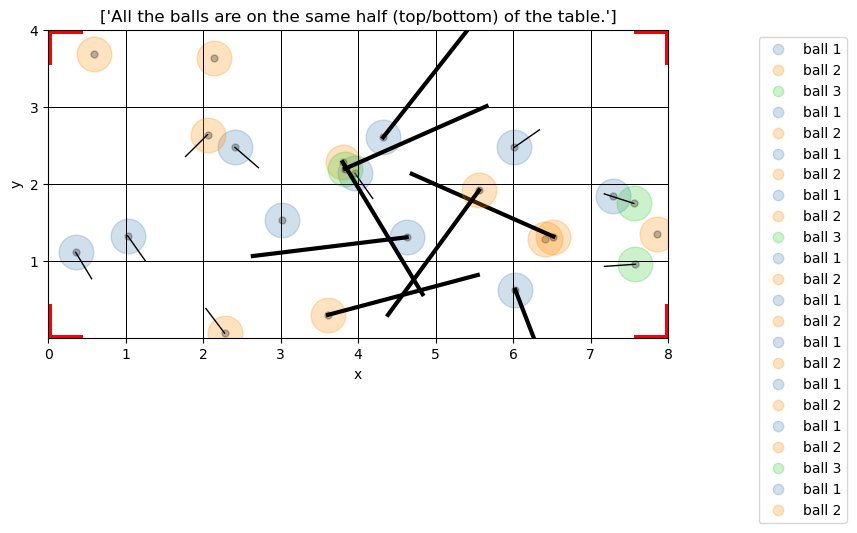

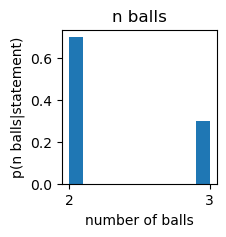

  0.537000 seconds (257.92 k allocations: 16.516 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [260]:
reference_statements = ["All the balls are on the same half (top/bottom) of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)




["All the balls are in the same quadrant of the table."]
All the balls are in the same quadrant of the table.
----------------
-7.418580902748128
-8.517193191416238
-8.517193191416238
-7.418580902748128
-7.824046010856293
-8.517193191416238
-Inf
-8.517193191416238
-7.418580902748128
-7.824046010856293
  

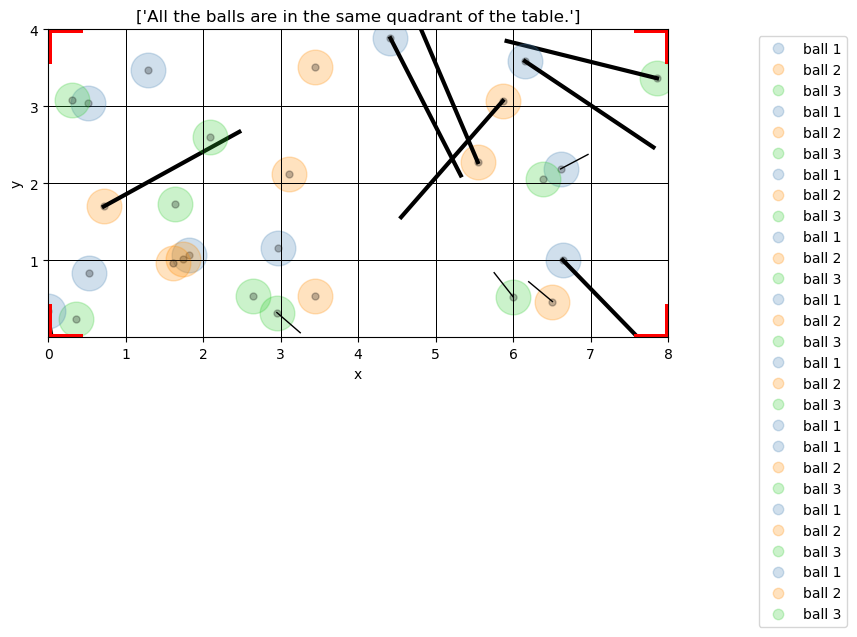

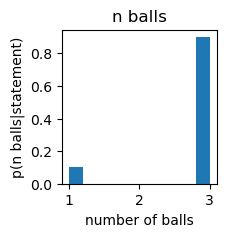

0.638692 seconds (258.71 k allocations: 16.549 MiB, 2.50% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [262]:
reference_statements = ["All the balls are in the same quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the same quadrant of the table and on the left side of the table."]
All the balls are in the same quadrant of the table and on the left side of the table.
----------------
-6.800009321078917
-6.860654118335213
-6.8090423877118305
-6.851921716575737
-6.843794736860756
-6.812491792148195
-6.793711463133336
-6.8717398870274895
-6.792841160991971
-6.837120202466368
  

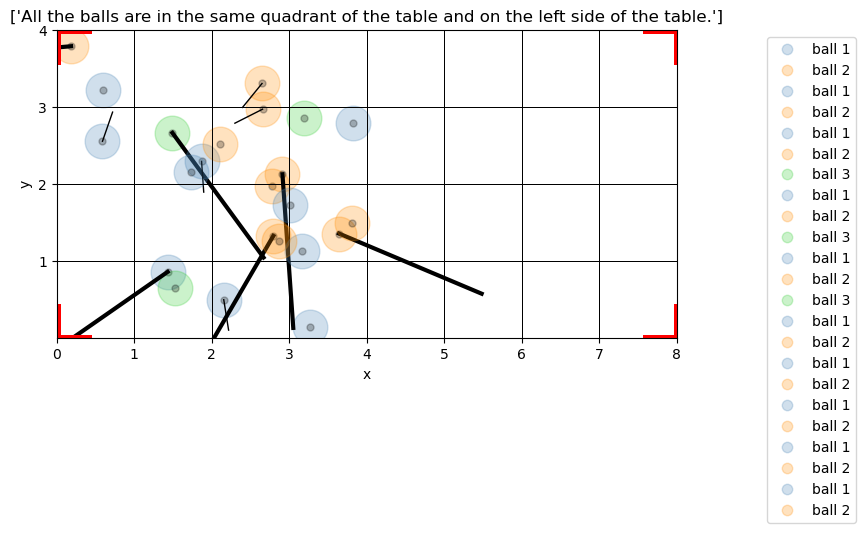

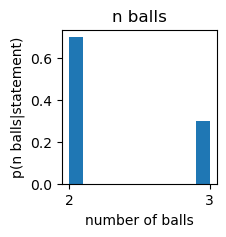

2.245417 seconds (23.06 M allocations: 1.482 GiB, 11.14% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [272]:
reference_statements = ["All the balls are in the same quadrant of the table and on the left side of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10000, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in the same quadrant of the table and on the left side of the table."]
There are two balls in the same quadrant of the table and on the left side of the table.
----------------
-5.513690721926018
-5.7948763738787665
-6.345052115948463
-5.492658926958541
-5.787082738627949
-6.181697572539232
-5.504072258716807
-5.750417797296123
-6.828712071641684
-5.8351527501979445
  

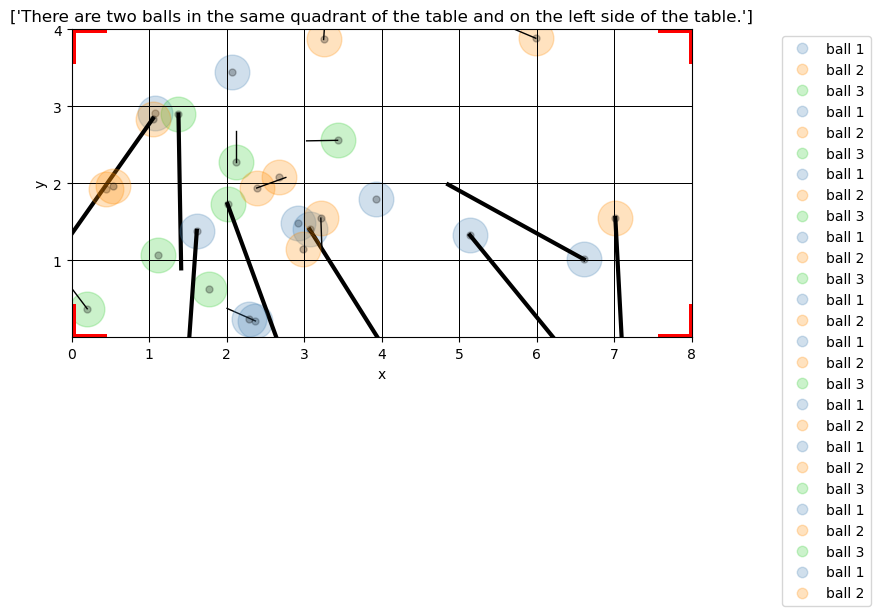

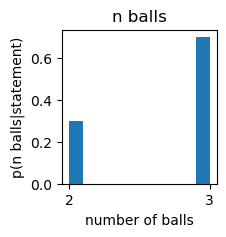

0.396181 seconds (261.87 k allocations: 16.820 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [284]:
reference_statements = ["There are two balls in the same quadrant of the table and on the left side of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in the bottom left quadrant of the table."]
There are two balls in the bottom left quadrant of the table.
----------------
-6.257167712840988
-6.470338571067371
-5.863087997619037
-6.074269327569644
-7.542061959519149
-6.1175156483465365
-6.149156844601206
-7.242713510772135
-6.505180346296206
-6.248494967319305


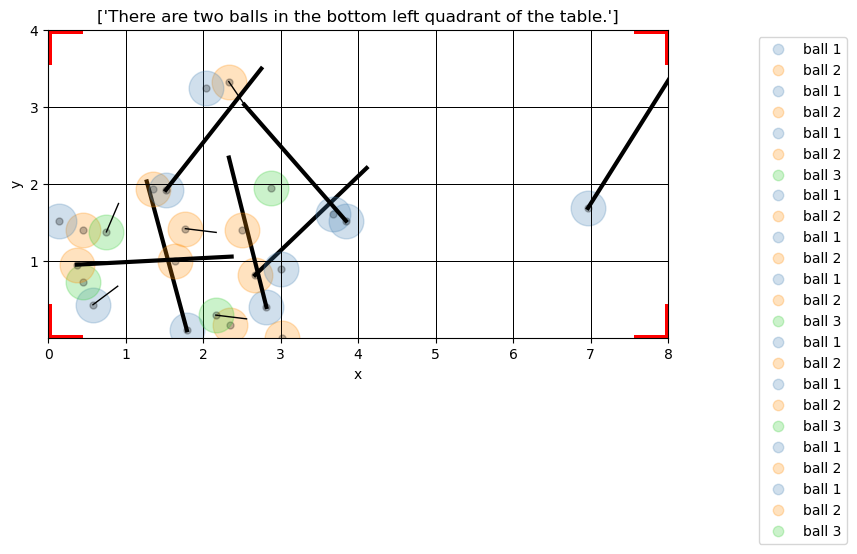

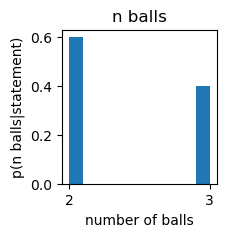

  0.355236 seconds (255.78 k allocations: 16.352 MiB, 3.02% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [296]:
reference_statements = ["There are two balls in the bottom left quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the same quadrant of the table and on the left side of the table."]
All the balls are in the same quadrant of the table and on the left side of the table.
----------------
-6.492239835020472
-7.0030654587864625
-6.492239835020472
-7.657426614311252
-6.686153748019743
-7.408530566894626
-6.715383386334682
-6.386201582976148
-6.832107660642823
-6.686153748019743
  

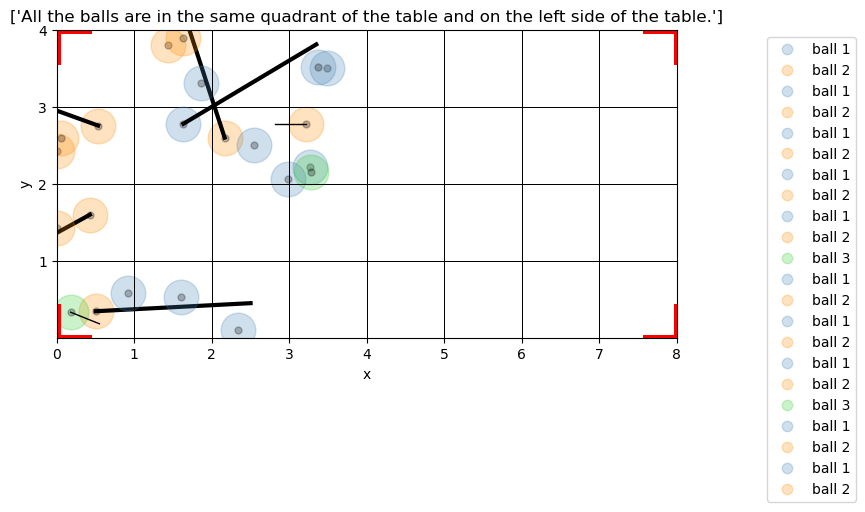

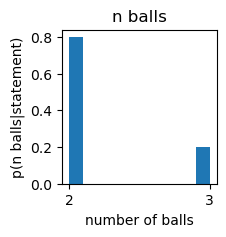

0.331466 seconds (255.35 k allocations: 16.368 MiB, 3.41% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [283]:
reference_statements = ["All the balls are in the same quadrant of the table and on the left side of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the bottom left quadrant of the table."]
All the balls are in the bottom left quadrant of the table.
----------------
-8.101677747454572
-8.101677747454572
-8.101677747454572
-6.8372732039437185
-7.408530566894626
-Inf
-7.0030654587864625
-7.169126494708637
-7.169126494708637
-6.976109648797934
  

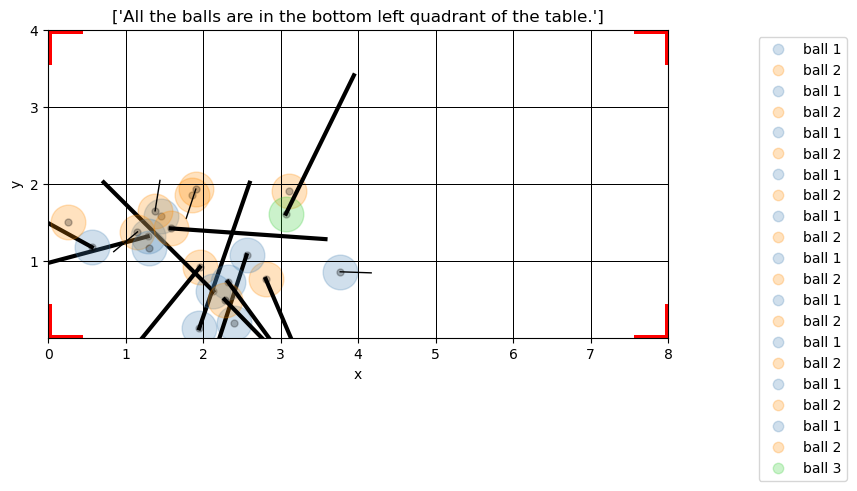

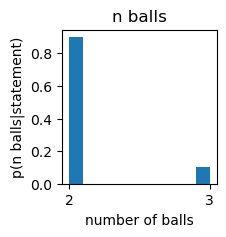

0.345864 seconds (481.86 k allocations: 31.199 MiB, 3.32% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [297]:

reference_statements = ["All the balls are in the bottom left quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in the same quadrant of the table and on the right side of the table."]
There are two balls in the same quadrant of the table and on the right side of the table.
----------------
-5.6027548367348246
-6.042985709788646
-6.133354221658897
-5.528676762531154
-6.030754526729394
-5.600702607520297
-5.56628169774418
-6.346285922397392
-5.339121619404656
-5.924958620449202


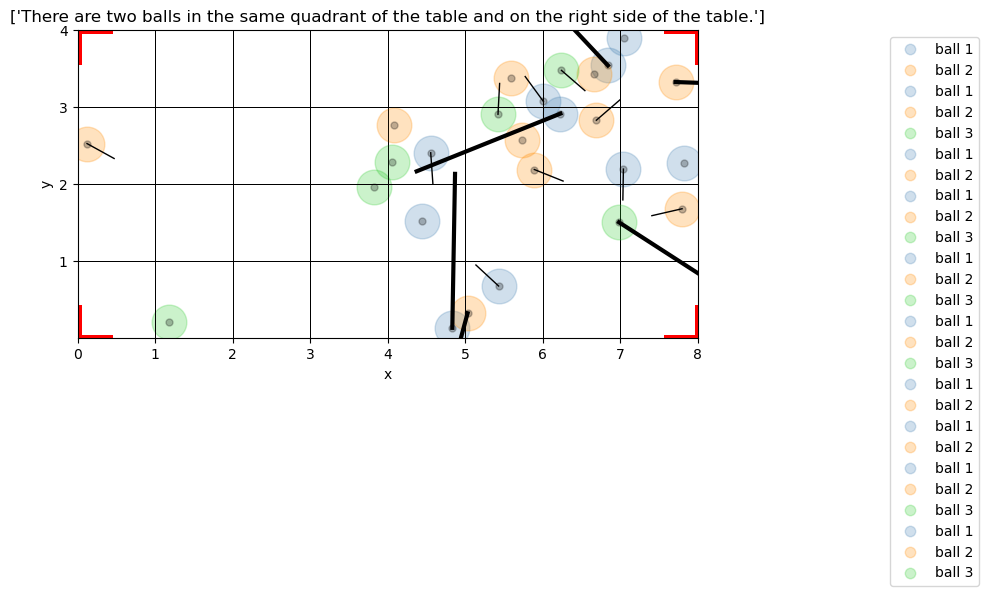

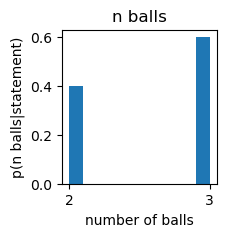

  0.693271 seconds (255.05 k allocations: 16.254 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [298]:


reference_statements = ["There are two balls in the same quadrant of the table and on the right side of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in the bottom right quadrant of the table."]
There are two balls in the bottom right quadrant of the table.
----------------
-6.770443163517709
-6.279435261501441
-6.180039381183569
-6.8277125713086
-6.13007996085117
-6.380553933606954
-6.363720984219493
-7.063169382856168
-6.480575112124752
-6.966825373771319
  

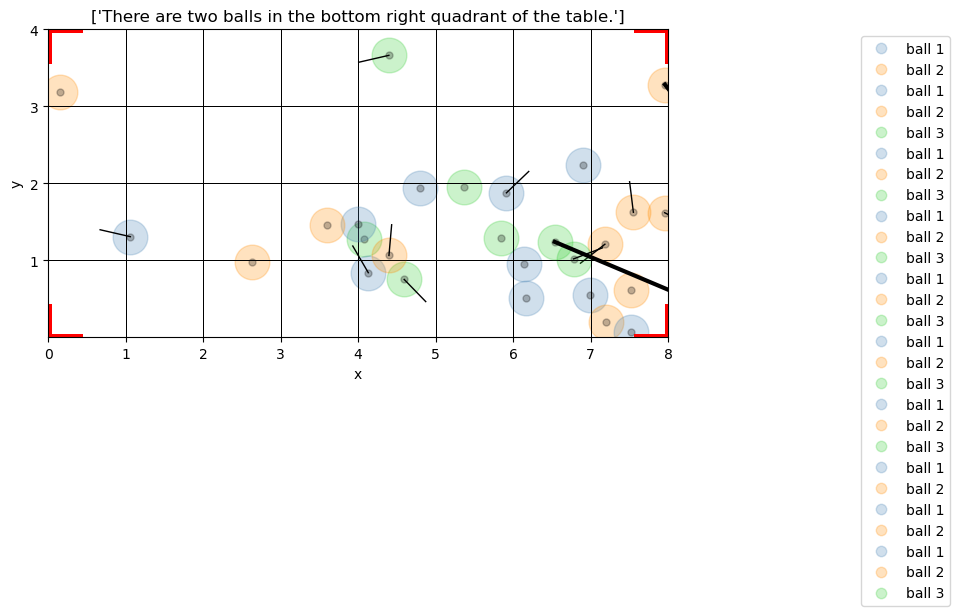

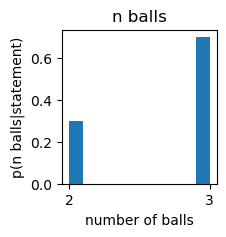

0.435194 seconds (254.90 k allocations: 16.265 MiB, 1.96% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [302]:
reference_statements = ["There are two balls in the bottom right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in the bottom right quadrant of the table."]
There are two balls in the bottom right quadrant of the table.
----------------
-6.889524211038442
-6.470338571067371
-6.112617102490749
-6.573294959777179
-7.1572161386137205
-6.279435261501441
-6.81777213160335
-6.3692142553696005
-6.779921907472253
-6.878953288078431
  

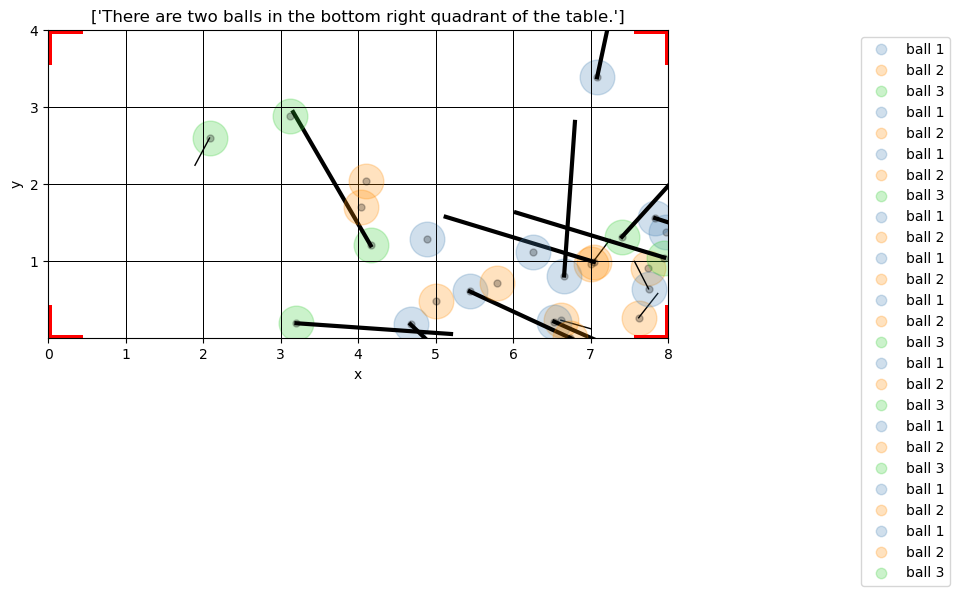

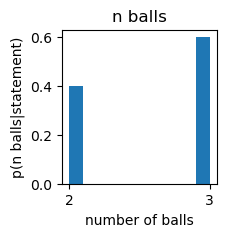

0.382204 seconds (263.99 k allocations: 16.973 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [304]:
reference_statements = ["There are two balls in the bottom right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the same quadrant of the table and on the right side of the table."]
All the balls are in the same quadrant of the table and on the right side of the table.
----------------
-Inf
-6.296349549020448
-7.408530566894626
-7.0030654587864625
-6.695098715163176
-6.715383386334682
-6.695098715163176
-6.492239835020472
-6.695098715163176
-6.715383386334682
  

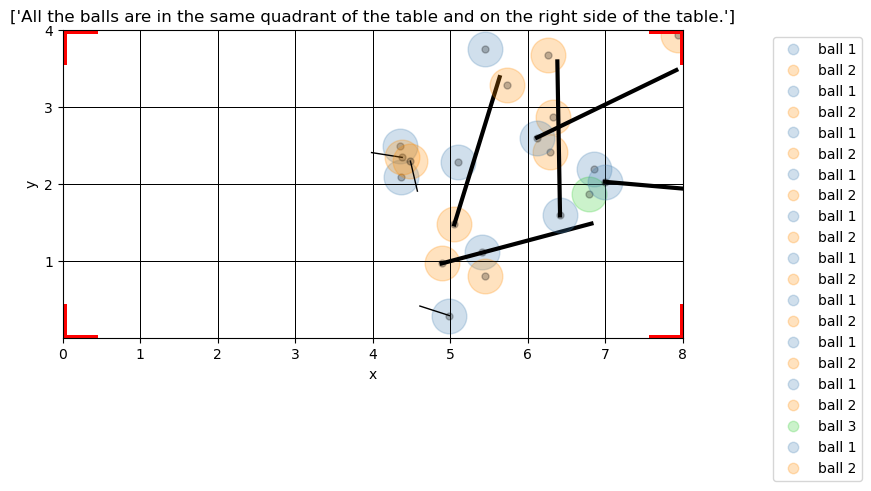

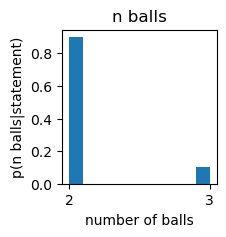

0.675569 seconds (482.07 k allocations: 31.320 MiB, 2.16% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [306]:
reference_statements = ["All the balls are in the same quadrant of the table and on the right side of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the bottom right quadrant of the table."]
All the balls are in the bottom right quadrant of the table.
----------------
-7.408530566894626
-Inf
-8.101677747454572
-7.408530566894626
-7.408530566894626
-7.169126494708637
-8.101677747454572
-8.716044050161404
-6.695098715163176
-8.101677747454572


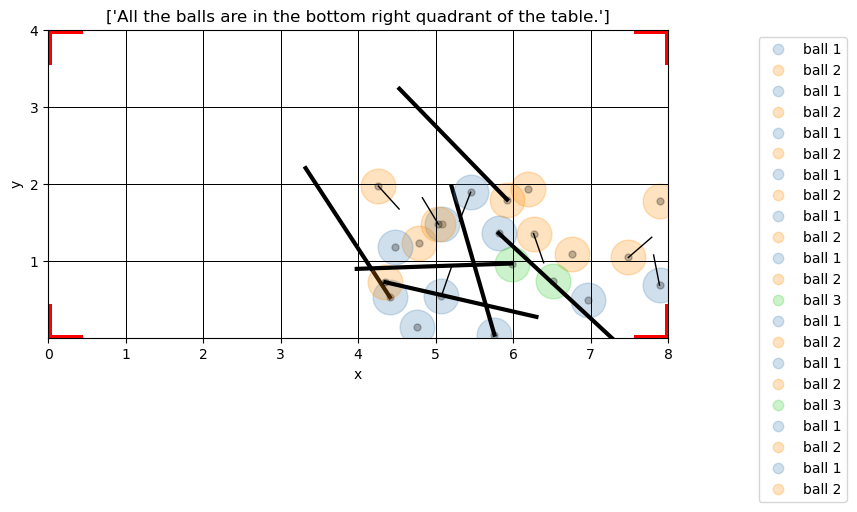

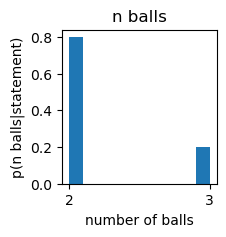

  0.346322 seconds (484.08 k allocations: 31.320 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [307]:
reference_statements = ["All the balls are in the bottom right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in the same quadrant of the table and on the right side of the table."]
There are two balls in the same quadrant of the table and on the right side of the table.
----------------
-6.177728290347677
-5.334364920649457
-5.35476719356334
-6.031914032776845
-5.694917267019311
-6.565578872111317
-5.890493040173892
-6.196377030478496
-6.5131716710615075
-5.78350055970069


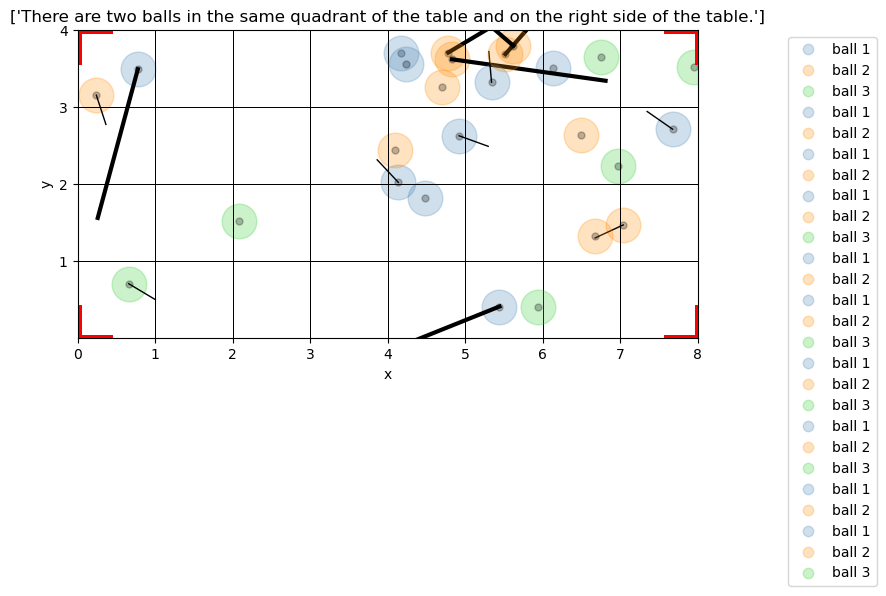

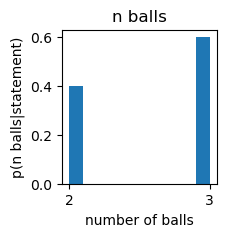

  0.931074 seconds (252.77 k allocations: 16.100 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [309]:
reference_statements = ["There are two balls in the same quadrant of the table and on the right side of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in the top right quadrant of the table."]
There are two balls in the top right quadrant of the table.
----------------
-6.415278793884344
-6.531258226721743
-6.6380917120330345
-6.321292241010527
-7.696212639346408
-6.415940388351082
-6.722551875813293
-6.478055200028515
-5.902302219394492
-6.467947142451427


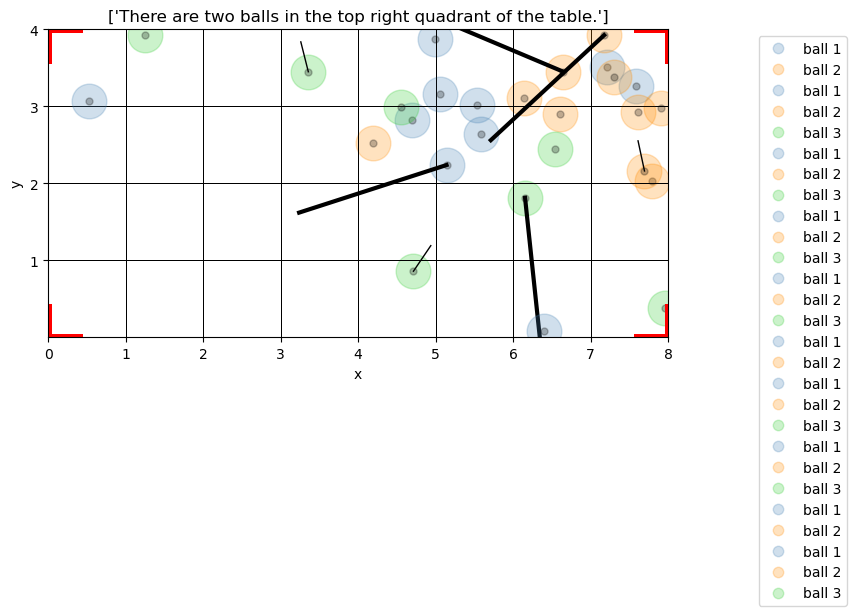

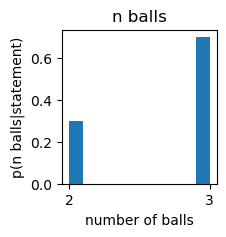

  0.404491 seconds (248.74 k allocations: 15.767 MiB, 2.90% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [311]:
reference_statements = ["There are two balls in the top right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the same quadrant of the table and on the right side of the table."]
All the balls are in the same quadrant of the table and on the right side of the table.
----------------
-6.715383386334682
-8.101677747454572
-7.0030654587864625
-6.695098715163176
-6.389505716144864
-7.669256829357879
-7.169126494708637
-8.101677747454572
-7.669256829357879
-6.976109648797934


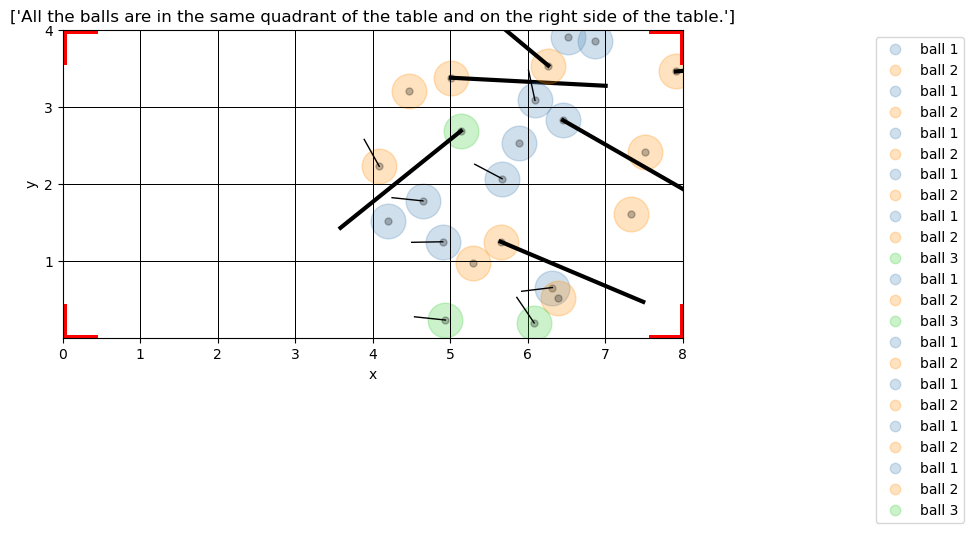

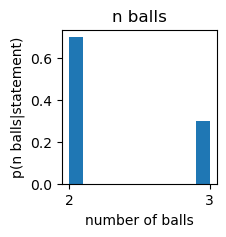

  0.585375 seconds (251.87 k allocations: 16.049 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [312]:
reference_statements = ["All the balls are in the same quadrant of the table and on the right side of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the top right quadrant of the table."]
All the balls are in the top right quadrant of the table.
----------------
-6.976109648797934
-6.8372732039437185
-8.101677747454572
-7.669256829357879
-6.588534105440544
-8.716044050161404
-6.8372732039437185
-7.669256829357879
-7.169126494708637
-7.0030654587864625


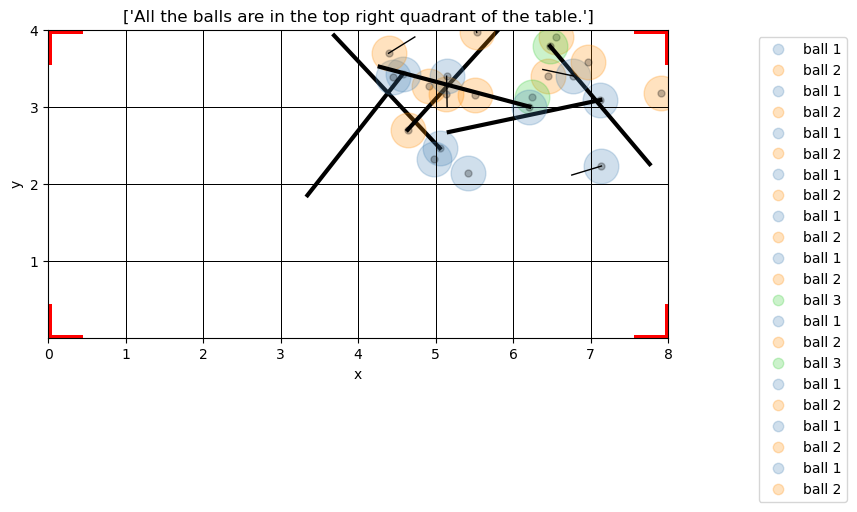

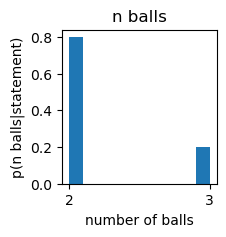

  0.420964 seconds (252.26 k allocations: 16.091 MiB, 8.65% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [313]:
reference_statements = ["All the balls are in the top right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the bottom left quadrant of the table."]
All the balls are in the bottom left quadrant of the table.
----------------
-8.101677747454572
-7.169126494708637
-Inf
-7.408530566894626
-7.0030654587864625
-8.716044050161404
-6.57064454068977
-7.169126494708637
-7.408530566894626
-7.669256829357879
  

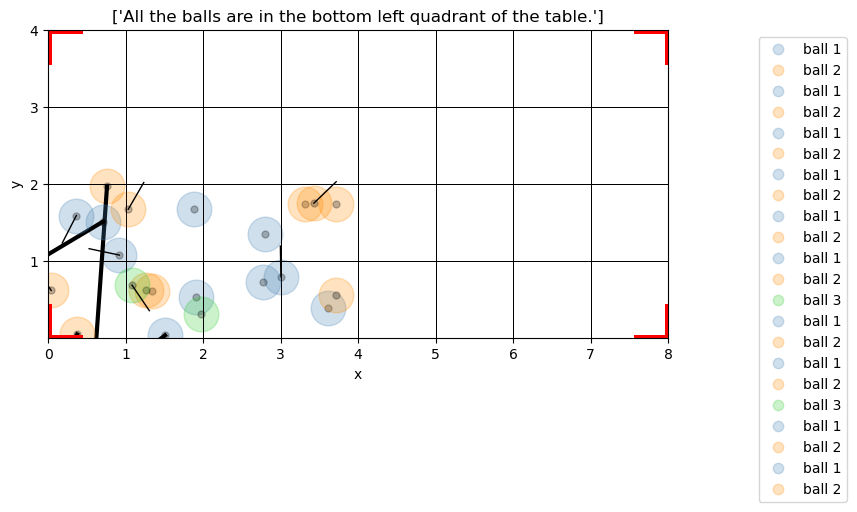

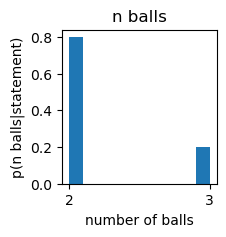

0.683324 seconds (485.96 k allocations: 31.505 MiB, 1.64% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [315]:
reference_statements = ["All the balls are in the bottom left quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the top left quadrant of the table."]
All the balls are in the top left quadrant of the table.
----------------
-6.715383386334682
-8.101677747454572
-7.669256829357879
-Inf
-7.669256829357879
-6.8372732039437185
-7.169126494708637
-6.588534105440544
-8.716044050161404
-7.169126494708637


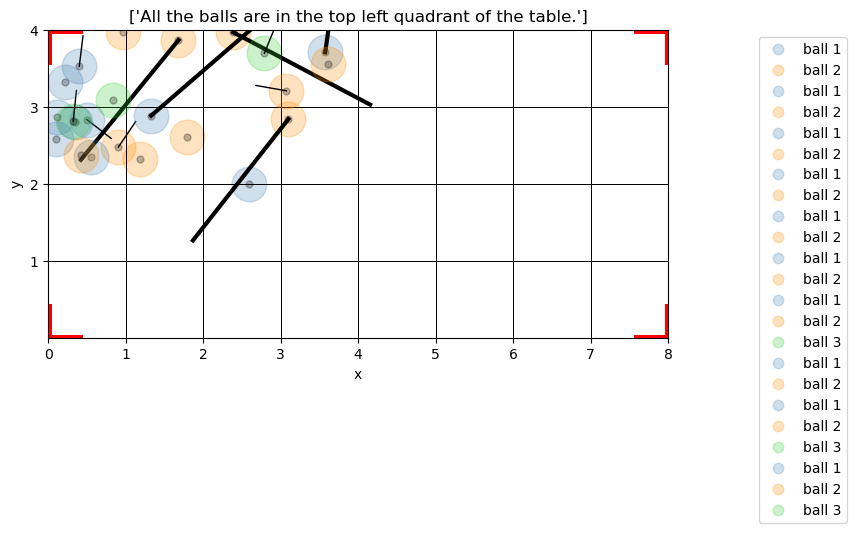

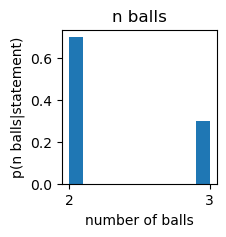

  0.377003 seconds (485.74 k allocations: 31.451 MiB, 2.43% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [316]:
reference_statements = ["All the balls are in the top left quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the same quadrant of the table and on the right side of the table."]
All the balls are in the same quadrant of the table and on the right side of the table.
----------------
-7.169126494708637
-7.169126494708637
-7.169126494708637
-7.669256829357879
-7.0030654587864625
-7.0030654587864625
-6.588534105440544
-6.492239835020472
-6.8372732039437185
-6.22359019473802


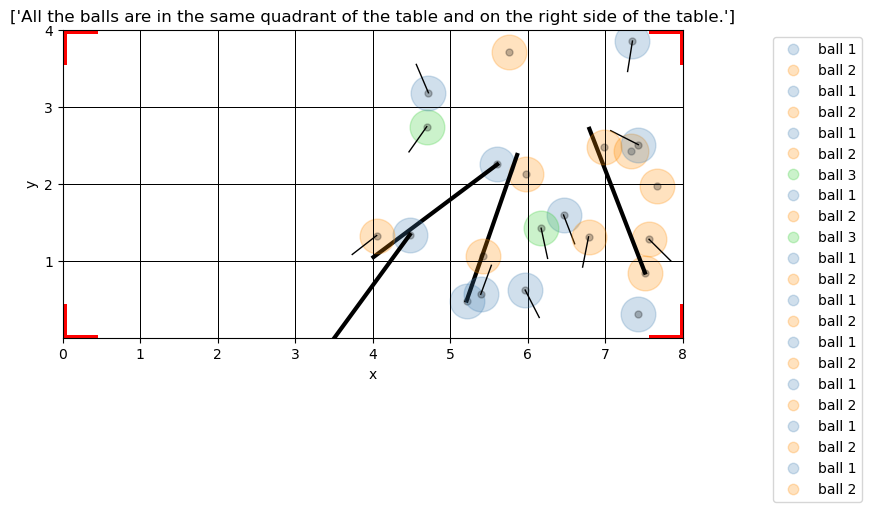

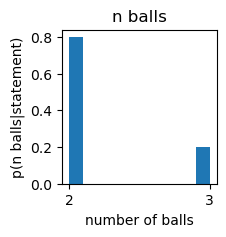

  0.558771 seconds (251.91 k allocations: 16.068 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [317]:
reference_statements = ["All the balls are in the same quadrant of the table and on the right side of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the bottom right quadrant of the table."]
All the balls are in the bottom right quadrant of the table.
----------------
-7.0030654587864625
-7.169126494708637
-7.0030654587864625
-7.408530566894626
-6.695098715163176
-6.8372732039437185
-8.101677747454572
-7.169126494708637
-7.408530566894626
-7.169126494708637
  

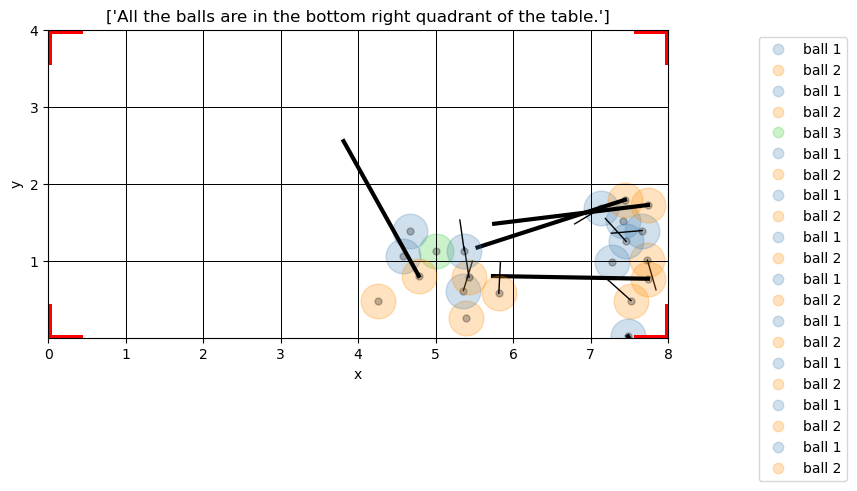

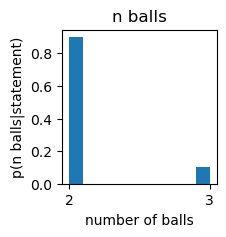

0.297877 seconds (250.23 k allocations: 15.935 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [318]:
reference_statements = ["All the balls are in the bottom right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the top right quadrant of the table."]
All the balls are in the top right quadrant of the table.
----------------
-6.309918278226517
-7.368364525169292
-8.101677747454572
-7.408530566894626
-8.716044050161404
-6.715383386334682
-Inf
-8.101677747454572
-6.309918278226517
-6.715383386334682
  

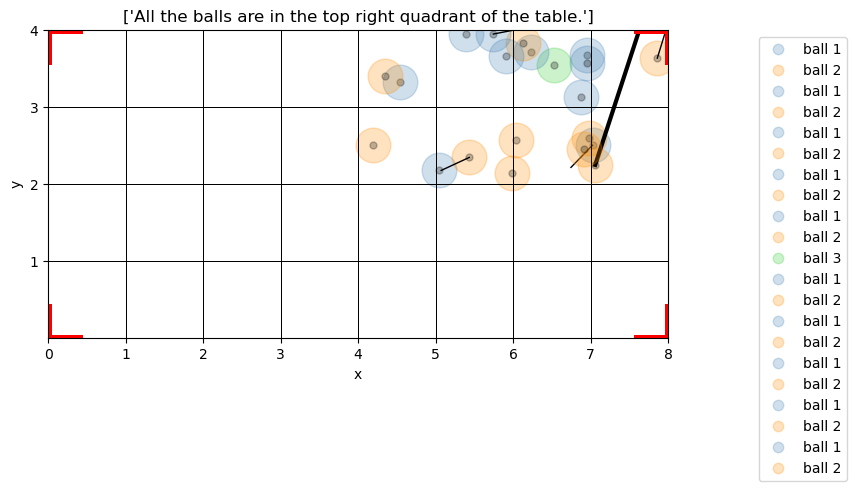

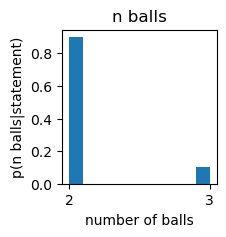

0.369377 seconds (487.29 k allocations: 31.682 MiB, 4.86% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [319]:
reference_statements = ["All the balls are in the top right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the same half (top/bottom) of the table."]
All the balls are on the same half (top/bottom) of the table.
----------------
-5.178516166735417
-5.1638437949627205
-5.095451547923138
-5.164478023332249
-5.015602902870038
-5.049092662307798
-5.174759789900941
-5.289090320324129
-5.03353331822226
-5.058444196194655


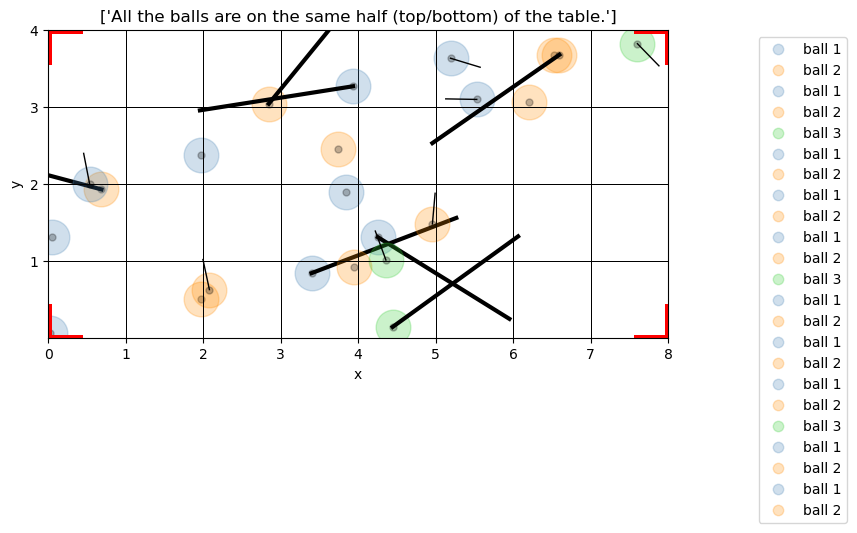

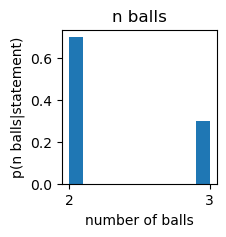

  0.820951 seconds (259.98 k allocations: 16.676 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [320]:
reference_statements = ["All the balls are on the same half (top/bottom) of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the bottom half of the table."]
All the balls are on the bottom half of the table.
----------------
-5.8920891195256955
-6.628980117702733
-5.4379278052489415
-5.587053148452462
-6.034566004662192
-5.555992196527117
-5.6910472218301065
-6.430204444101019
-6.558169487266809
-5.496768305271875
  

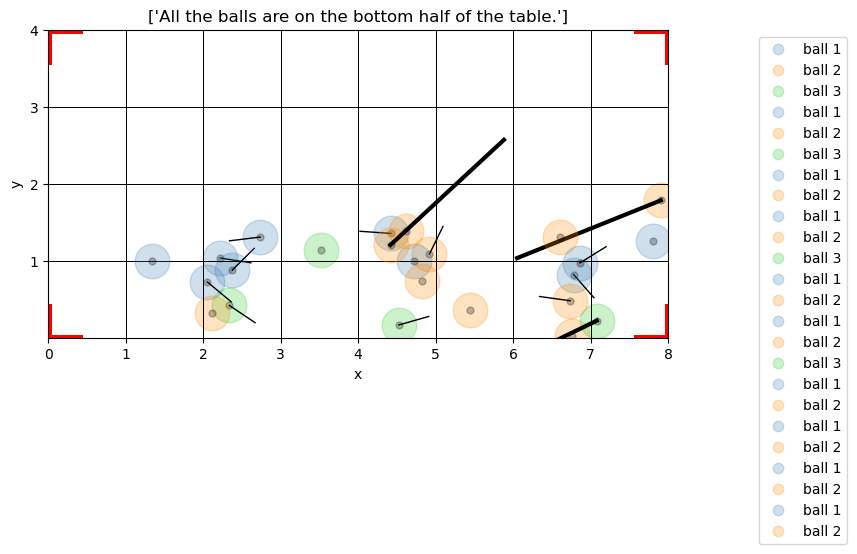

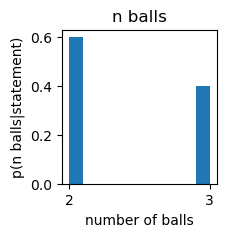

0.589503 seconds (255.91 k allocations: 16.345 MiB, 31.56% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [321]:
reference_statements = ["All the balls are on the bottom half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the bottom half of the table, and they are in the same quadrant."]
All the balls are on the bottom half of the table, and they are in the same quadrant.
----------------
-7.680464282378269
-6.3926099940716306
-6.3926099940716306
-8.101677747454572
-6.592323293577454
-7.0030654587864625
-6.828712071641684
-6.842135091973825
-7.1759082716258735
-7.680464282378269


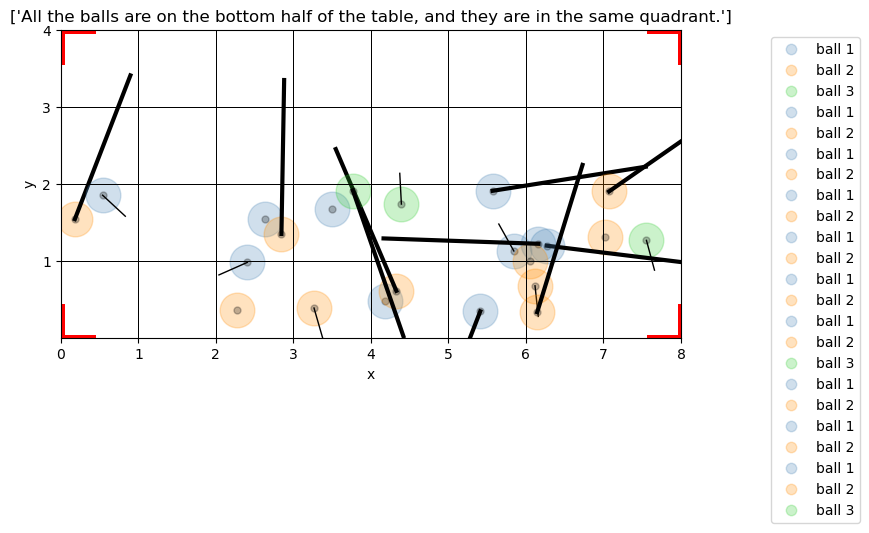

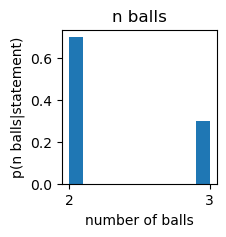

  0.984398 seconds (712.96 k allocations: 38.776 MiB, 8.85% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [325]:
reference_statements = ["All the balls are on the bottom half of the table, and they are in the same quadrant."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the bottom left quadrant of the table."]
All the balls are in the bottom left quadrant of the table.
----------------
-7.408530566894626
-8.748304912379623
-Inf
-7.408530566894626
-8.748304912379623
-6.592323293577454
-6.715383386334681
-Inf
-Inf
-6.715383386334681
  

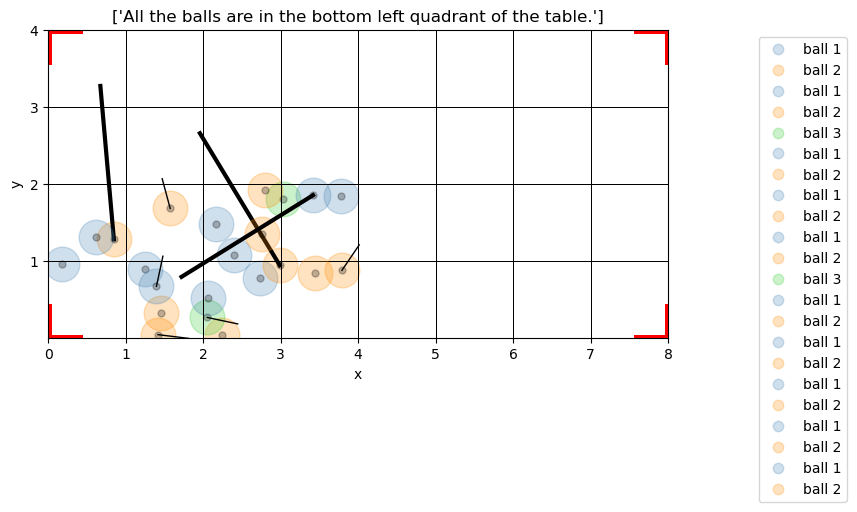

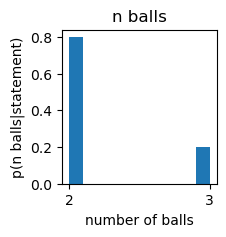

1.221942 seconds (1.41 M allocations: 84.533 MiB, 12.42% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [327]:
reference_statements = ["All the balls are in the bottom left quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the bottom right quadrant of the table."]
All the balls are in the bottom right quadrant of the table.
----------------
-6.1489879114138795
-6.715383386334681
-7.408530566894626
-Inf
-Inf
-7.1759082716258735
-6.715383386334681
-6.715383386334681
-7.408530566894626
-6.022236205774736
  

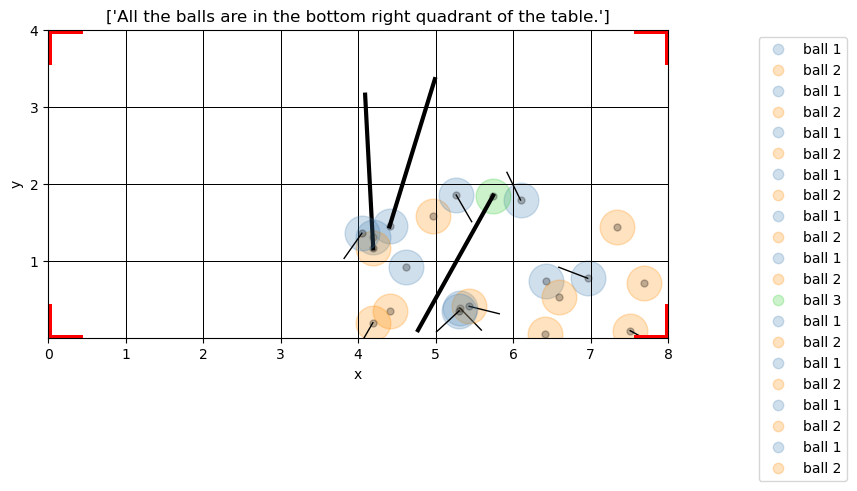

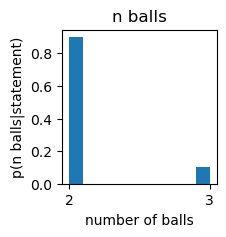

1.062951 seconds (709.31 k allocations: 46.092 MiB, 1.07% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [329]:
reference_statements = ["All the balls are in the bottom right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the bottom half of the table, but they are in different quadrants."]
All the balls are on the bottom half of the table, but they are in different quadrants.
----------------
-6.1092475827643655
-6.53046104784067
-6.0196354240746786
-6.51471269087253
-5.937397325837707
-5.326488243514733
-5.937397325837707
-5.982247892003059
-6.383136333083811
-5.543697059309128


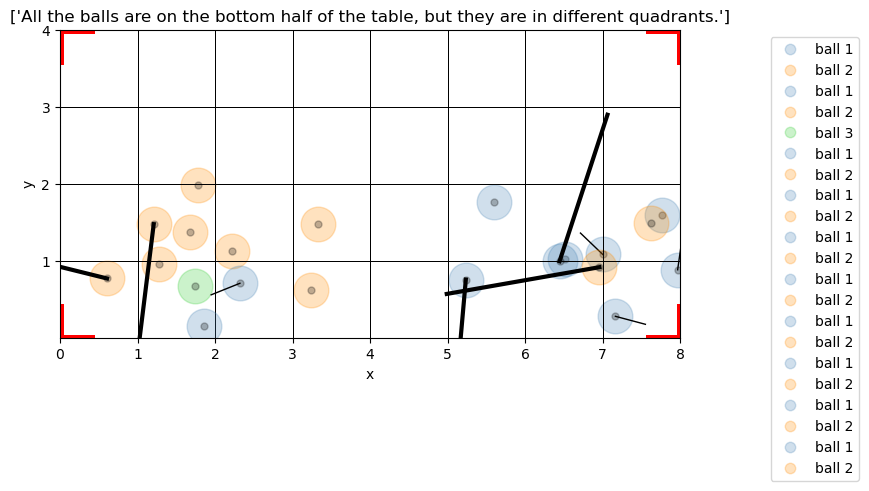

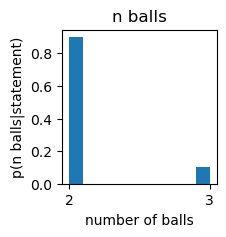

  0.774172 seconds (725.42 k allocations: 38.875 MiB, 2.45% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [334]:
reference_statements = ["All the balls are on the bottom half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the top half of the table."]
All the balls are on the top half of the table.
----------------
-5.9110888945337505
-6.174941171890596
-6.244481103459419
-6.36830293378971
-6.098483216177208
-6.436857689168887
-5.513868958484324
-6.612481247152434
-5.73958910899469
-5.731675097203814


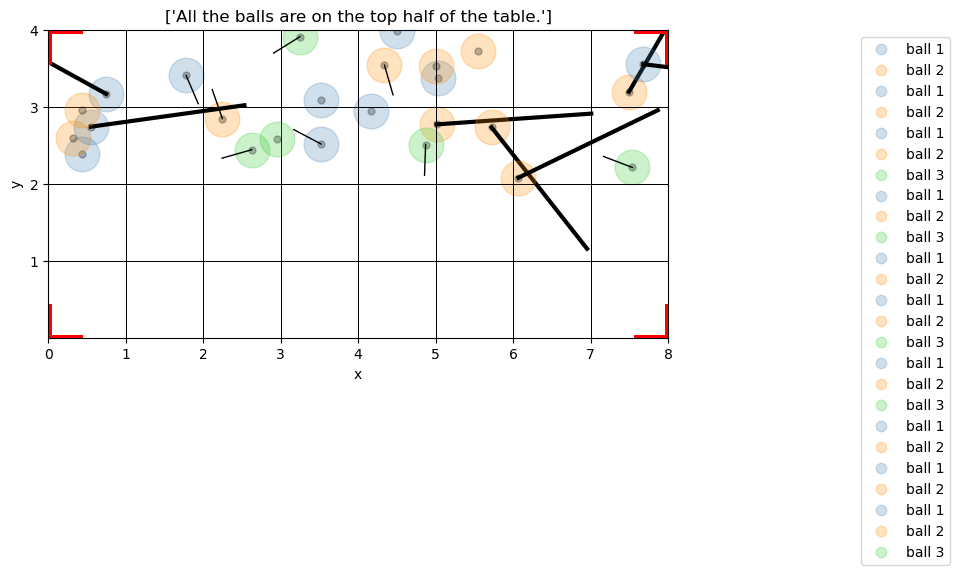

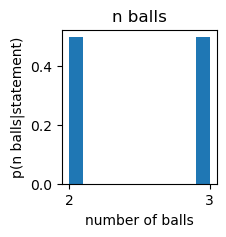

  1.297729 seconds (253.82 k allocations: 16.162 MiB, 21.54% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [336]:
reference_statements = ["All the balls are on the top half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the top half of the table, and they are in the same quadrant."]
All the balls are on the top half of the table, and they are in the same quadrant.
----------------
-7.408530566894626
-6.9873171018183236
-6.842135091973825
-6.703548928687678
-6.309918278226517
-6.828712071641684
-7.680464282378269
-6.309918278226517
-6.703548928687678
-6.715383386334682
  

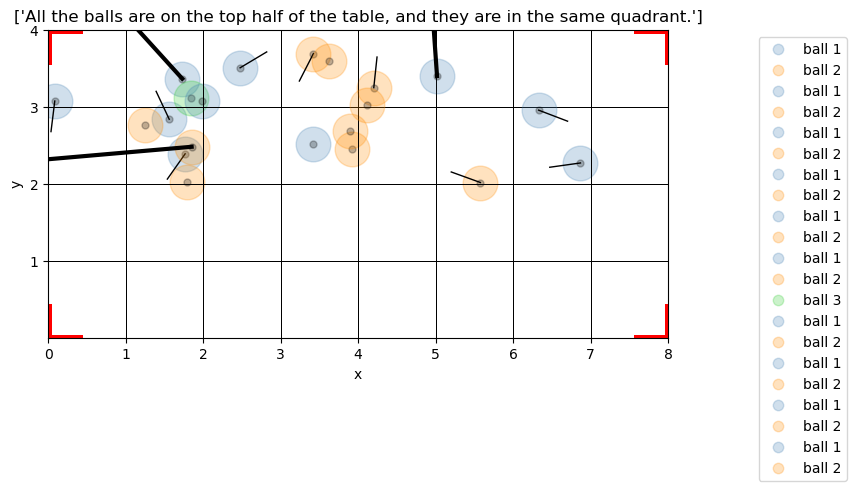

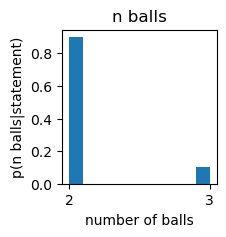

0.308715 seconds (257.86 k allocations: 16.529 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [340]:
reference_statements = ["All the balls are on the top half of the table, and they are in the same quadrant."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the top left quadrant of the table."]
All the balls are in the top left quadrant of the table.
----------------
-8.748304912379623
-5.95881437933724
-8.05515773181968
-Inf
-6.022236205774736
-6.22621925934987
-6.592323293577454
-6.715383386334681
-8.748304912379623
-7.1759082716258735


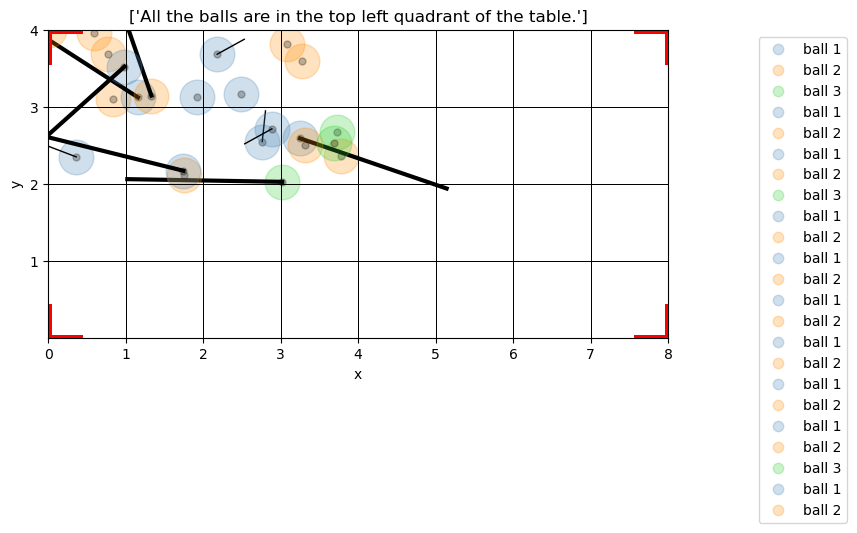

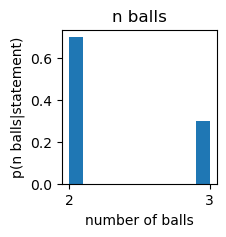

  0.678154 seconds (482.17 k allocations: 31.176 MiB, 2.17% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [341]:
reference_statements = ["All the balls are in the top left quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in the top right quadrant of the table."]
All the balls are in the top right quadrant of the table.
----------------
-6.715383386334681
-6.309918278226517
-Inf
-8.748304912379623
-6.309918278226517
-6.715383386334681
-6.715383386334681
-Inf
-6.592323293577454
-Inf
  

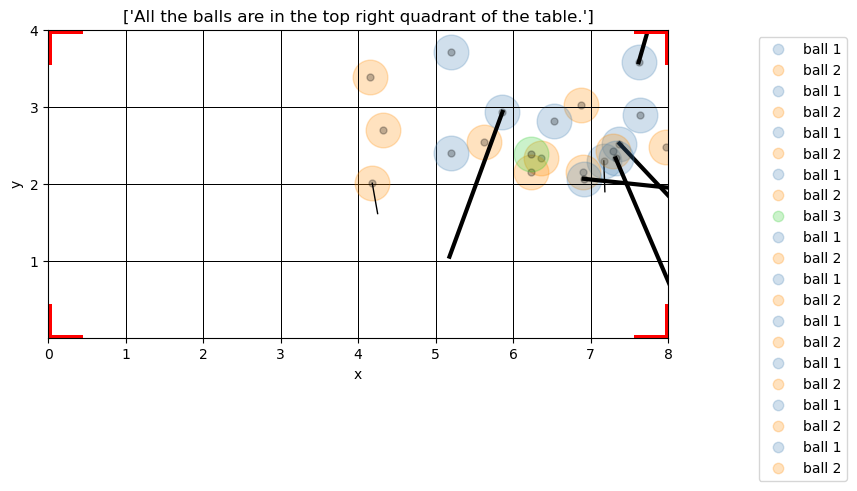

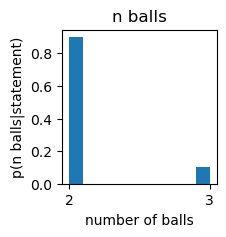

0.381617 seconds (950.88 k allocations: 62.101 MiB, 6.52% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [343]:
reference_statements = ["All the balls are in the top right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the top half of the table, but they are in different quadrants."]
All the balls are on the top half of the table, but they are in different quadrants.
----------------
-7.377758908227873
-5.4918122239401175
-5.861411418859785
-6.266876526967949
-5.370290866173126
-6.0196354240746786
-5.937397325837707
-5.395481115001685
-5.395481115001685
-6.383136333083811
  

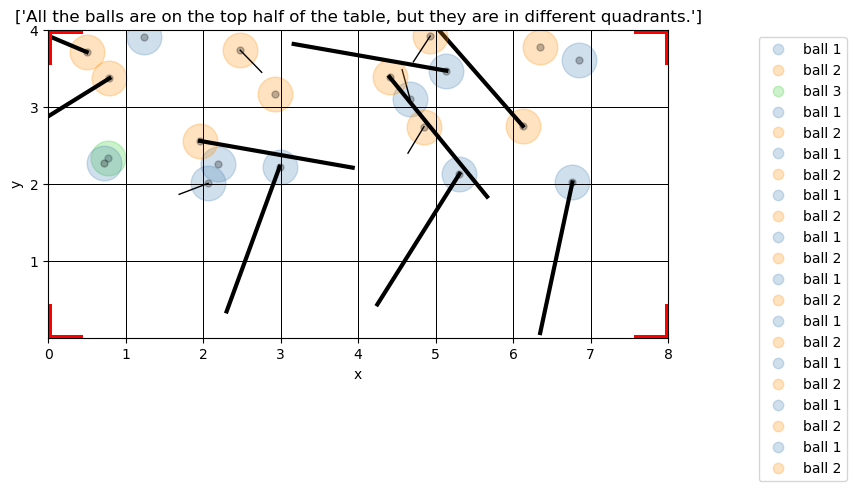

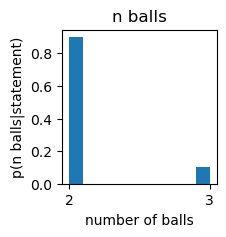

0.639877 seconds (257.99 k allocations: 16.535 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [344]:
reference_statements = ["All the balls are on the top half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on opposite halves (top/bottom) of the table."]
All the balls are on opposite halves (top/bottom) of the table.
----------------
-4.915325114291932
-5.5592012458450935
-5.2282386650348505
-5.389783093887047
-5.039949681765031
-5.288000399577105
-5.233778845410466
-5.2282386650348505
-5.146073264991361
-5.668844423294921


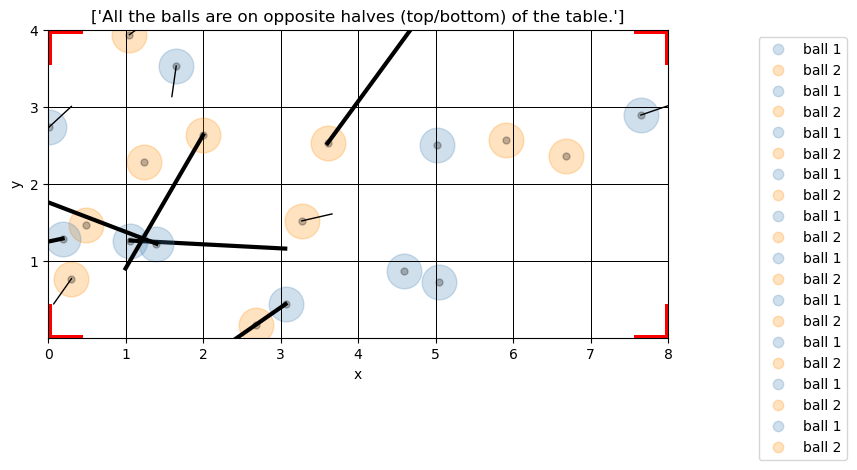

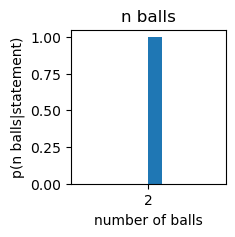

  0.336800 seconds (250.18 k allocations: 15.886 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [345]:
reference_statements = ["All the balls are on opposite halves (top/bottom) of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the same half (left/right) of the table, but they are in different quadrants."]
All the balls are on the same half (left/right) of the table, but they are in different quadrants.
----------------
-6.212926012239207
-6.1092475827643655
-6.043289614972569
-5.9550969029371075
-5.844555028537283
-5.9550969029371075
-5.844555028537283
-6.29156913955832
-6.674561391814427
-5.724191346287409
  

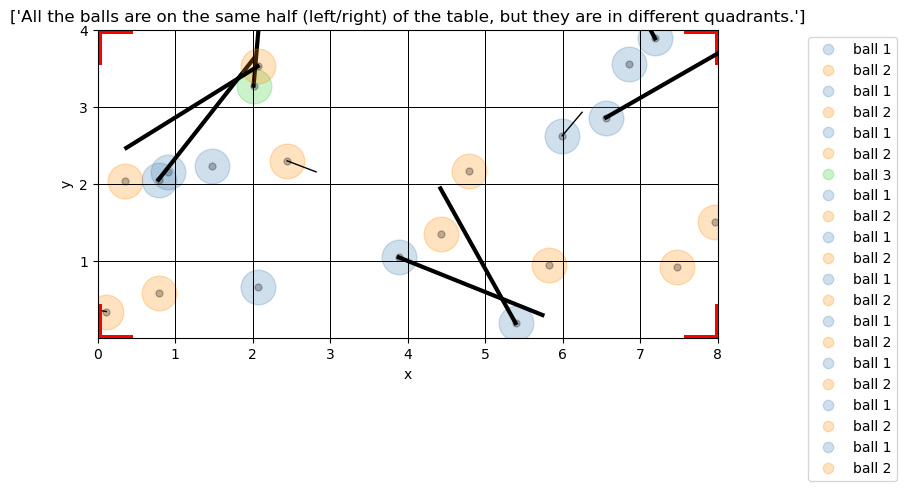

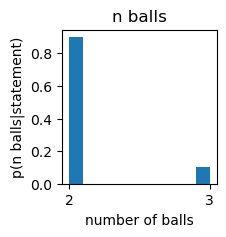

0.318292 seconds (255.20 k allocations: 16.307 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [349]:
reference_statements = ["All the balls are on the same half (left/right) of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the left half of the table, but they are in different quadrants."]
All the balls are on the left half of the table, but they are in different quadrants.
----------------
-6.51471269087253
-6.802394763324311
-6.1092475827643655
-6.043289614972569
-6.7293696283094215
-7.901007051992421
-6.674561391814427
-7.901007051992421
-6.51471269087253
-6.417338526847354


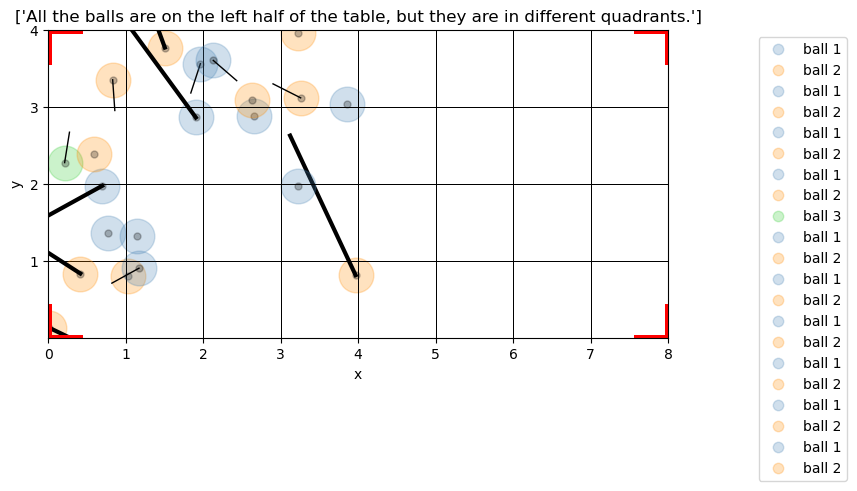

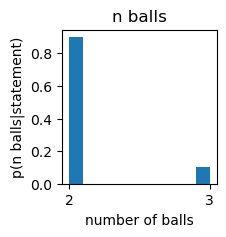

  0.319054 seconds (256.01 k allocations: 16.393 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [352]:
reference_statements = ["All the balls are on the left half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the right half of the table, but they are in different quadrants."]
All the balls are on the right half of the table, but they are in different quadrants.
----------------
-5.9550969029371075
-7.558062300865591
-6.802394763324311
-6.140019241431119
-6.1092475827643655
-6.802394763324311
-6.328610411238669
-7.2078598714324755
-6.802394763324311
-7.2078598714324755
  

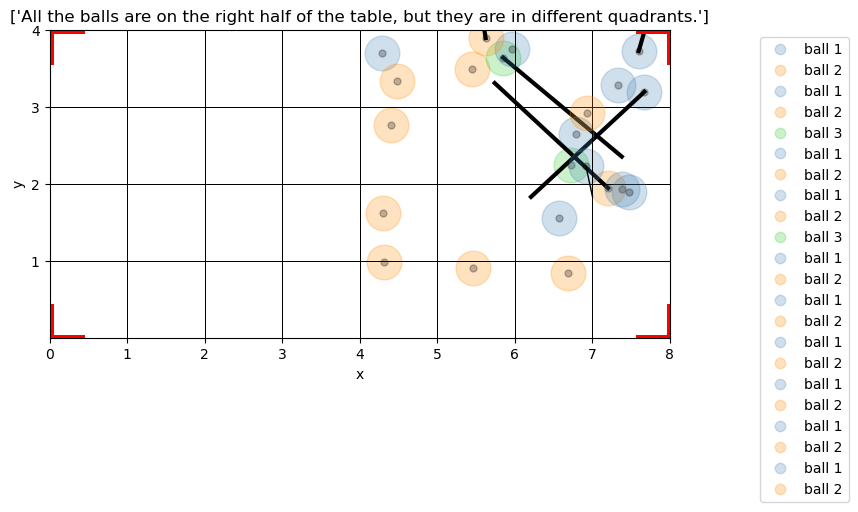

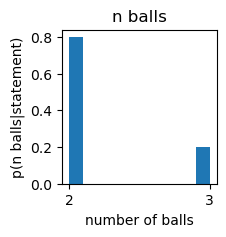

0.304787 seconds (259.53 k allocations: 16.668 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [356]:
reference_statements = ["All the balls are on the right half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in opposite corner quadrants."]
All the balls are in opposite corner quadrants.
----------------
-5.454909435403642
-5.6795219480860535
-5.0855476272529385
-5.881543020122593
-5.174318443374971
-5.375507005239166
-6.004293743194644
-5.410784884304741
-5.751787878956921
-5.527571989456565


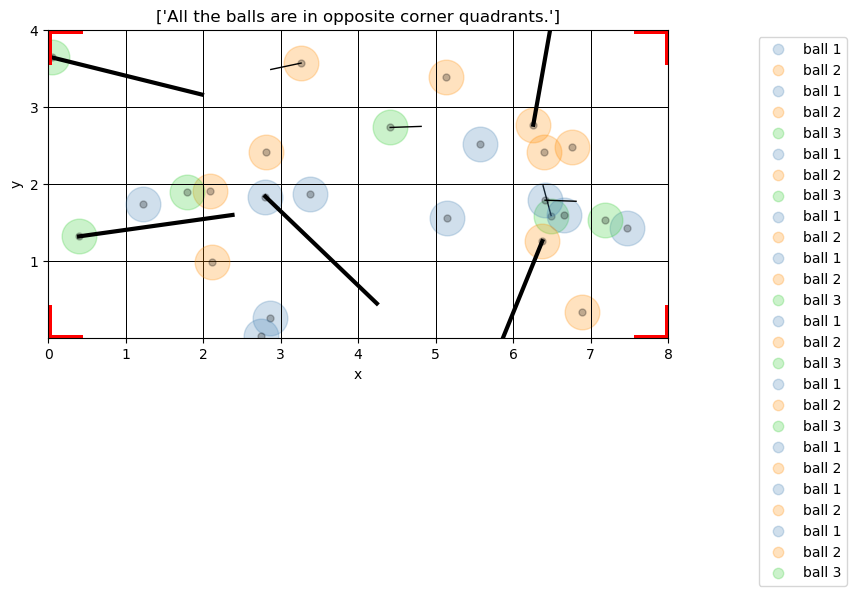

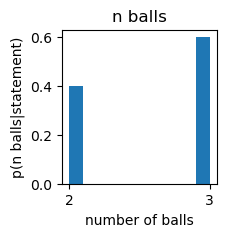

  1.122102 seconds (255.92 k allocations: 16.310 MiB, 1.50% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [390]:
reference_statements = ["All the balls are in opposite corner quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in opposite corner quadrants: bottom left and top right."]
All the balls are in opposite corner quadrants: bottom left and top right.
----------------
-5.881543020122594
-5.90922644887101
-6.492811426919429
-6.870367746910517
-5.851288611764791
-6.141180629867375
-6.3912316341015085
-6.870367746910517
-5.771755458242407
-6.258410721080585
-7.649692623711514
-6.3912316341015085
-6.492811426919429
-6.7995416943419045
-6.437751649736402
-6.258410721080585
-7.03992705209062
-6.7995416943419045
-5.825143331660469
-6.5444357923247365
-6.663875829188749
-6.3912316341015085
-6.7995416943419045
-7.649692623711514
-6.5444357923247365
-5.851288611764791
-6.6058885715384
-6.102130114995502
-5.851288611764791
-6.870367746910517
-6.214608098422192
-6.102130114995502
-5.698084453541564
-6.443721816722905
-6.870367746910517
-6.5444357923247365
-6.102130114995502
-5.7475850973145945
-6.5444357923247365
-6.141180629867375
-6.141180629867375
-6.605888571538401
-6.663875829188749
-6.14

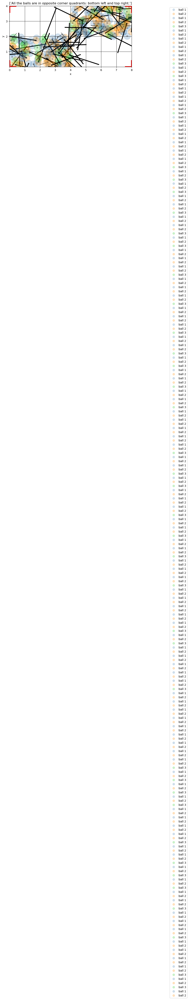

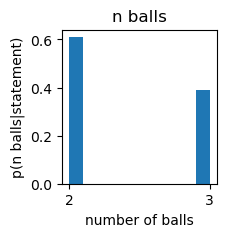

26.818310 seconds (3.02 M allocations: 210.223 MiB, 2.74% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [23]:
reference_statements = ["All the balls are in opposite corner quadrants: bottom left and top right."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 100, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are in opposite corner quadrants: top left and bottom right."]
All the balls are in opposite corner quadrants: top left and bottom right.
----------------
-6.102130114995502
-6.5444357923247365
-6.492811426919429
-6.725433722188183
-5.970728648628804
-5.970728648628804
-7.03992705209062
-6.0686541857991125
-5.851288611764791
-6.068654185799112
  

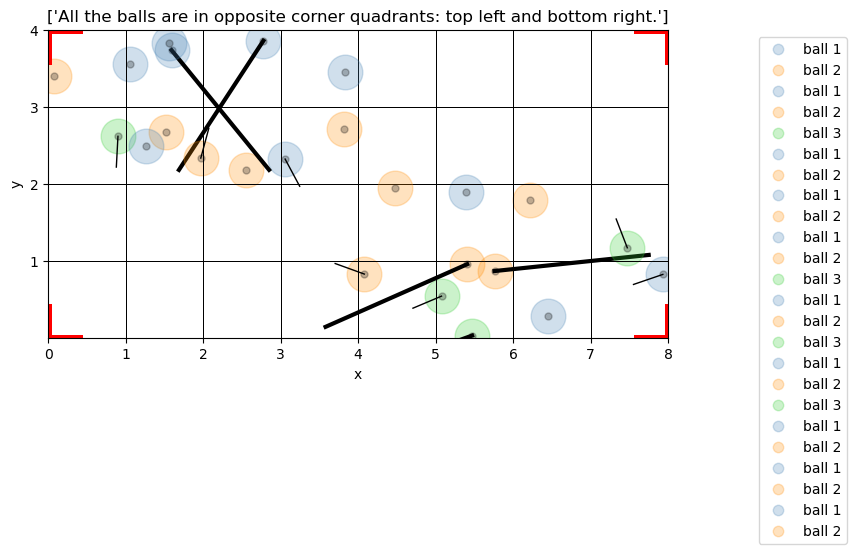

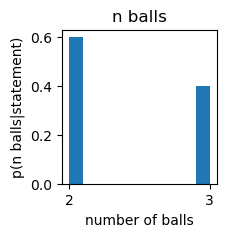

0.340929 seconds (257.45 k allocations: 16.492 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [402]:
reference_statements = ["All the balls are in opposite corner quadrants: top left and bottom right."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the same half (left/right) of the table."]
All the balls are on the same half (left/right) of the table.
----------------
-5.4313678743352085
-5.515585953419226
-5.627903689111238
-5.763035617529297
-5.338797839341752
-5.507252571860081
-5.4100253486301195
-5.093224793549179
-5.632596138810968
-5.097646671085886


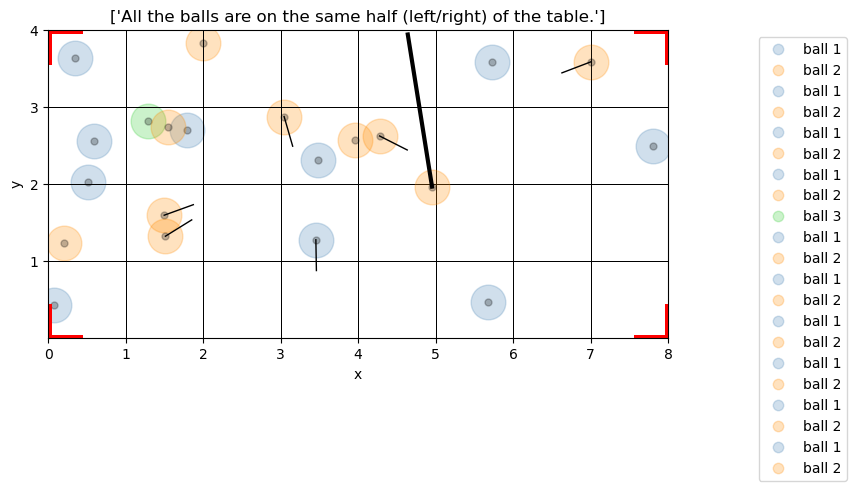

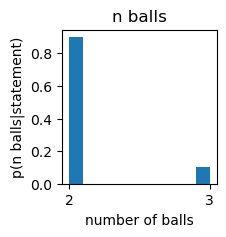

  0.825092 seconds (783.64 k allocations: 41.826 MiB, 1.50% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [408]:
reference_statements = ["All the balls are on the same half (left/right) of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the left half of the table."]
All the balls are on the left half of the table.
----------------
-6.207896663834205
-5.7641546030992465
-6.168547325045657
-6.0306044554452525
-6.41117201193169
-6.282440967897984
-5.793552474084911
-6.136899114094875
-5.611230917290957
-6.280719123534254
  

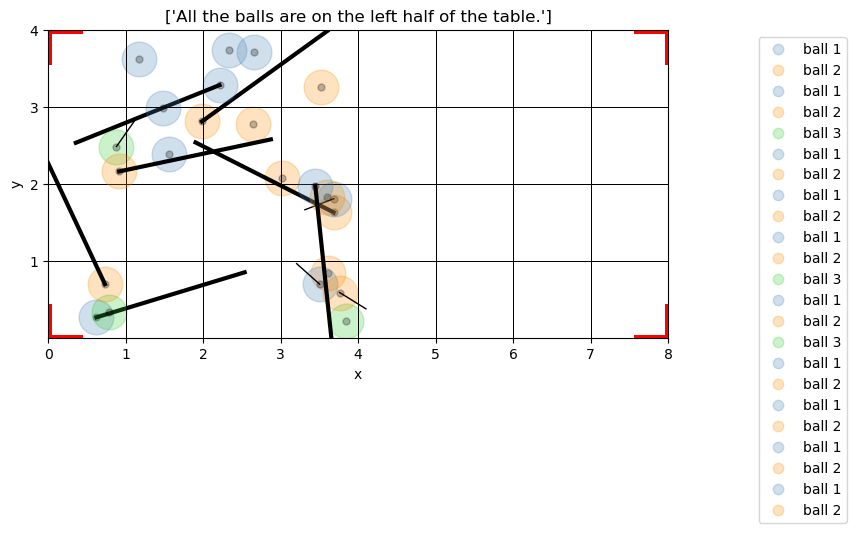

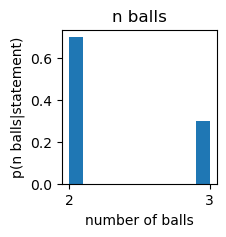

1.251769 seconds (774.07 k allocations: 41.035 MiB, 1.07% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [411]:

reference_statements = ["All the balls are on the left half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the right half of the table."]
All the balls are on the right half of the table.
----------------
-5.860968058178614
-5.55306323544027
-6.004341715898185
-5.860968058178614
-6.0029783891703214
-5.58757194297431
-6.104646851678429
-5.943420560556463
-6.510177535707139
-6.457301783659191


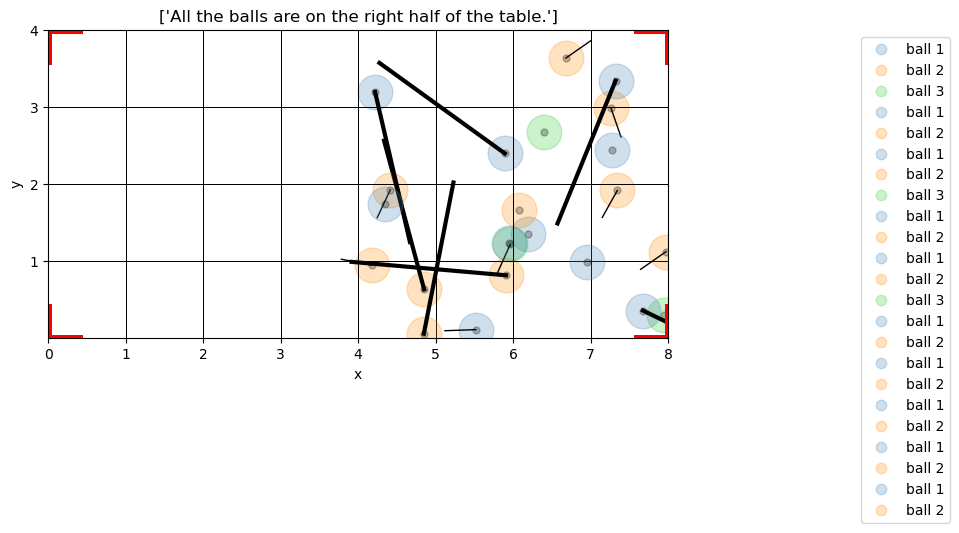

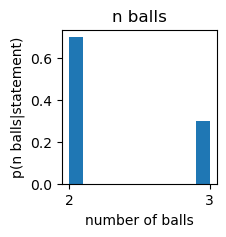

  0.349253 seconds (256.88 k allocations: 16.403 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [412]:
reference_statements = ["All the balls are on the right half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on opposite halves (right/left) of the table."]
All the balls are on opposite halves (right/left) of the table.
----------------
-5.536386568078923
-5.396297774908241
-5.446559609689129
-5.370489890952368
-5.370489890952368
-5.45345618874819
-5.566923291939005
-5.660297362716463
-5.668844423294921
-5.233778845410466


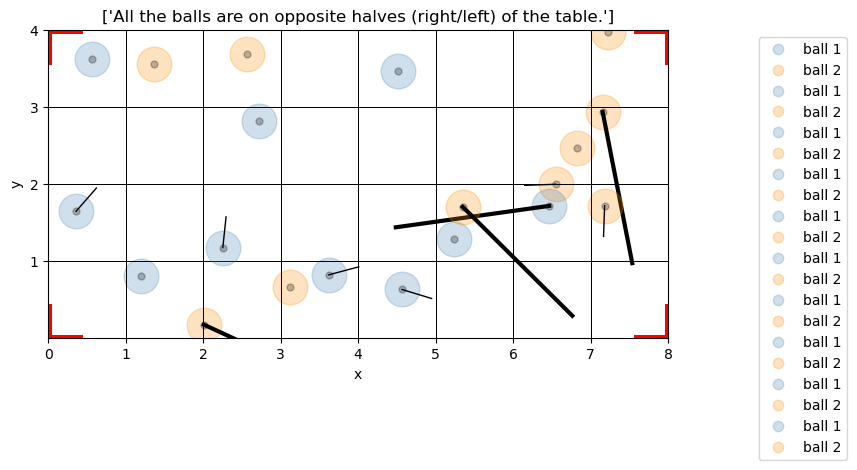

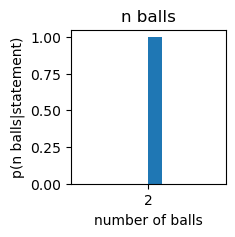

  0.298081 seconds (260.79 k allocations: 16.777 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [417]:
reference_statements = ["All the balls are on opposite halves (right/left) of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the same half (top/bottom) of the table."]
There are two balls on the same half (top/bottom) of the table.
----------------
-4.502125581183325
-4.178140917281572
-4.456557548256521
-4.172652282257454
-4.310128004328849
-4.449147527457888
-4.39806927633942
-4.5004010960423875
-4.269161800200896
-4.399233248055227


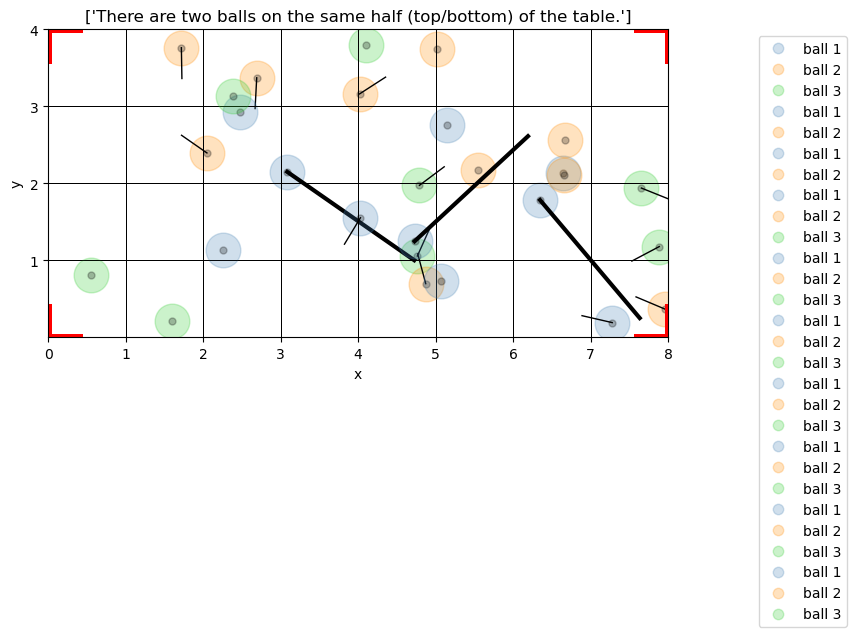

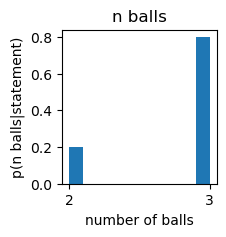

  0.439936 seconds (258.66 k allocations: 16.490 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [419]:
reference_statements = ["There are two balls on the same half (top/bottom) of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the bottom half of the table."]
There are two balls on the bottom half of the table.
----------------
-5.084509682115055
-4.867368171022376
-5.044897333740995
-4.833579421605914
-5.467201098430951
-5.215789011326685
-5.256602628695948
-5.161065939232059
-4.9638194508293125
-5.265808711288983
  

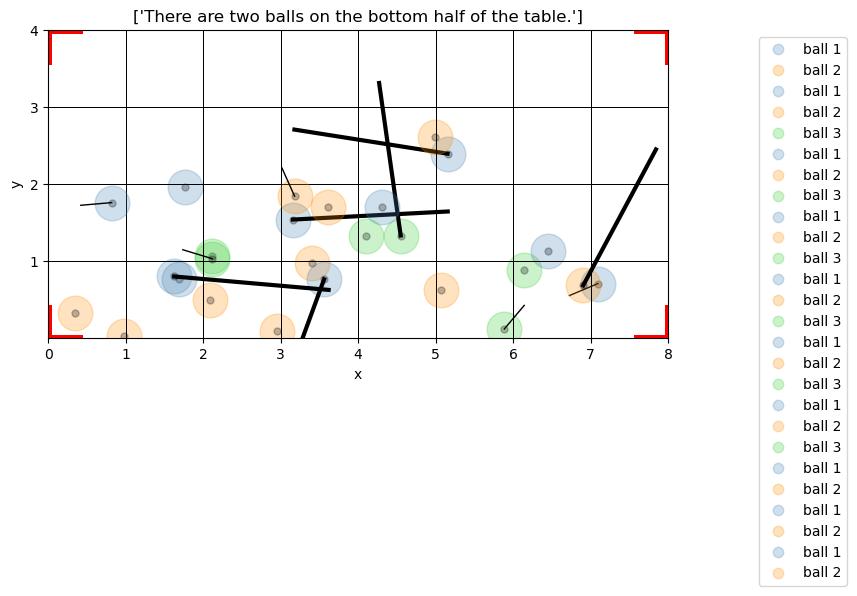

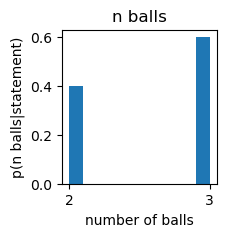

0.845989 seconds (255.34 k allocations: 16.253 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [420]:
reference_statements = ["There are two balls on the bottom half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the bottom half of the table, and they are in the same quadrant."]
There are two balls on the bottom half of the table, and they are in the same quadrant.
----------------
-5.742566053929191
-5.984848673703116
-5.750075758627046
-5.699408935652778
-5.7456083097967365
-5.568547987666006
-5.648980731688782
-6.057138874164118
-5.625439512430142
-6.37742416059189


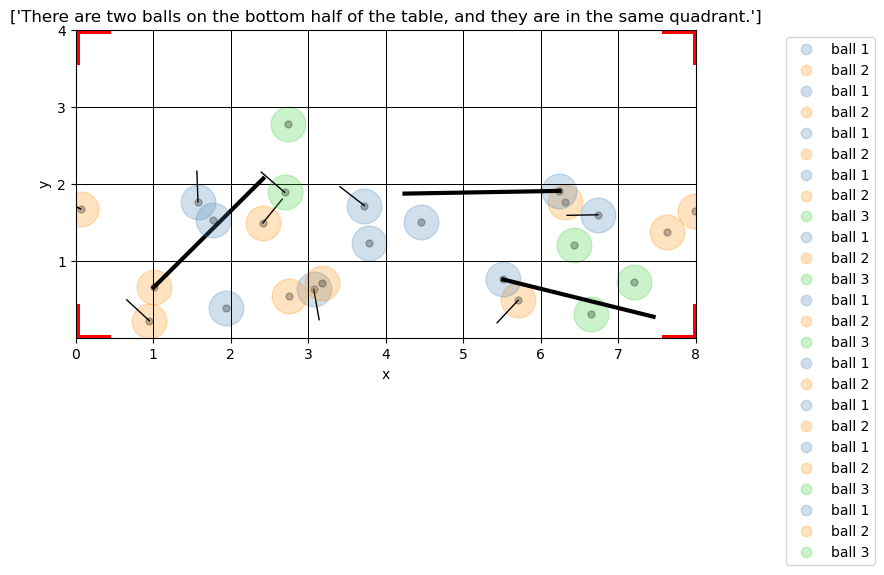

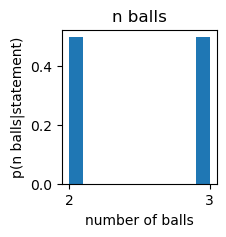

  0.831900 seconds (258.84 k allocations: 16.570 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [428]:
reference_statements = ["There are two balls on the bottom half of the table, and they are in the same quadrant."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in the bottom left quadrant of the table."]
There are two balls in the bottom left quadrant of the table.
----------------
-5.405724226585319
-6.471037627369869
-5.388561037731083
-5.903461598396057
-6.319988655967564
-6.069075149812907
-5.29572333137099
-7.377758908227873
-6.472320501182757
-6.210468051108424


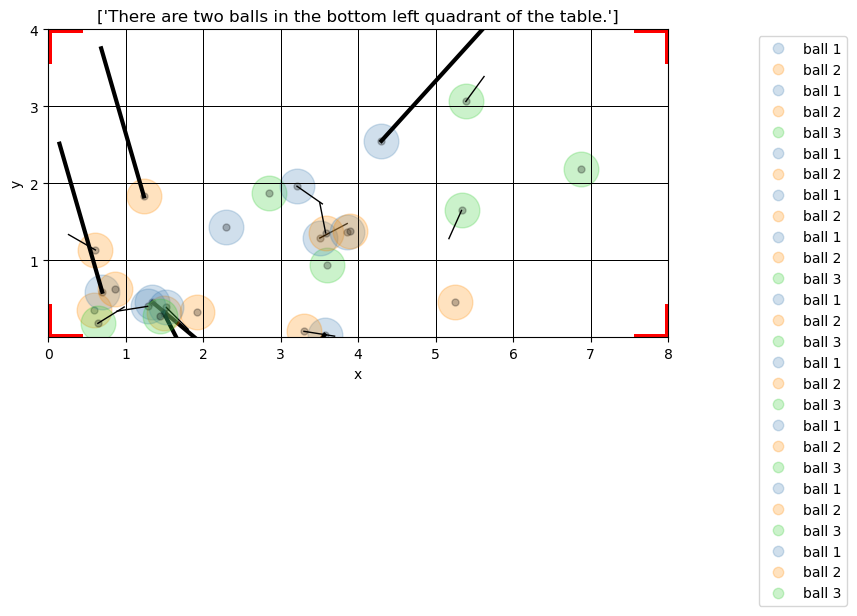

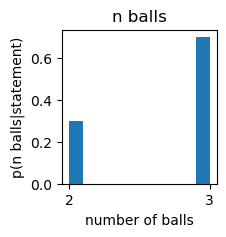

  0.454422 seconds (254.58 k allocations: 16.192 MiB, 2.55% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [433]:
reference_statements = ["There are two balls in the bottom left quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in the bottom right quadrant of the table."]
There are two balls in the bottom right quadrant of the table.
----------------
-6.002346047295516
-5.869361850307083
-5.820510871834108
-5.729044784125062
-6.120019679746277
-6.042226350651238
-5.11659724117896
-6.119445509201856
-6.419919173440846
-6.042226350651238
  

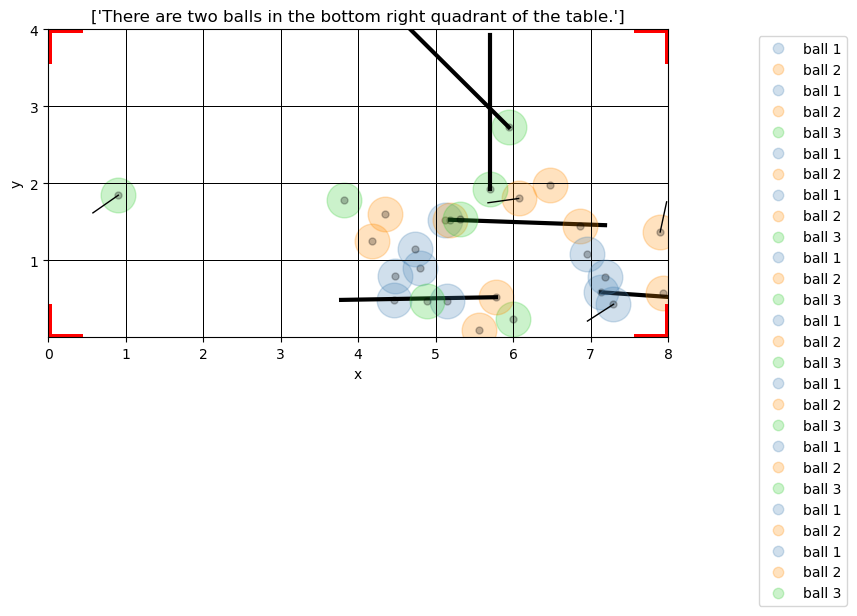

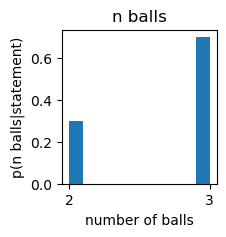

0.851721 seconds (257.74 k allocations: 16.444 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [434]:
reference_statements = ["There are two balls in the bottom right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the bottom half of the table, but they are in different quadrants."]
There are two balls on the bottom half of the table, but they are in different quadrants.
----------------
-6.359622602803336
-5.631189852237259
-5.4753895674558475
-5.72222637631546
-5.79398874254235
-5.744817698535901
-5.513331285027534
-5.432127271916318
-5.740258420121383
-5.605685114070848


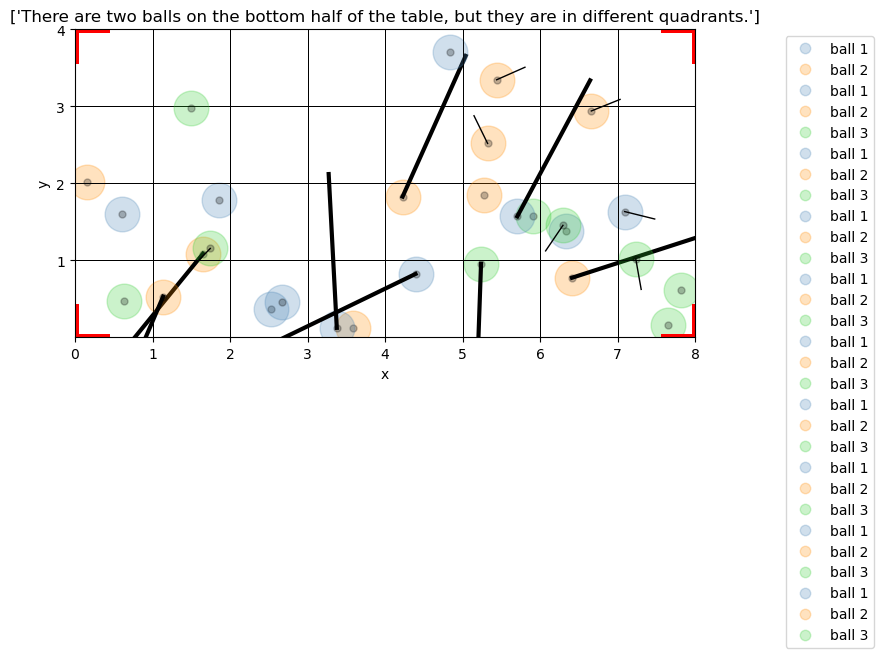

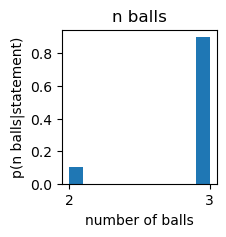

  0.518567 seconds (259.35 k allocations: 16.566 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [438]:
reference_statements = ["There are two balls on the bottom half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the top half of the table."]
There are two balls on the top half of the table.
----------------
-Inf
-5.598421958998375
-4.770962440830836
-5.0751738152338275
-5.940171252720432
-4.679861078589681
-4.609810565544594
-4.875211753319695
-4.752400422970776
-4.7154060160090925
  

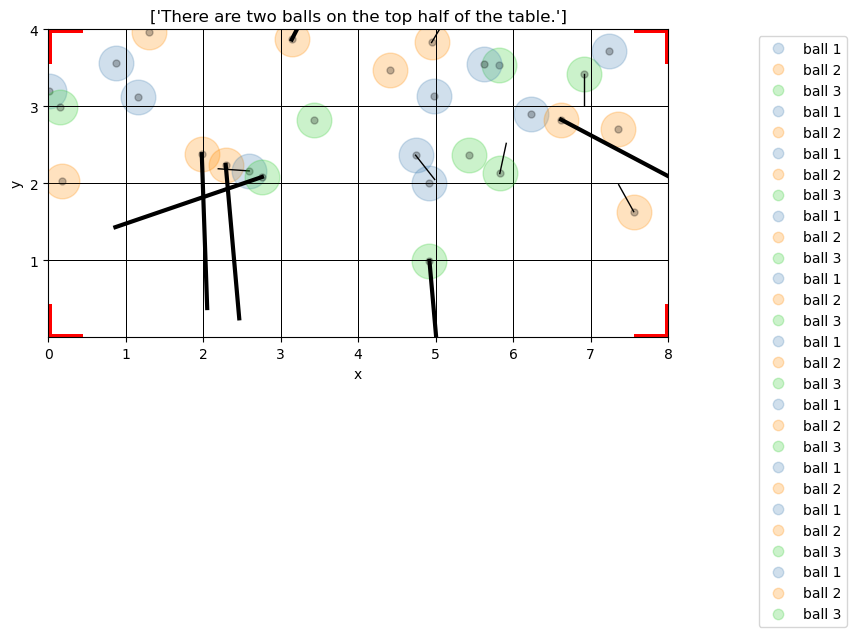

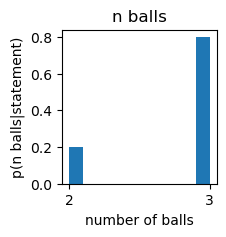

0.427654 seconds (74.50 k allocations: 4.408 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [444]:
reference_statements = ["There are two balls on the top half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the top half of the table, and they are in the same quadrant."]
There are two balls on the top half of the table, and they are in the same quadrant.
----------------
-Inf
-5.001361657310927
-Inf
-6.040254711277415
-Inf
-5.219274159207584
-Inf
-6.1737861039019375
-6.1737861039019375
-Inf


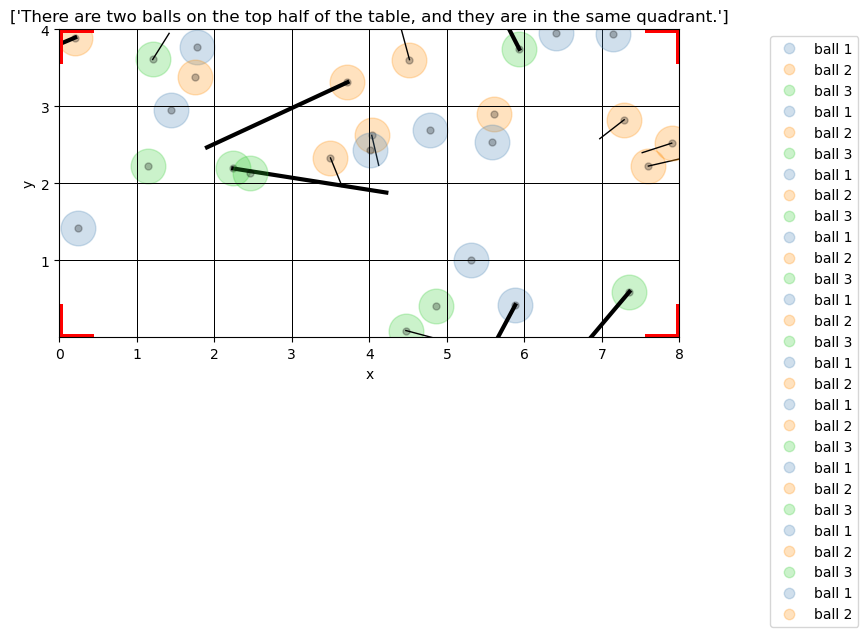

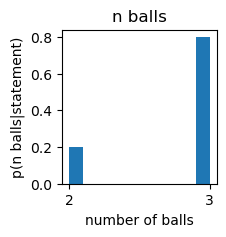

  0.907075 seconds (161.73 k allocations: 10.337 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [450]:
reference_statements = ["There are two balls on the top half of the table, and they are in the same quadrant."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in the top left quadrant of the table."]
There are two balls in the top left quadrant of the table.
----------------
-Inf
-Inf
-Inf
-5.347107530717469
-Inf
-Inf
-Inf
-Inf
-5.347107530717469
-Inf


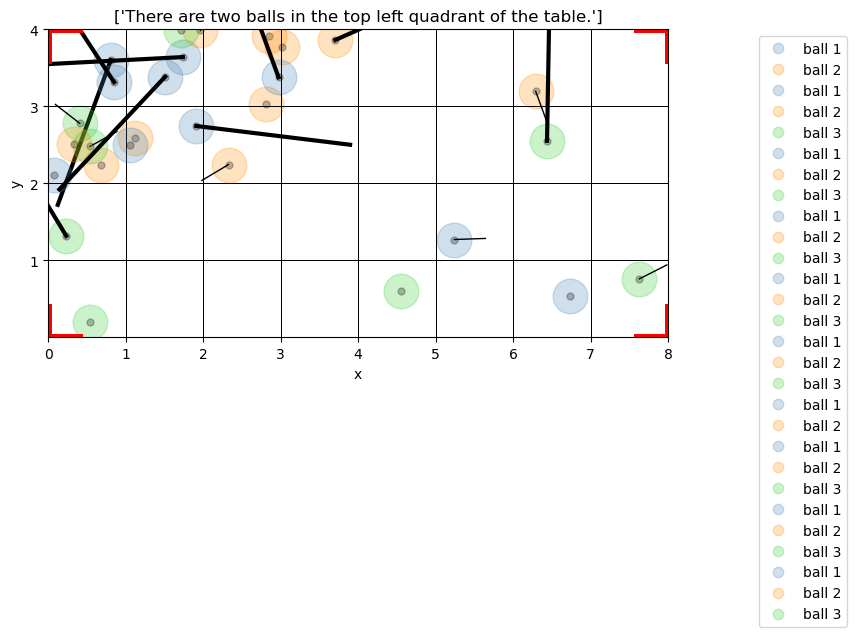

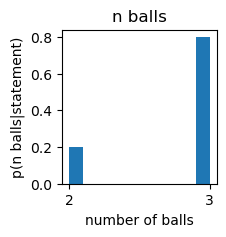

  0.428126 seconds (259.51 k allocations: 16.559 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [451]:
reference_statements = ["There are two balls in the top left quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in the top right quadrant of the table."]
There are two balls in the top right quadrant of the table.
----------------
-Inf
-Inf
-Inf
-5.347107530717469
-Inf
-5.105945473900581
-Inf
-Inf
-Inf
-Inf


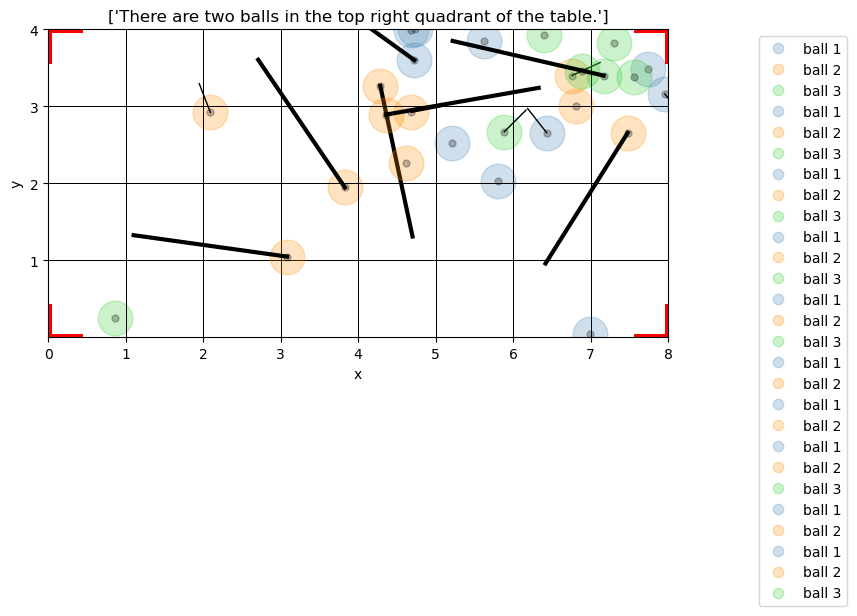

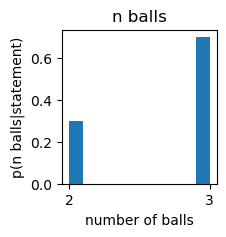

  0.675394 seconds (230.80 k allocations: 14.598 MiB, 25.32% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [453]:
reference_statements = ["There are two balls in the top right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the top half of the table, but they are in different quadrants."]
There are two balls on the top half of the table, but they are in different quadrants.
----------------
-5.940171252720432
-5.247024072160486
-Inf
-Inf
-5.940171252720432
-4.513054897080286
-5.247024072160486
-Inf
-Inf
-5.480638923341992
  

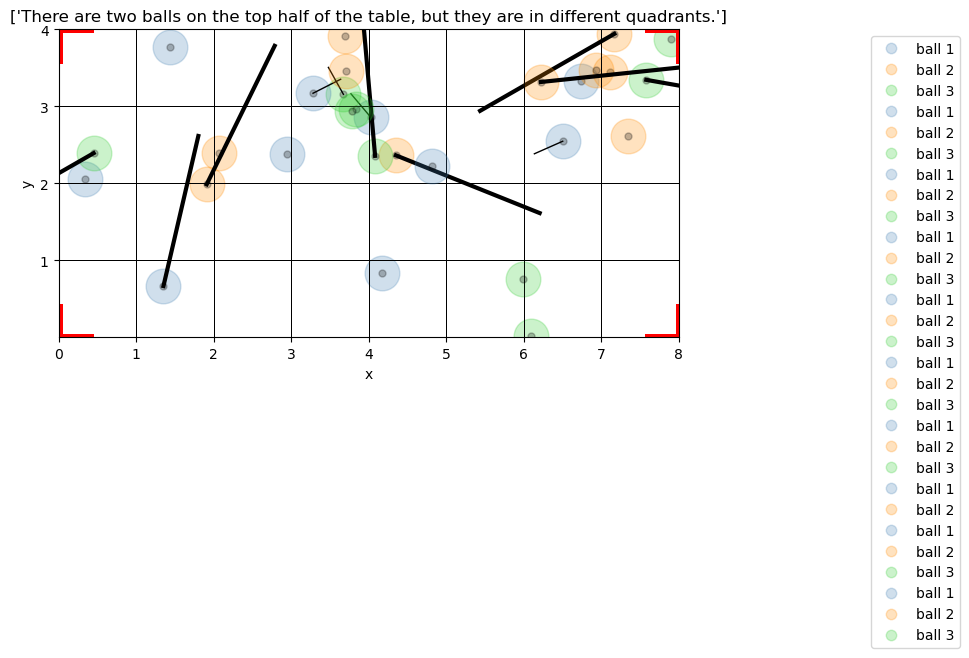

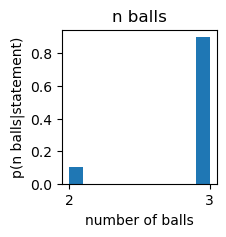

1.201203 seconds (142.28 k allocations: 8.844 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [454]:
reference_statements = ["There are two balls on the top half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on opposite halves (top/bottom) of the table."]
There are two balls on opposite halves (top/bottom) of the table.
----------------
-4.345358283840088
-4.602667055769973
-4.05390359266359
-4.361290736194704
-4.2317933924314275
-4.252401497016424
-5.247024072160486
-4.148411783492376
-4.90527477843843
-5.521460917862246


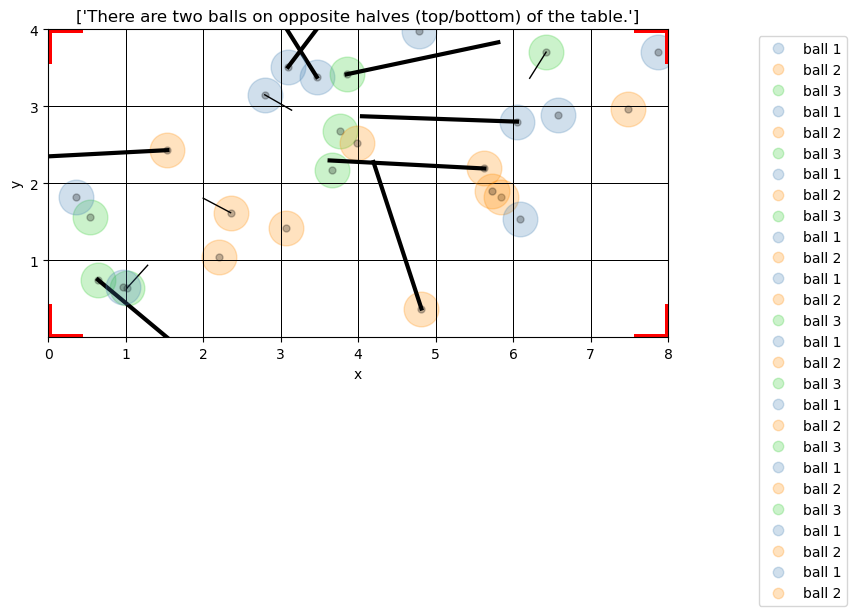

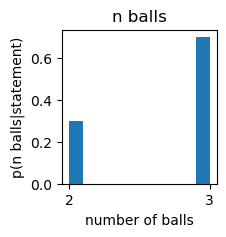

  0.371337 seconds (49.10 k allocations: 2.724 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [456]:
reference_statements = ["There are two balls on opposite halves (top/bottom) of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the same half (left/right) of the table, but they are in different quadrants."]
There are two balls on the same half (left/right) of the table, but they are in different quadrants.
----------------
-Inf
-4.31748811353631
-4.809964598634105
-4.201656298011189
-Inf
-Inf
-4.163337433709052
-4.951043196894011
-4.951043196894011
-5.598421958998375


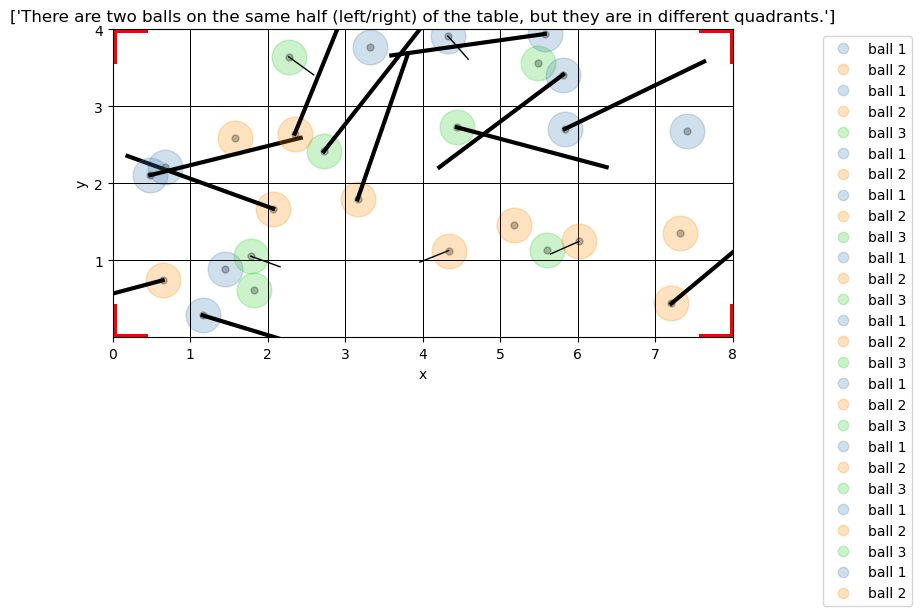

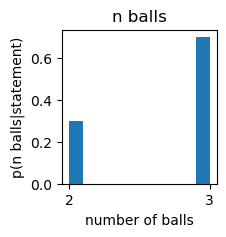

  0.563268 seconds (119.82 k allocations: 7.370 MiB, 19.47% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [464]:
reference_statements = ["There are two balls on the same half (left/right) of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the left half of the table, but they are in different quadrants."]
There are two balls on the left half of the table, but they are in different quadrants.
----------------
-4.951043196894011
-5.41610040220442
-Inf
-5.940171252720432
-Inf
-4.530088029636526
-5.940171252720432
-Inf
-5.598421958998375
-5.061620848829124
  

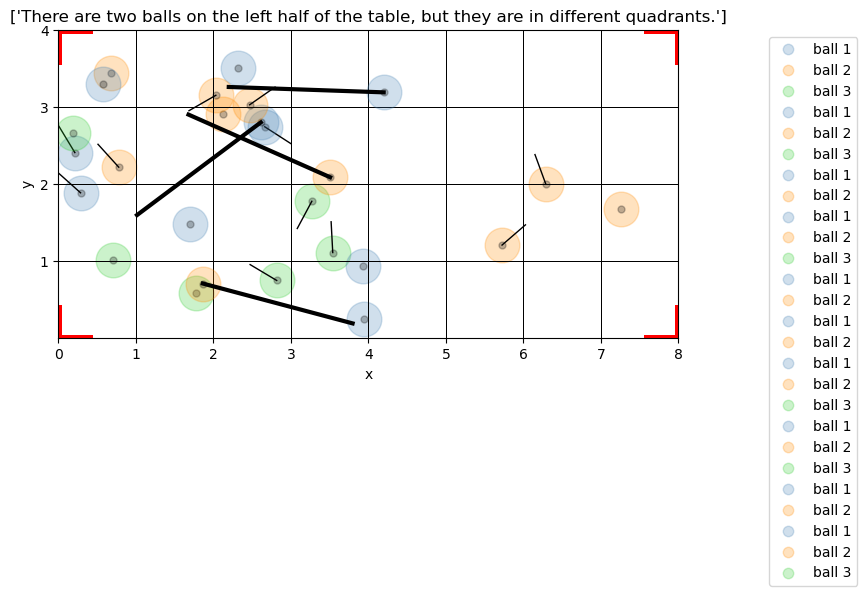

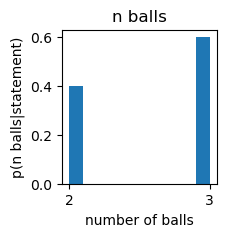

0.465116 seconds (120.01 k allocations: 7.408 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [465]:
reference_statements = ["There are two balls on the left half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the right half of the table, but they are in different quadrants."]
There are two balls on the right half of the table, but they are in different quadrants.
----------------
-Inf
-5.41610040220442
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf
-4.951043196894011
-Inf
  

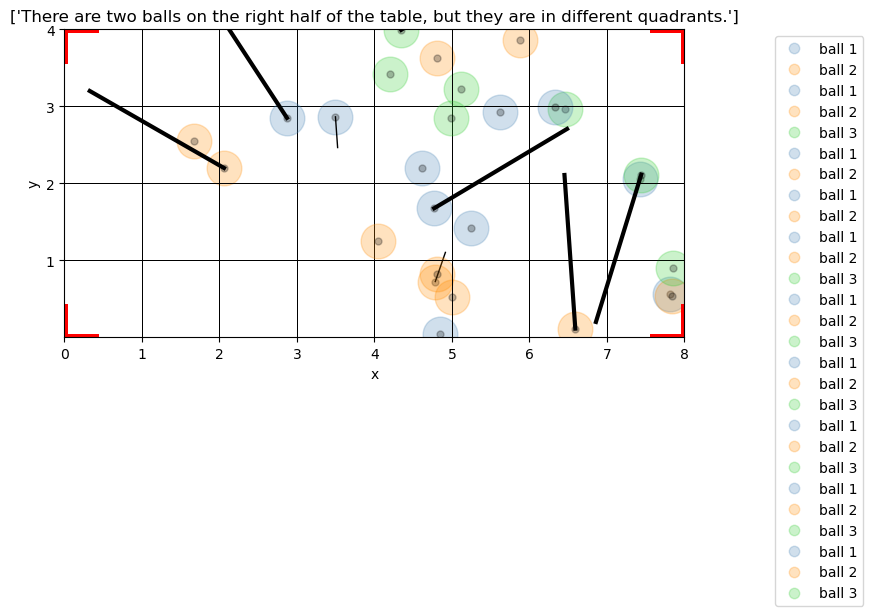

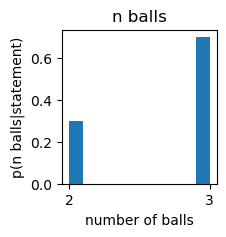

0.555265 seconds (228.71 k allocations: 14.455 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [466]:
reference_statements = ["There are two balls on the right half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls in opposite corner quadrants."]
There are two balls in opposite corner quadrants.
----------------
-5.521460917862246
-4.681710263110426
-4.681710263110426
-5.247024072160486
-4.21400906597819
-4.681710263110426
-4.474713691459512
-4.907156246538135
-4.841558964052322
-Inf
  

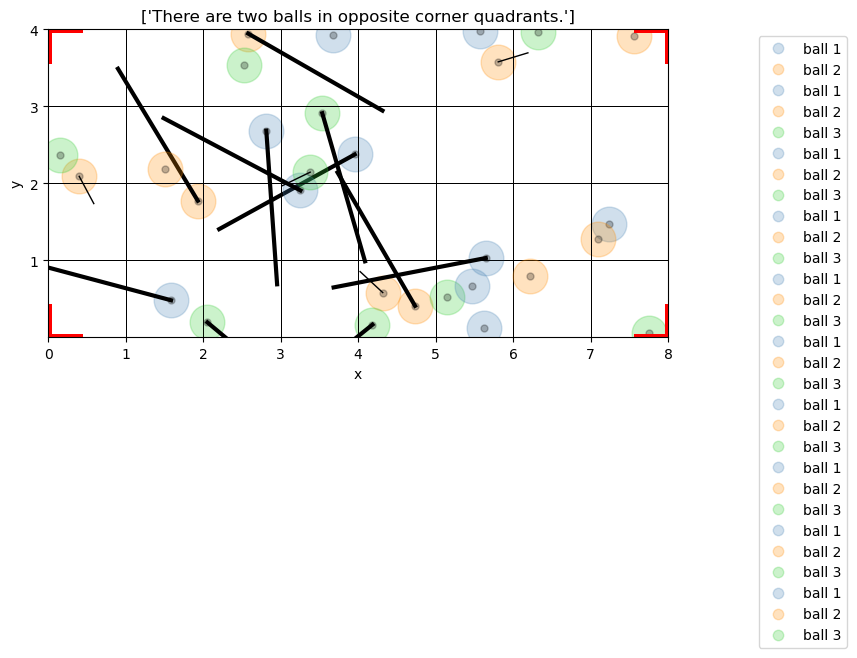

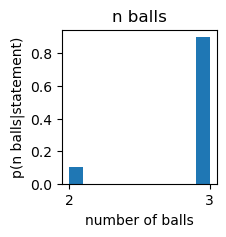

0.415671 seconds (77.67 k allocations: 4.653 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [471]:
reference_statements = ["There are two balls in opposite corner quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the same half (left/right) of the table."]
There are two balls on the same half (left/right) of the table.
----------------
-5.028653799598935
-4.243721963296702
-4.67792954027052
-4.010982623864606
-4.8606800054991
-4.1583374232923465
-4.174498665684991
-4.207875288139954
-4.568802541817217
-5.799092654460527


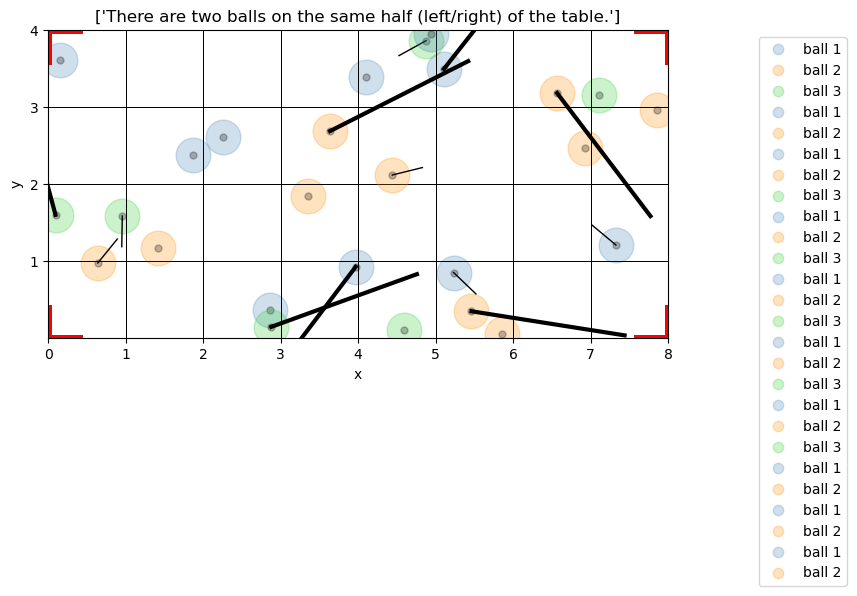

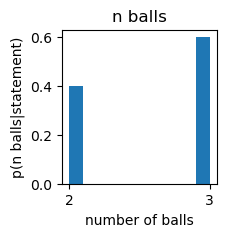

  0.402358 seconds (48.34 k allocations: 2.670 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [472]:
reference_statements = ["There are two balls on the same half (left/right) of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the left half of the table."]
There are two balls on the left half of the table.
----------------
-6.1737861039019375
-4.362120267557079
-4.194035669319465
-4.072365655503325
-Inf
-4.8606800054991
-5.940171252720432
-4.092008112561081
-5.101985072684484
-Inf
  

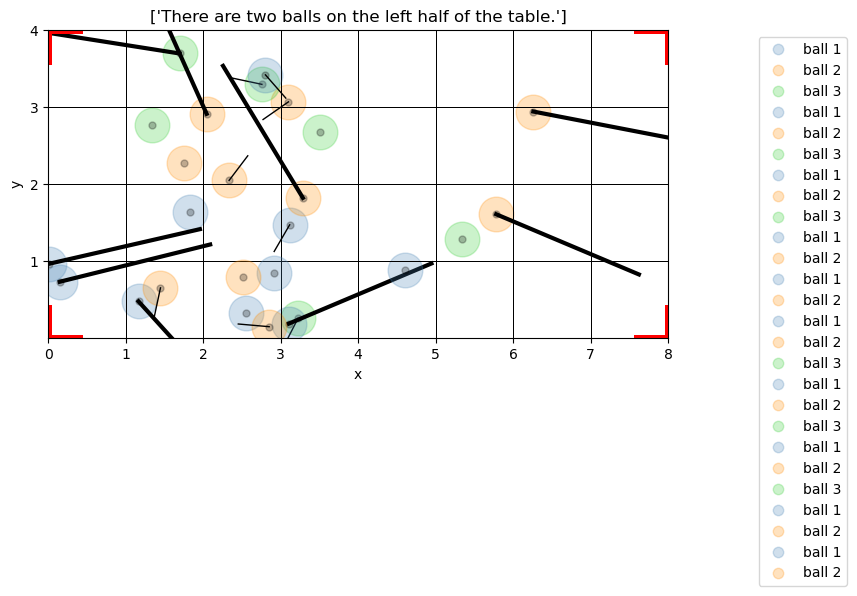

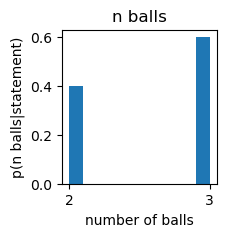

0.583087 seconds (97.65 k allocations: 5.944 MiB, 32.94% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [473]:
reference_statements = ["There are two balls on the left half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are two balls on the right half of the table."]
There are two balls on the right half of the table.
----------------
-4.544064679334306
-5.219274159207584
-5.940171252720432
-5.173998937145596
-5.061620848829124
-5.940171252720432
-Inf
-4.1583374232923465
-5.357024967374815
-Inf


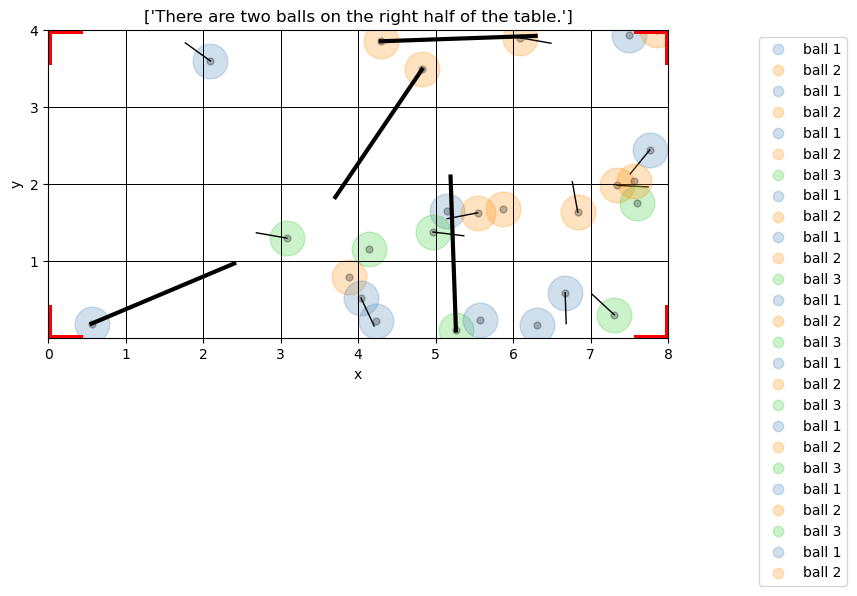

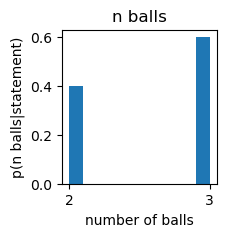

  1.182439 seconds (98.05 k allocations: 5.979 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [474]:
reference_statements = ["There are two balls on the right half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 2 balls on the top half of the table, but they are in different quadrants."]
There are 2 balls on the top half of the table, but they are in different quadrants.
----------------
-5.940171252720432
-5.940171252720432
-Inf
-Inf
-5.598421958998375
-5.247024072160486
-4.787491742782047
-5.598421958998375
-5.061620848829124
-Inf


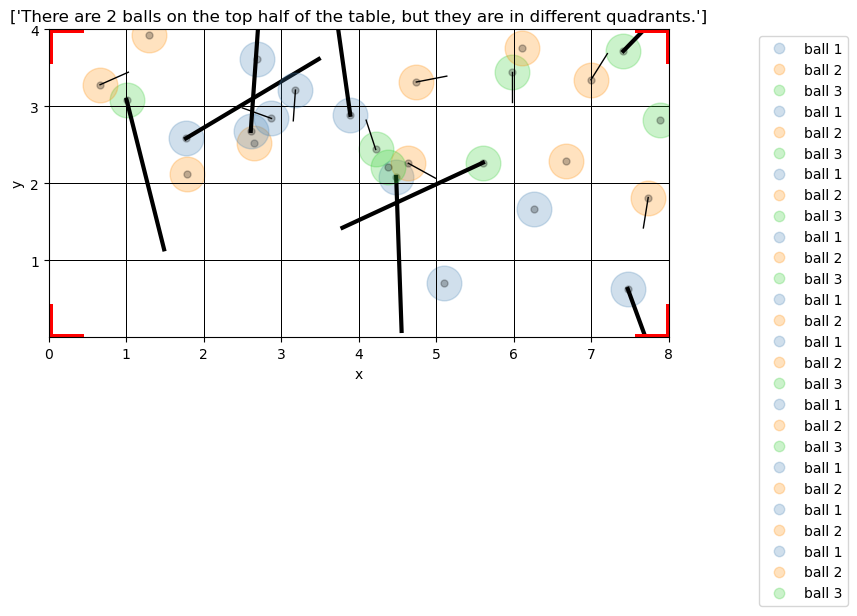

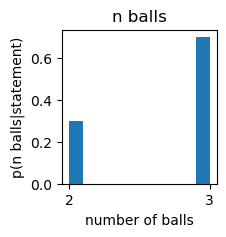

  2.392440 seconds (642.18 k allocations: 32.417 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [477]:
reference_statements = ["There are 2 balls on the top half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the top half of the table, but they are in different quadrants."]
All the balls are on the top half of the table, but they are in different quadrants.
----------------
-Inf
-6.1737861039019375
-Inf
-Inf
-Inf
-Inf
-4.657438614533849
-4.657438614533849
-Inf
-Inf


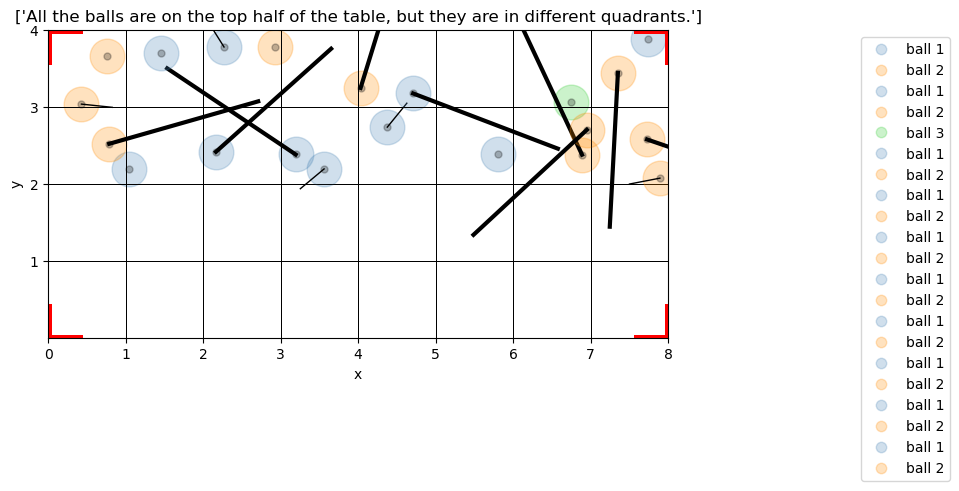

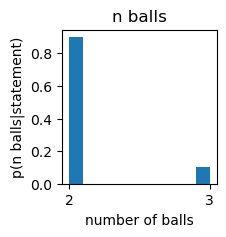

  1.288006 seconds (215.29 k allocations: 13.758 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [483]:
reference_statements = ["All the balls are on the top half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 2 balls on the bottom half of the table, but they are in different quadrants."]
There are 2 balls on the bottom half of the table, but they are in different quadrants.
----------------
-5.940171252720432
-5.940171252720432
-5.940171252720432
-Inf
-Inf
-Inf
-5.480638923341992
-4.222045034535831
-5.480638923341992
-5.940171252720432
  

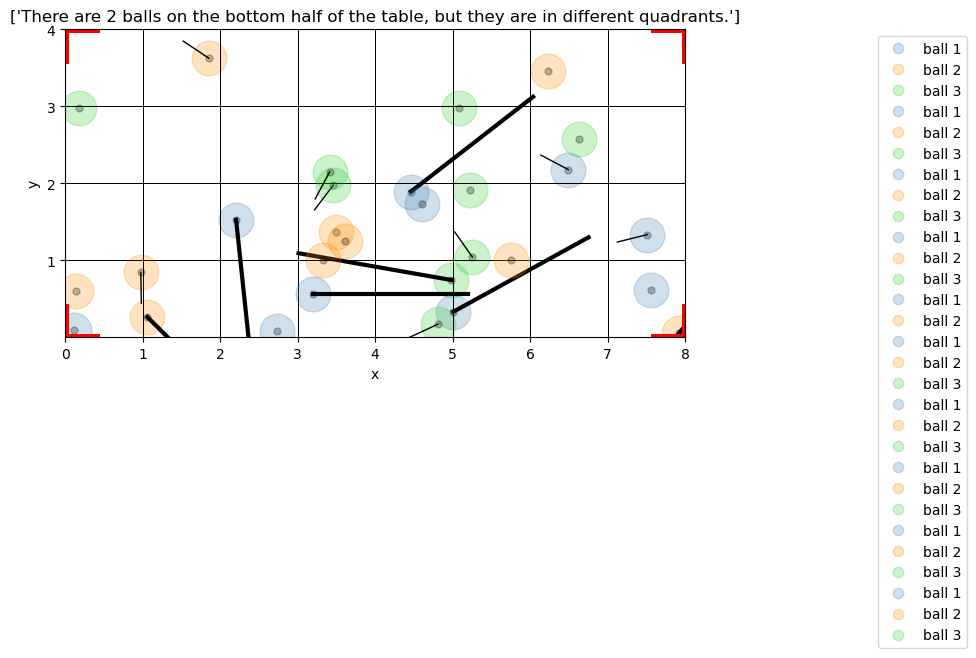

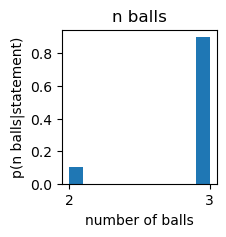

0.440532 seconds (121.50 k allocations: 7.494 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [484]:
reference_statements = ["There are 2 balls on the bottom half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the bottom half of the table, but they are in different quadrants."]
All the balls are on the bottom half of the table, but they are in different quadrants.
----------------
-4.90527477843843
-Inf
-6.1737861039019375
-Inf
-6.1737861039019375
-Inf
-6.1737861039019375
-6.1737861039019375
-4.90527477843843
-Inf


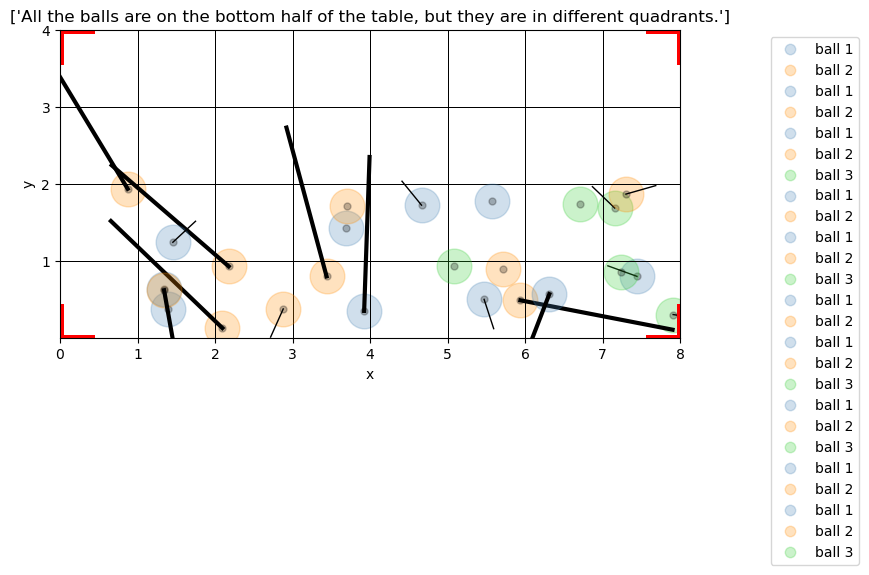

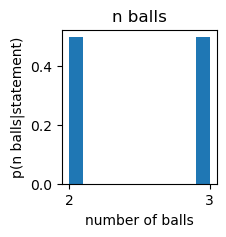

  0.433424 seconds (143.69 k allocations: 8.985 MiB, 4.88% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [485]:
reference_statements = ["All the balls are on the bottom half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the same half (top/bottom) of the table."]
There are 3 balls on the same half (top/bottom) of the table.
----------------
-Inf
-Inf
-Inf
-Inf
-5.480638923341992
-Inf
-5.64571867370144
-6.1737861039019375
-Inf
-6.1737861039019375


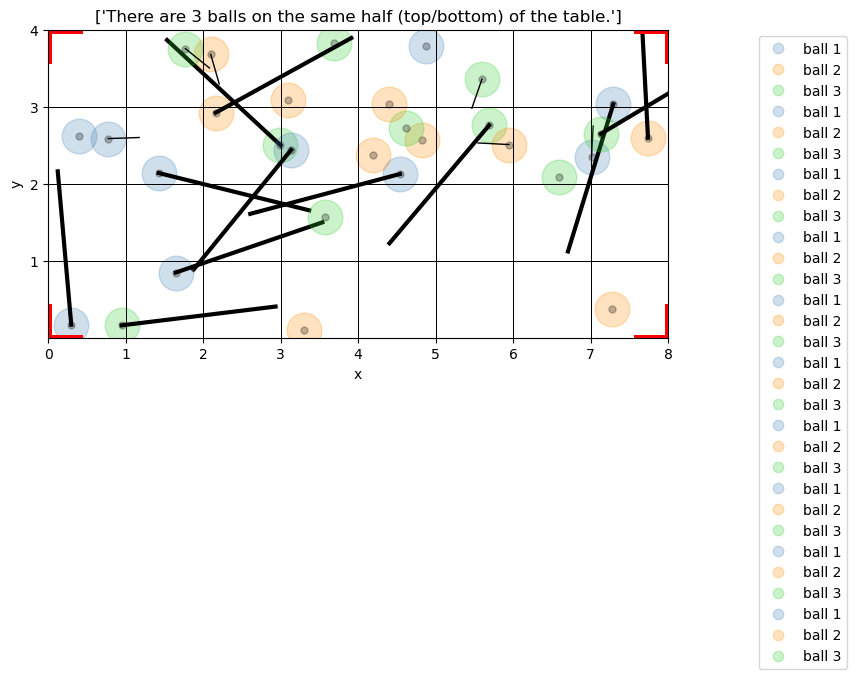

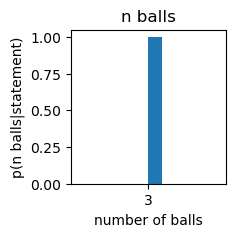

  0.436463 seconds (188.56 k allocations: 11.863 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [493]:
reference_statements = ["There are 3 balls on the same half (top/bottom) of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls in the same quadrant of the table."]
There are 3 balls in the same quadrant of the table.
----------------
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf
-6.492239835020471
-Inf
-6.536691597591306
  

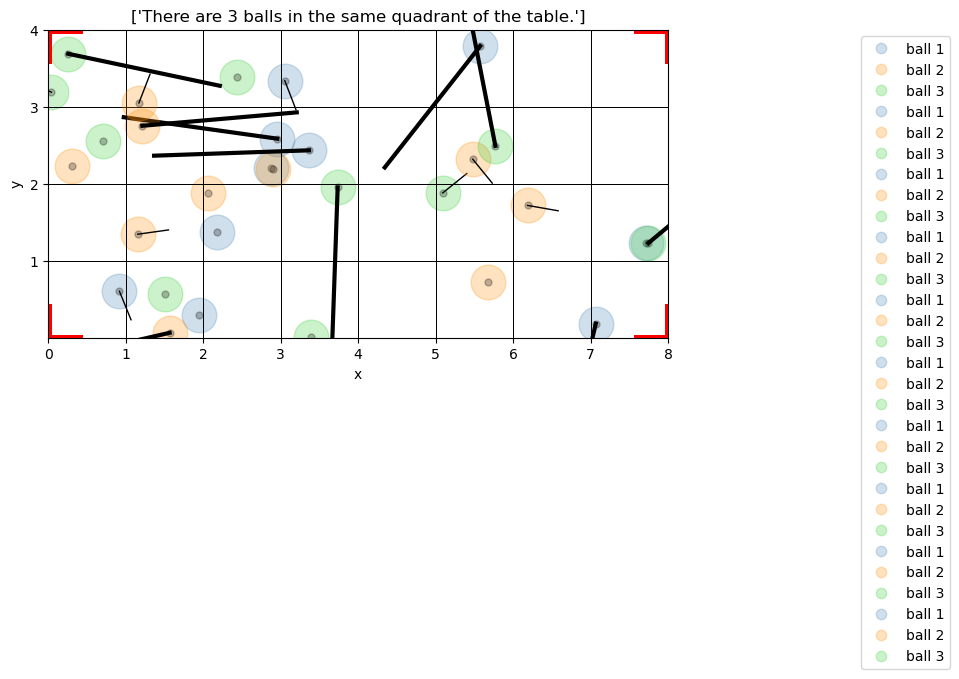

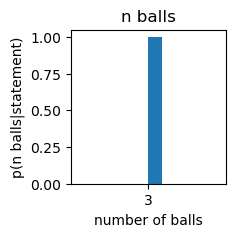

1.046525 seconds (236.63 k allocations: 15.042 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [498]:
reference_statements = ["There are 3 balls in the same quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls in the same quadrant of the table and on the left side of the table."]
There are 3 balls in the same quadrant of the table and on the left side of the table.
----------------
-Inf


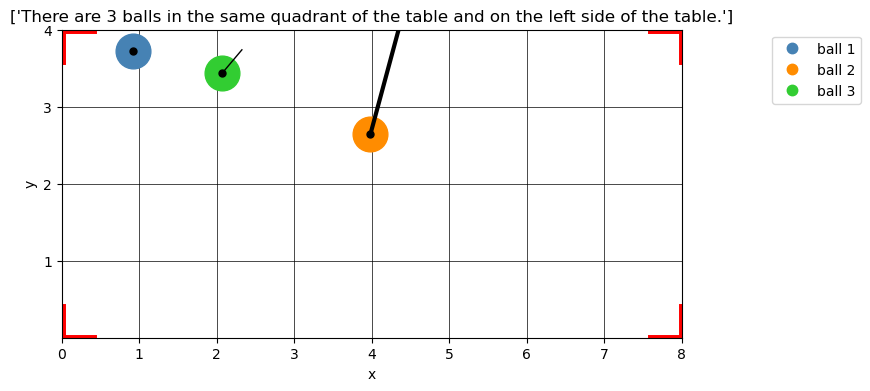

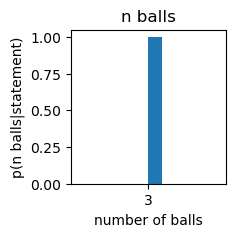

  0.076359 seconds (251.93 k allocations: 16.420 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [503]:
reference_statements = ["There are 3 balls in the same quadrant of the table and on the left side of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 1, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls in the bottom left quadrant of the table."]
There are 3 balls in the bottom left quadrant of the table.
----------------
-Inf
-8.794824928014517
-8.794824928014517
-Inf
-Inf
-8.101677747454572
-8.794824928014517
-Inf
-8.794824928014517
-Inf
  

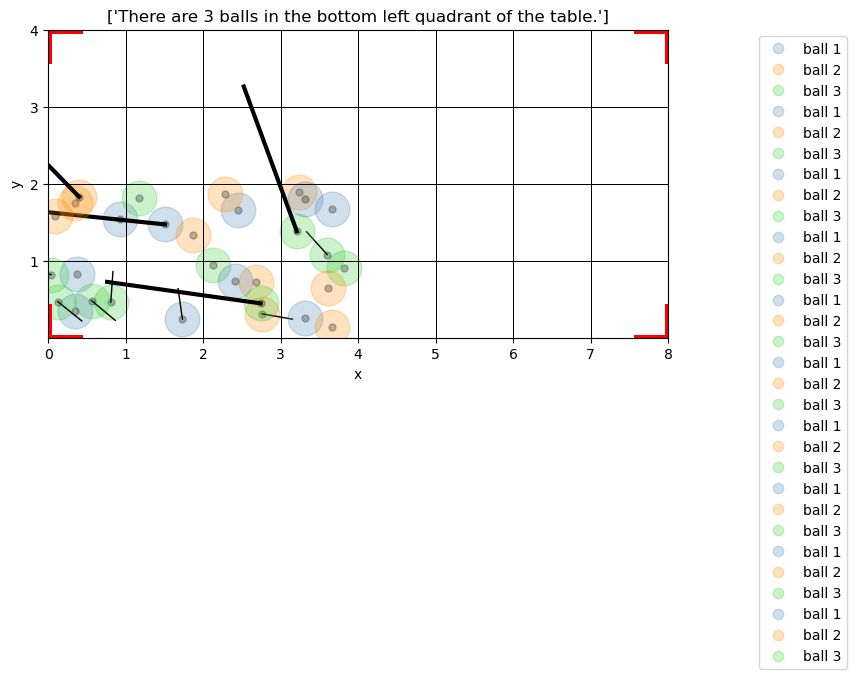

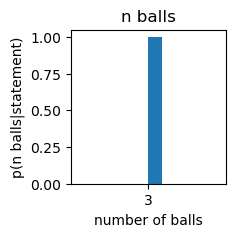

0.555988 seconds (1.42 M allocations: 92.901 MiB, 3.70% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [506]:
reference_statements = ["There are 3 balls in the bottom left quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls in the top left quadrant of the table."]
There are 3 balls in the top left quadrant of the table.
----------------
-8.83927669058535
-Inf
-Inf
-8.83927669058535
-Inf
-Inf
-Inf
-Inf
-8.83927669058535
-8.83927669058535
  

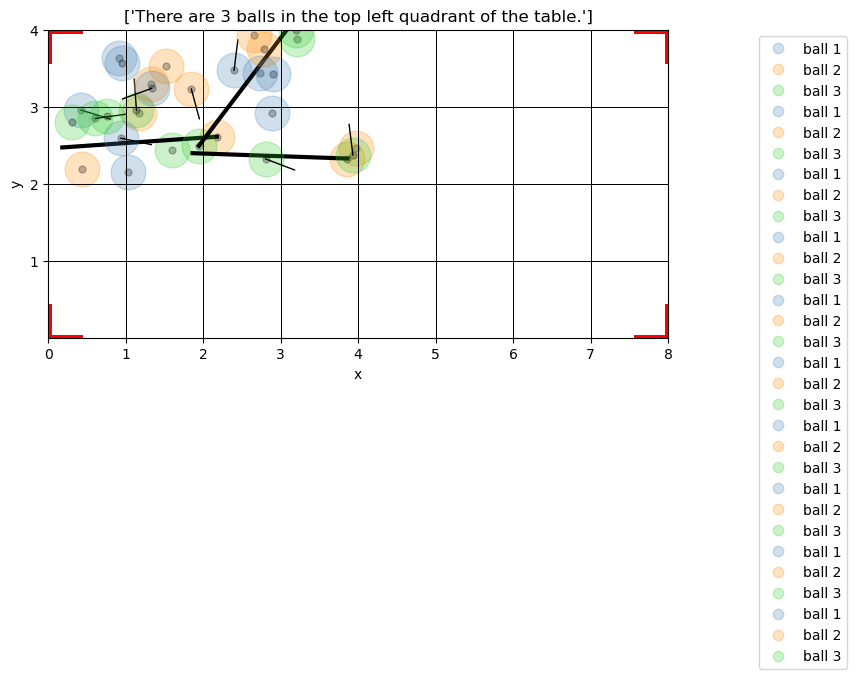

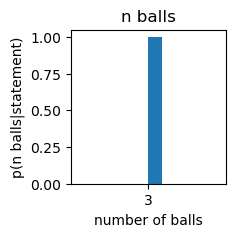

1.978811 seconds (1.66 M allocations: 108.906 MiB, 7.90% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [507]:
reference_statements = ["There are 3 balls in the top left quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls in the same quadrant of the table and on the right side of the table."]
There are 3 balls in the same quadrant of the table and on the right side of the table.
----------------
-Inf
  

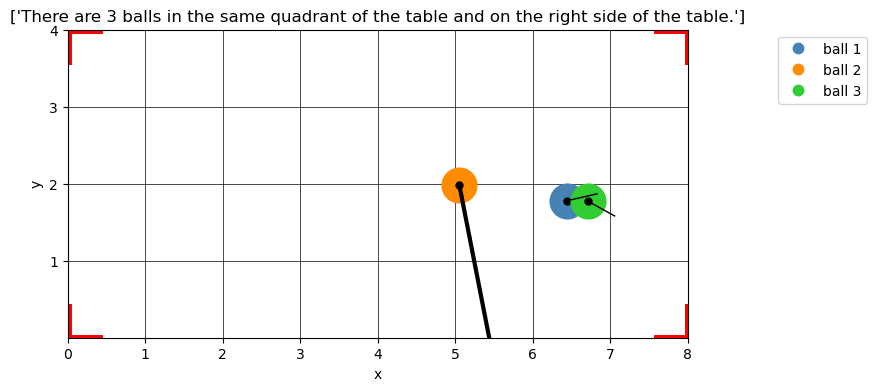

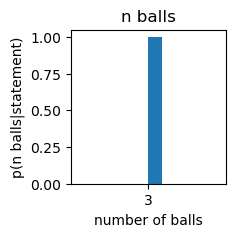

0.060139 seconds (266.63 k allocations: 17.601 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [512]:
reference_statements = ["There are 3 balls in the same quadrant of the table and on the right side of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 1, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls in the bottom right quadrant of the table."]
There are 3 balls in the bottom right quadrant of the table.
----------------
-Inf
-Inf
-Inf
-8.101677747454572
-8.794824928014517
-Inf
-Inf
-Inf
-Inf
-8.794824928014517


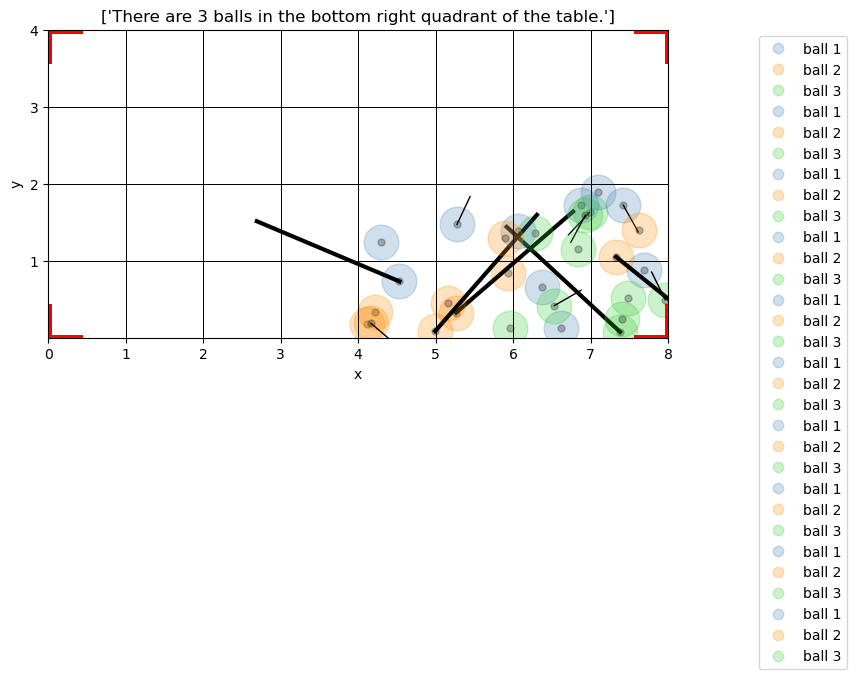

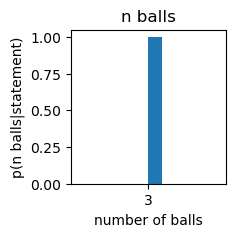

  0.822020 seconds (1.87 M allocations: 122.320 MiB, 21.30% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [517]:
reference_statements = ["There are 3 balls in the bottom right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls in the top right quadrant of the table."]
There are 3 balls in the top right quadrant of the table.
----------------
-11.097410021008562
-10.404262840448617
-9.48797210857446
-9.48797210857446
-9.998797732340453
-9.711115659888671
-9.017968479328726
-9.305650551780507
-9.998797732340453
-9.48797210857446
-9.151499871953249
-9.998797732340453
-9.711115659888671
-10.404262840448617
-9.711115659888671
-9.48797210857446
-10.404262840448617
-8.900185443672342
-9.48797210857446
-9.998797732340453
-9.48797210857446
-9.48797210857446
-9.151499871953249
-9.48797210857446
-9.711115659888671
-10.404262840448617
-9.998797732340453
-9.48797210857446
-9.998797732340453
-9.151499871953249
-10.404262840448617
-9.711115659888671
-9.998797732340453
-9.998797732340453
-10.404262840448617
-10.404262840448617
-10.404262840448617
-10.404262840448617
-11.097410021008562
-9.711115659888671
-8.794824928014517
-9.711115659888671
-9.017968479328726
-9.998797732340453
-9.711115659888671
-9.711

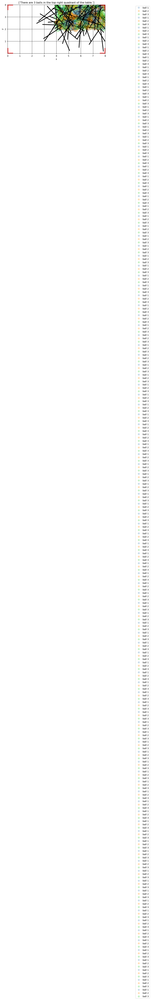

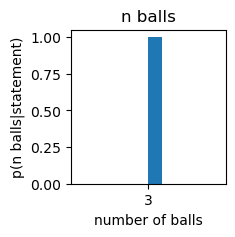

32.535178 seconds (27.61 M allocations: 1.919 GiB, 0.89% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [25]:
reference_statements = ["There are 3 balls in the top right quadrant of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 1000, 100, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the same half (left/right) of the table."]
There are 3 balls on the same half (left/right) of the table.
----------------
-Inf
-Inf
-6.1092475827643655
-6.536691597591306
-6.1092475827643655
-Inf
-Inf
-Inf
-6.1092475827643655
-6.1092475827643655
  

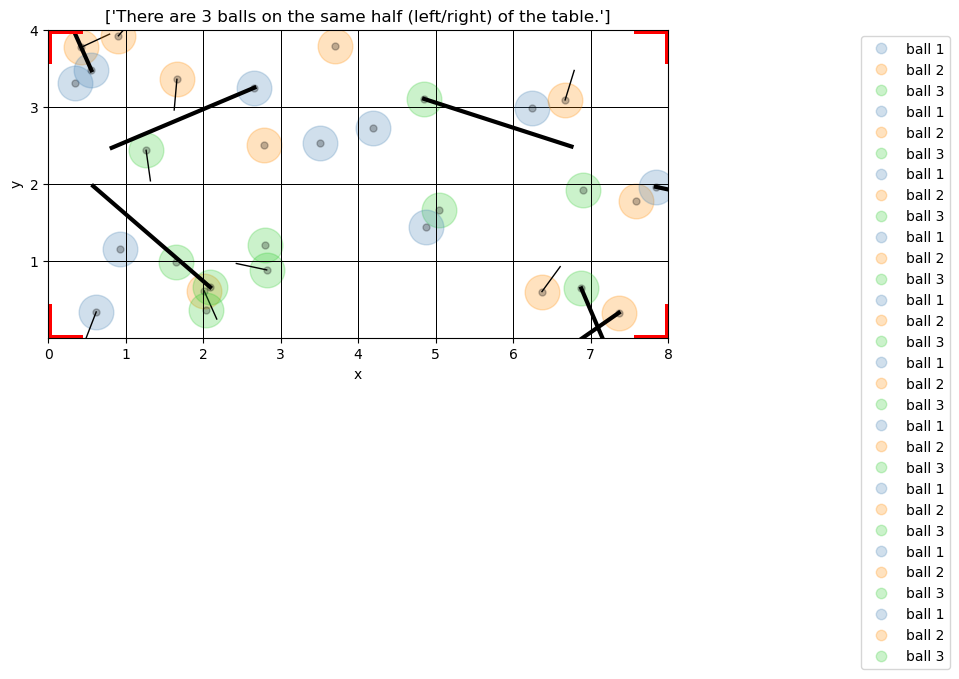

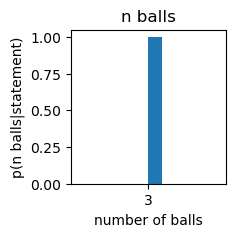

1.019691 seconds (166.30 k allocations: 10.415 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [525]:

reference_statements = ["There are 3 balls on the same half (left/right) of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the left half of the table."]
There are 3 balls on the left half of the table.
----------------
-Inf
-5.589372123478457
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf
-6.1092475827643655
-Inf
  

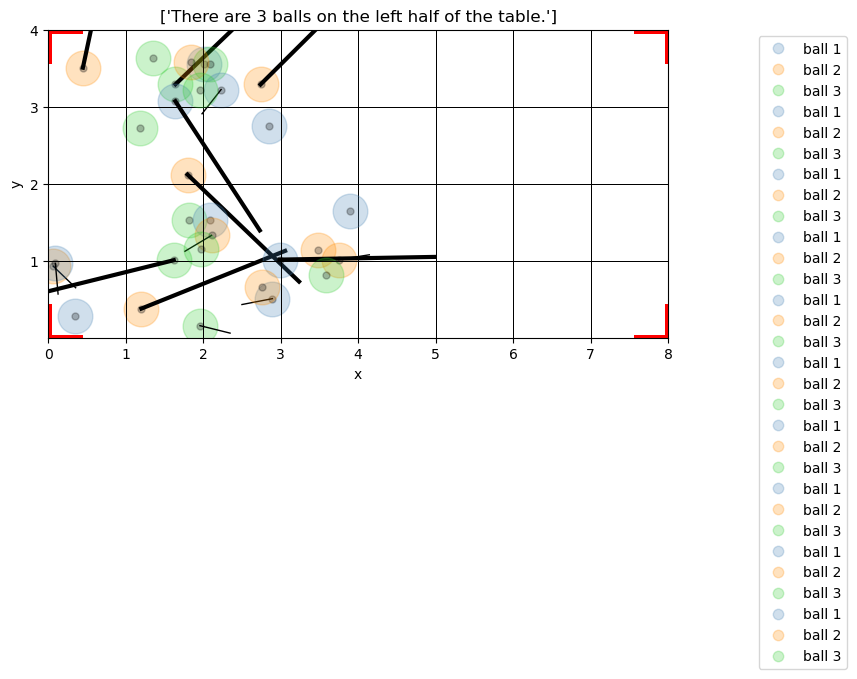

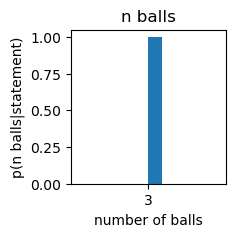

0.883921 seconds (233.69 k allocations: 14.805 MiB, 26.50% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [526]:
reference_statements = ["There are 3 balls on the left half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the same half (left/right) of the table."]
There are 3 balls on the same half (left/right) of the table.
----------------
-6.1092475827643655


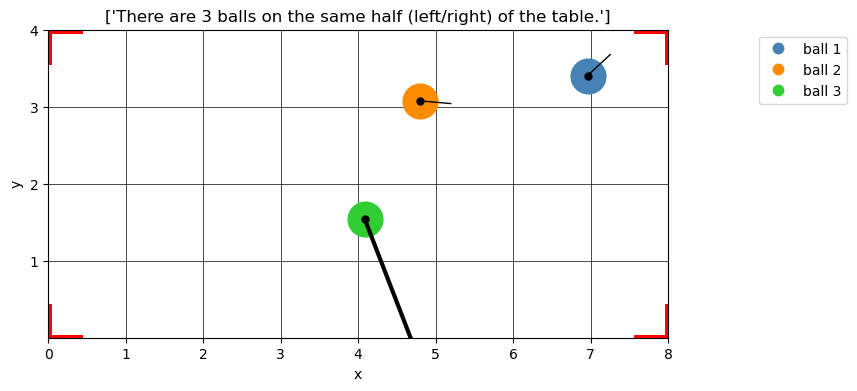

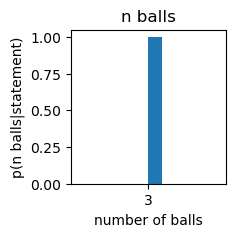

  0.055275 seconds (5.33 k allocations: 298.406 KiB)


PyObject Text(0.5, 1.0, 'n balls')

In [531]:
reference_statements = ["There are 3 balls on the same half (left/right) of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 1, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the right half of the table."]
There are 3 balls on the right half of the table.
----------------
-Inf
-5.41610040220442
-6.1092475827643655
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf


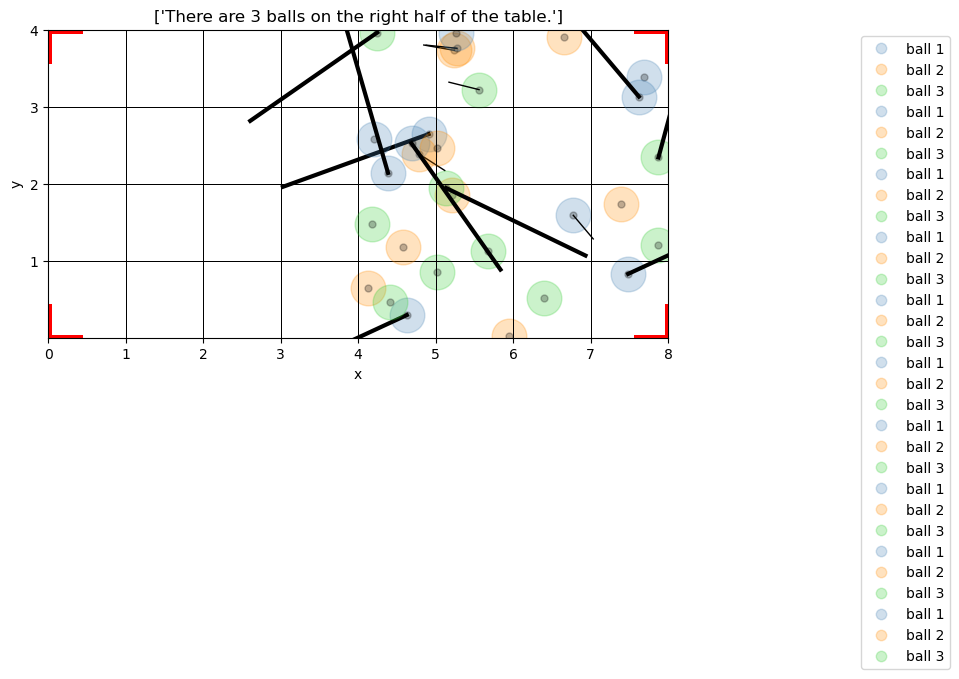

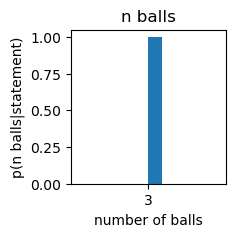

  0.557789 seconds (240.05 k allocations: 15.316 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [533]:
reference_statements = ["There are 3 balls on the right half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the bottom half of the table."]
There are 3 balls on the bottom half of the table.
----------------
-Inf
-6.1737861039019375
-6.1737861039019375
-Inf
-Inf
-6.1737861039019375
-Inf
-Inf
-Inf
-Inf
  

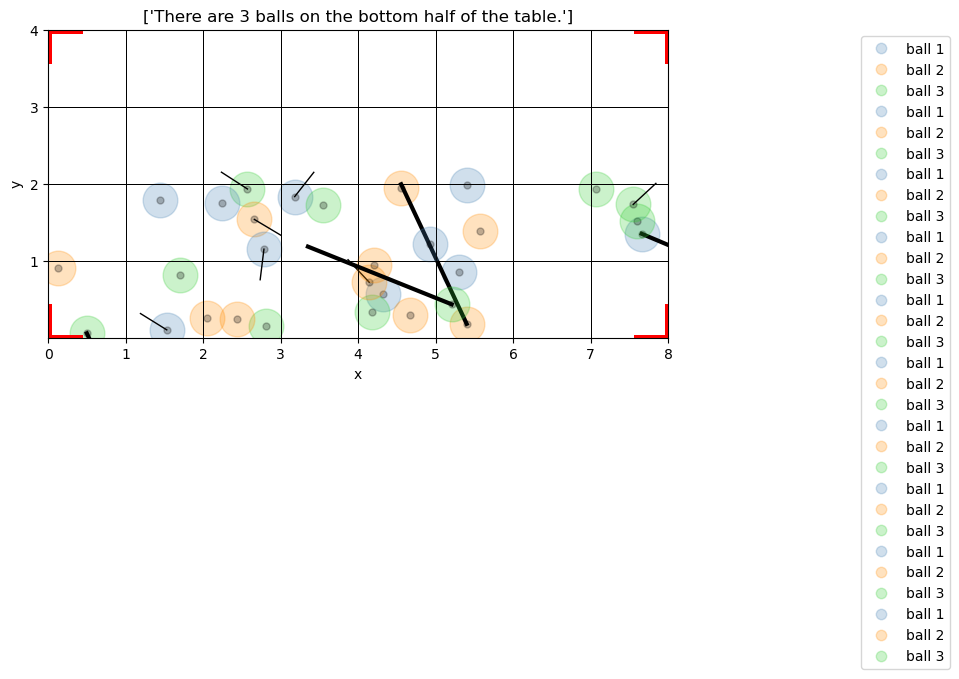

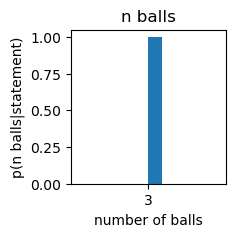

1.431426 seconds (236.75 k allocations: 15.059 MiB, 1.06% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [534]:
reference_statements = ["There are 3 balls on the bottom half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the top half of the table."]
There are 3 balls on the top half of the table.
----------------
-Inf
-6.1737861039019375
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf
-6.536691597591306


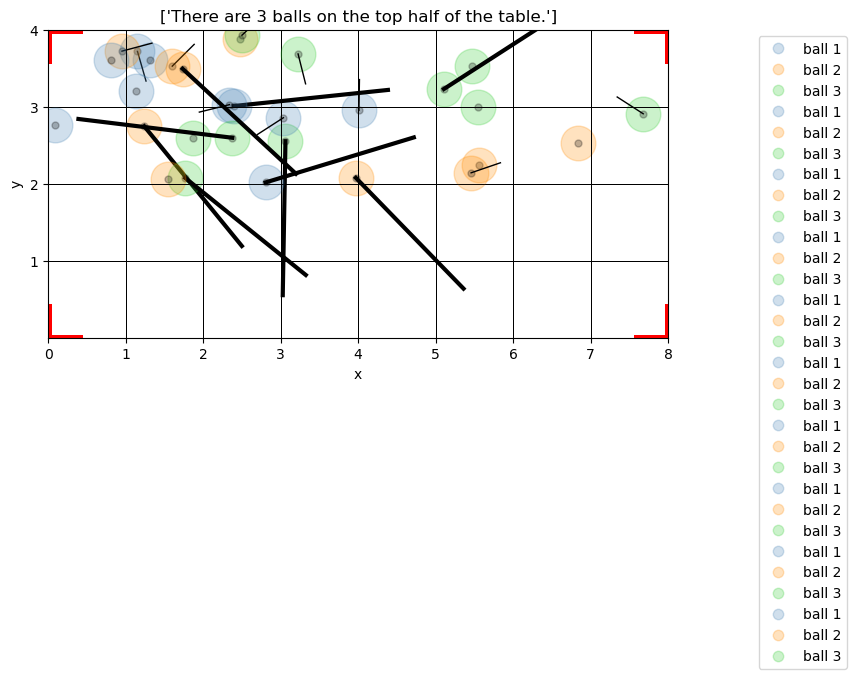

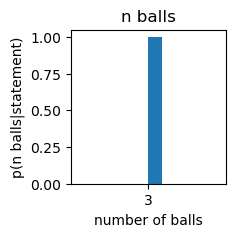

  0.478296 seconds (238.17 k allocations: 15.150 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [535]:
reference_statements = ["There are 3 balls on the top half of the table."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls are on the bottom half of the table, and they are in the same quadrant."]
There are 3 balls are on the bottom half of the table, and they are in the same quadrant.
----------------
-8.794824928014517
-8.101677747454572
-8.101677747454572
-8.794824928014517
-8.101677747454572
-Inf
-8.794824928014517
-8.794824928014517
-Inf
-8.794824928014517


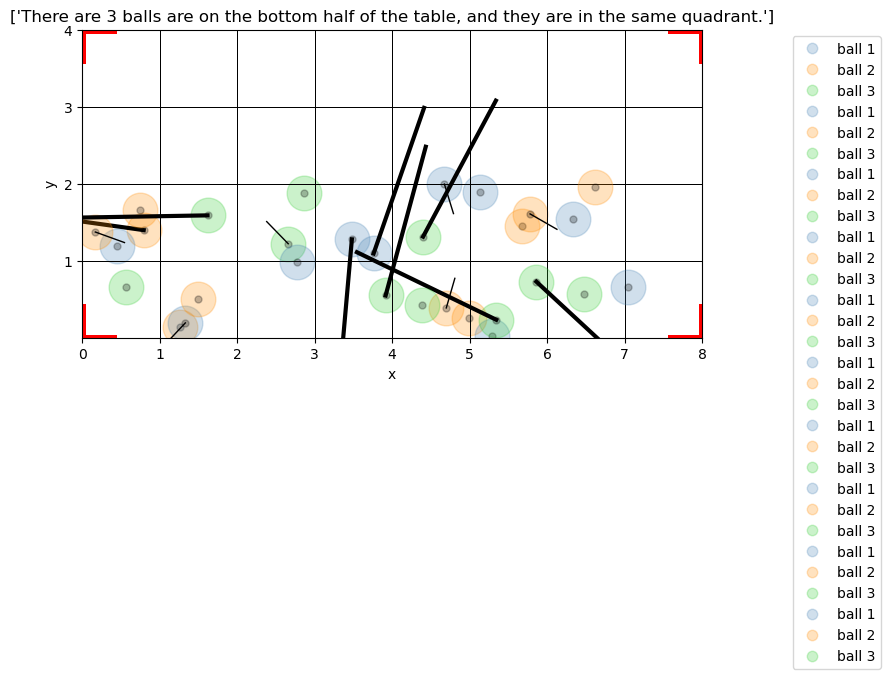

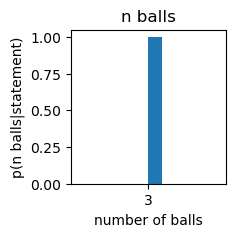

  0.695463 seconds (717.42 k allocations: 46.611 MiB, 23.38% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [537]:
reference_statements = ["There are 3 balls are on the bottom half of the table, and they are in the same quadrant."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the bottom half of the table, but they are in different quadrants."]
There are 3 balls on the bottom half of the table, but they are in different quadrants.
----------------
-7.377758908227873
-7.090076835776093
-8.476371196895983
-8.476371196895983
-8.476371196895983
-6.684611727667928
-7.377758908227873
-7.377758908227873
-8.476371196895983
-6.866933284461883


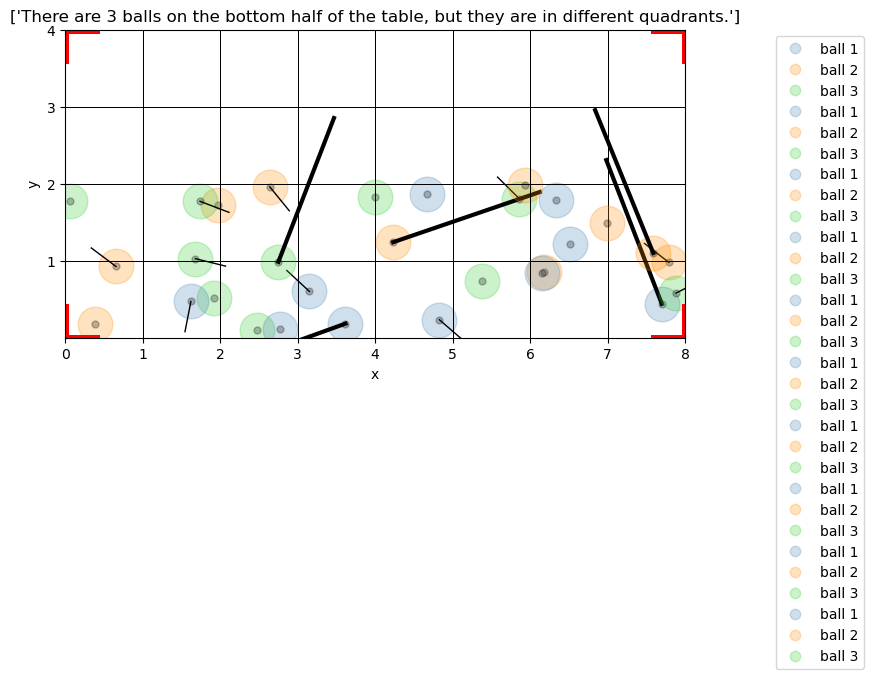

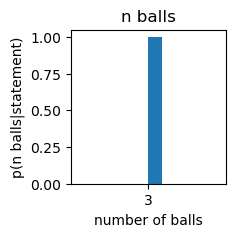

  1.383252 seconds (259.54 k allocations: 16.710 MiB, 0.96% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [538]:
reference_statements = ["There are 3 balls on the bottom half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the bottom half of the table, but they are in different quadrants."]
All the balls are on the bottom half of the table, but they are in different quadrants.
----------------
-Inf
-Inf
-Inf
-6.1737861039019375
-Inf
-Inf
-Inf
-Inf
-6.1737861039019375
-Inf
  

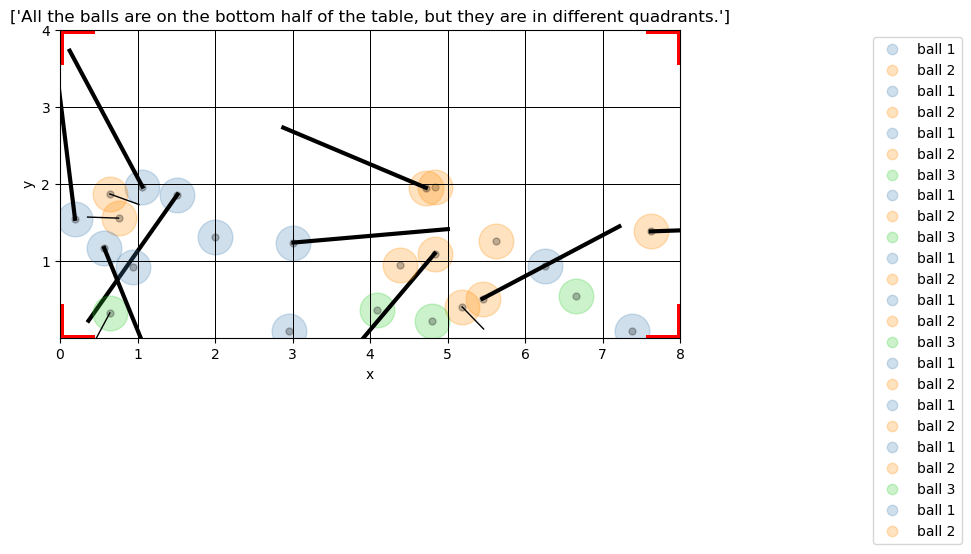

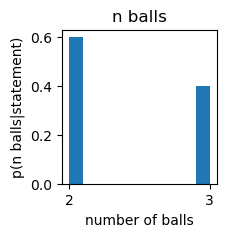

0.352778 seconds (249.75 k allocations: 15.826 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [540]:
reference_statements = ["All the balls are on the bottom half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All the balls are on the top half of the table, but they are in different quadrants."]
All the balls are on the top half of the table, but they are in different quadrants.
----------------
-4.657438614533849
-Inf
-6.1737861039019375
-Inf
-Inf
-Inf
-5.480638923341992
-Inf
-Inf
-4.212127597878484
  

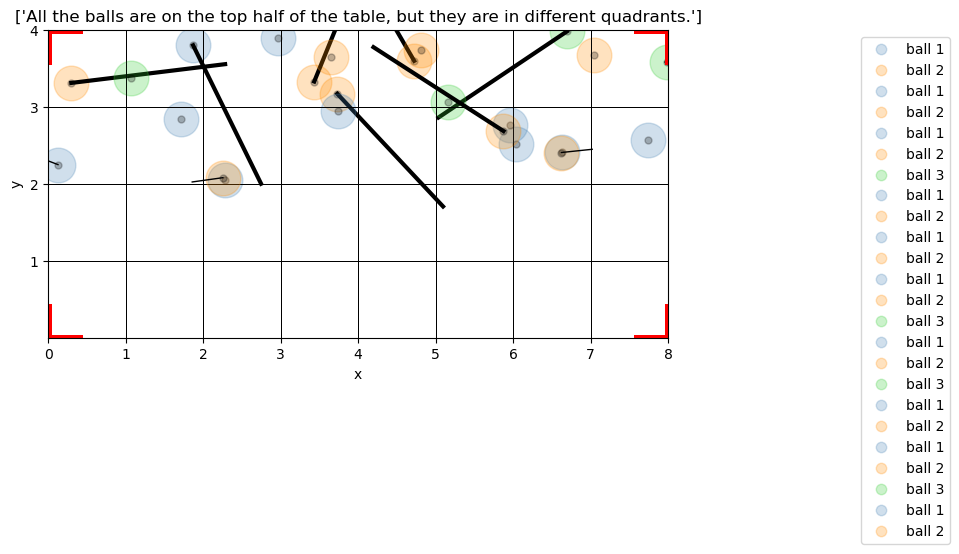

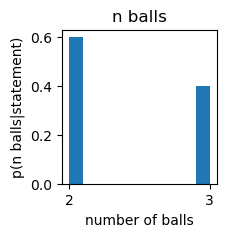

0.427693 seconds (189.59 k allocations: 12.005 MiB, 3.47% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [541]:
reference_statements = ["All the balls are on the top half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls are on the top half of the table, and they are in the same quadrant."]
There are 3 balls are on the top half of the table, and they are in the same quadrant.
----------------
-6.536691597591306
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf
-Inf


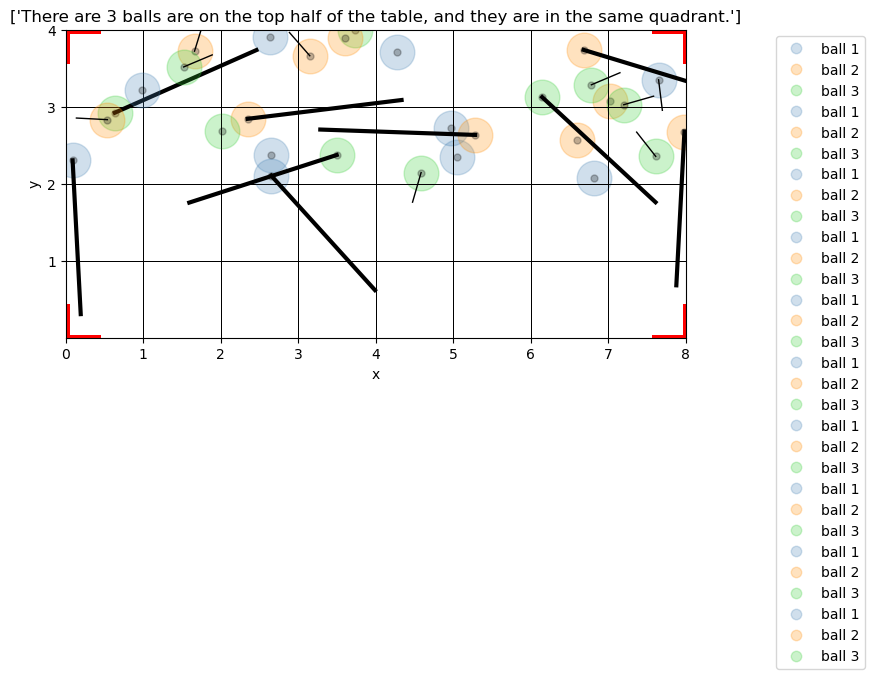

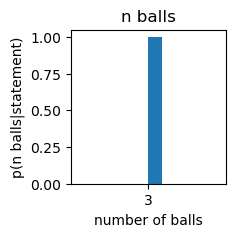

  1.292688 seconds (349.28 k allocations: 22.389 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [542]:
reference_statements = ["There are 3 balls are on the top half of the table, and they are in the same quadrant."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the top half of the table, but they are in different quadrants."]
There are 3 balls on the top half of the table, but they are in different quadrants.
----------------
-6.1737861039019375
-6.1737861039019375
-Inf
-Inf
-Inf
-6.1737861039019375
-Inf
-Inf
-6.1737861039019375
-Inf
  

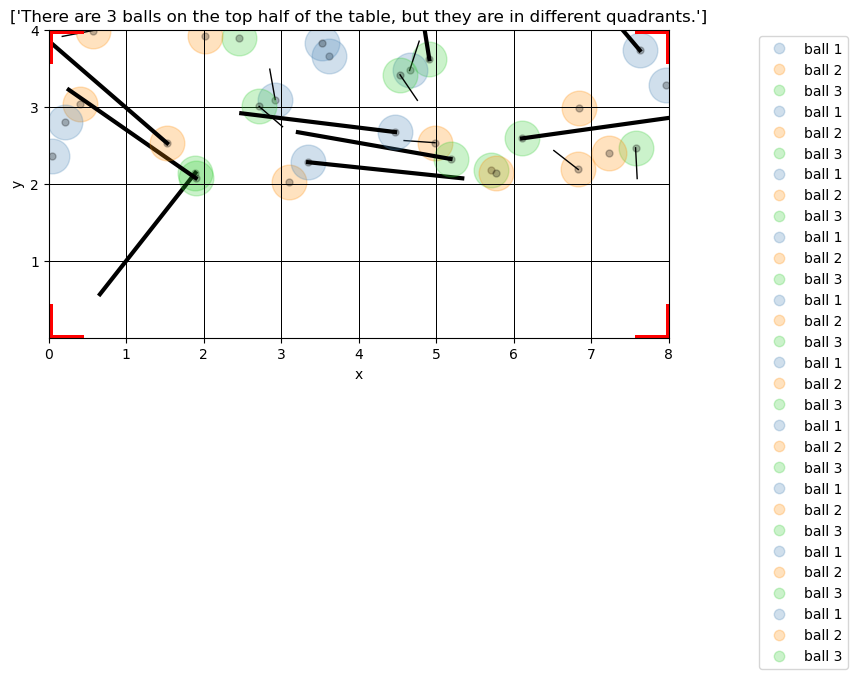

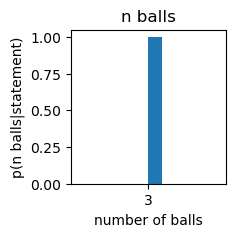

0.429069 seconds (189.13 k allocations: 11.924 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [546]:
reference_statements = ["There are 3 balls on the top half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 10, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the right half of the table, but they are in different quadrants."]
There are 3 balls on the right half of the table, but they are in different quadrants.
----------------
-7.090076835776093
-7.783224016336037
-7.090076835776093
-8.476371196895983
-7.783224016336037
-7.090076835776093
-6.684611727667928
-7.090076835776093
-7.377758908227873
-6.684611727667928
  

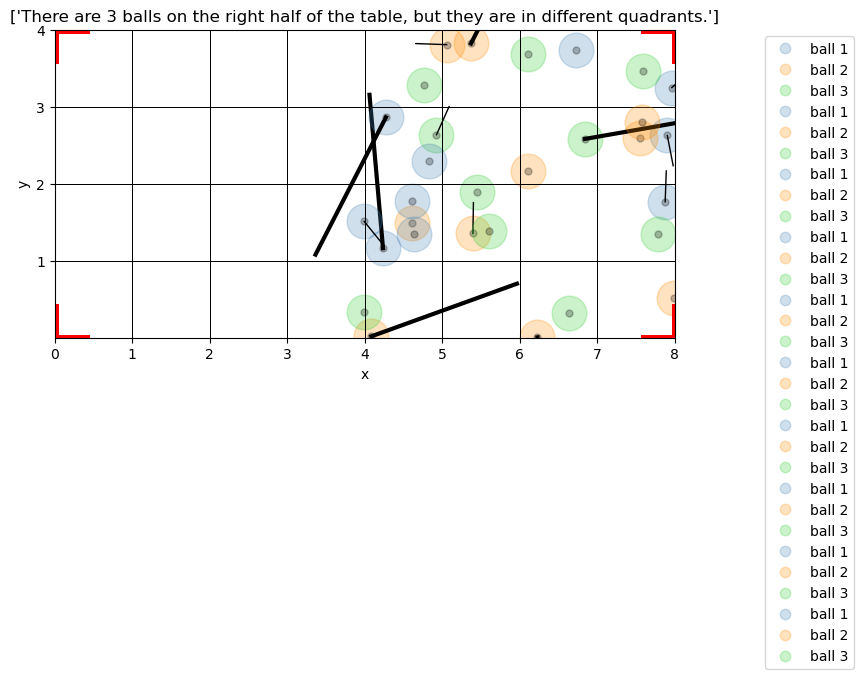

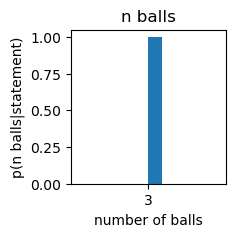

1.378351 seconds (268.47 k allocations: 17.291 MiB, 0.76% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [562]:
reference_statements = ["There are 3 balls on the right half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["There are 3 balls on the left half of the table, but they are in different quadrants."]
There are 3 balls on the left half of the table, but they are in different quadrants.
----------------
-6.866933284461883
-8.476371196895983
-8.476371196895983
-7.377758908227873
-7.377758908227873
-8.476371196895983
-7.783224016336037
-8.476371196895983
-7.783224016336037
-7.377758908227873


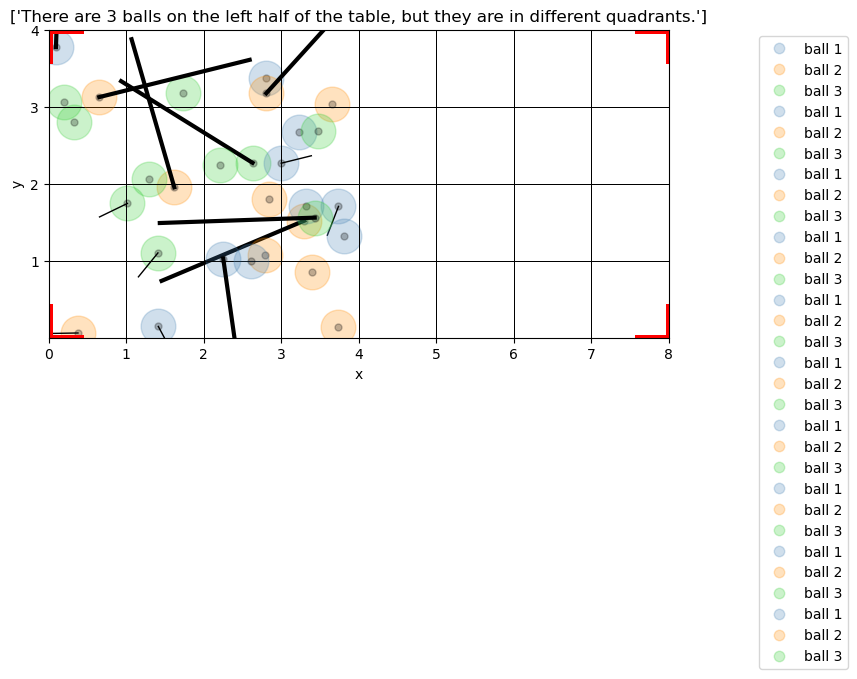

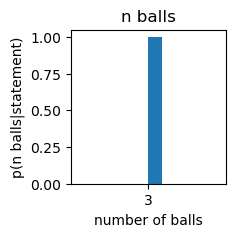

  0.425557 seconds (257.49 k allocations: 16.419 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [563]:
reference_statements = ["There are 3 balls on the left half of the table, but they are in different quadrants."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

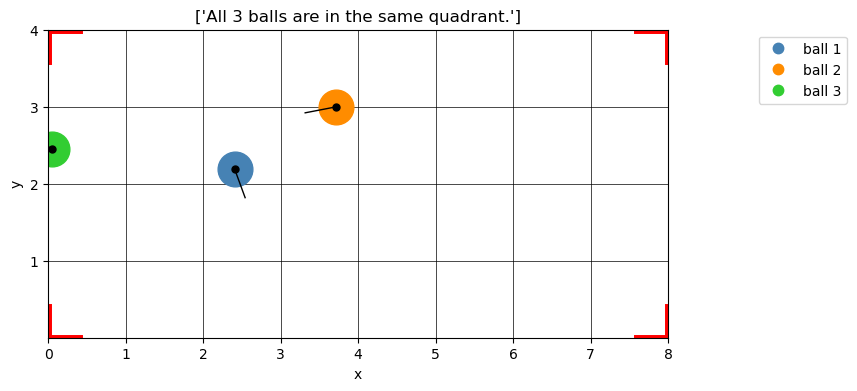

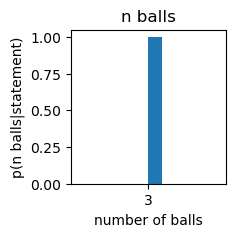

["All 3 balls are in the same quadrant."]
All 3 balls are in the same quadrant.
----------------
-8.794824928014517
  0.048055 seconds (25.08 k allocations: 1.578 MiB)


PyObject Text(0.5, 1.0, 'n balls')

In [570]:
reference_statements = ["All 3 balls are in the same quadrant."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 100, 1, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All 3 balls are in the top left quadrant."]
All 3 balls are in the top left quadrant.
----------------
-11.097410021008562
-9.711115659888671
-9.711115659888671
-10.404262840448617
-9.998797732340453
-9.711115659888671
-9.48797210857446
-10.404262840448617
-10.404262840448617
-9.48797210857446


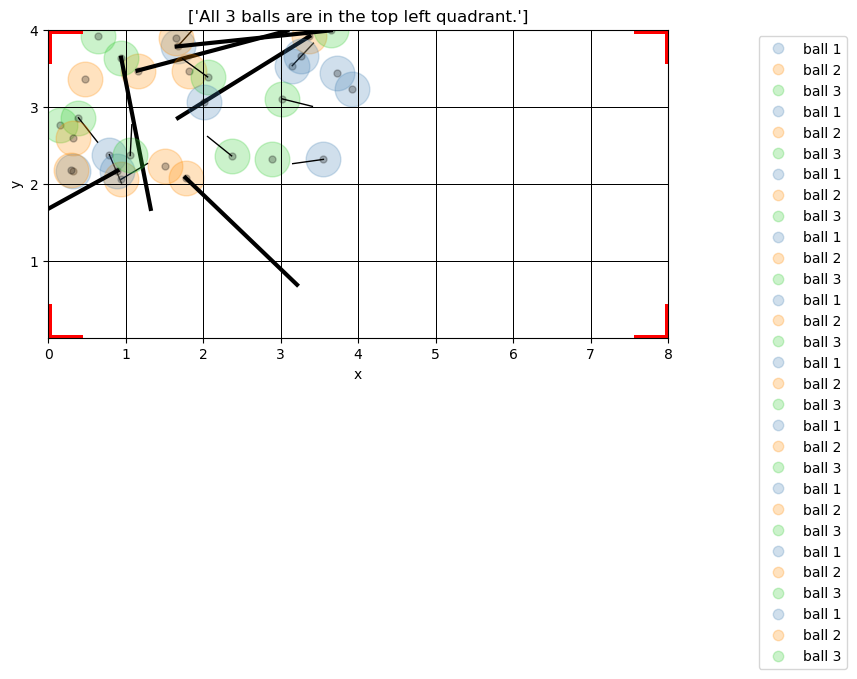

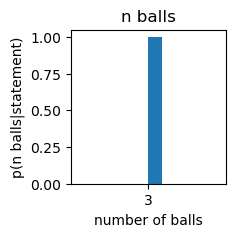

  1.241787 seconds (2.36 M allocations: 154.733 MiB, 2.29% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [573]:
reference_statements = ["All 3 balls are in the top left quadrant."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 1000, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All 3 balls are in the top right quadrant."]
All 3 balls are in the top right quadrant.
----------------
-9.48797210857446
-9.305650551780507
-9.711115659888671
-9.017968479328726
-9.151499871953249
-9.711115659888671
-9.711115659888671
-9.305650551780507
-9.305650551780507
-9.998797732340453
  

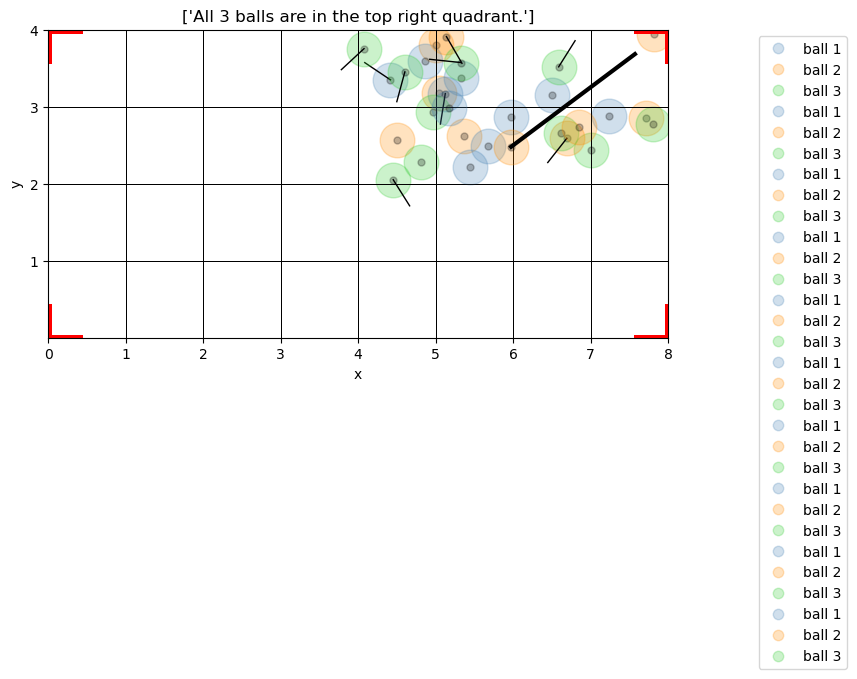

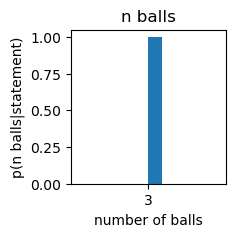

0.638353 seconds (2.35 M allocations: 154.485 MiB, 5.89% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [574]:
reference_statements = ["All 3 balls are in the top right quadrant."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 1000, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All 3 balls are in the bottom right quadrant."]
All 3 balls are in the bottom right quadrant.
----------------
-9.998797732340453
-9.711115659888671
-9.998797732340453
-9.48797210857446
-9.305650551780507
-11.097410021008562
-9.48797210857446
-9.151499871953249
-9.711115659888671
-9.711115659888671


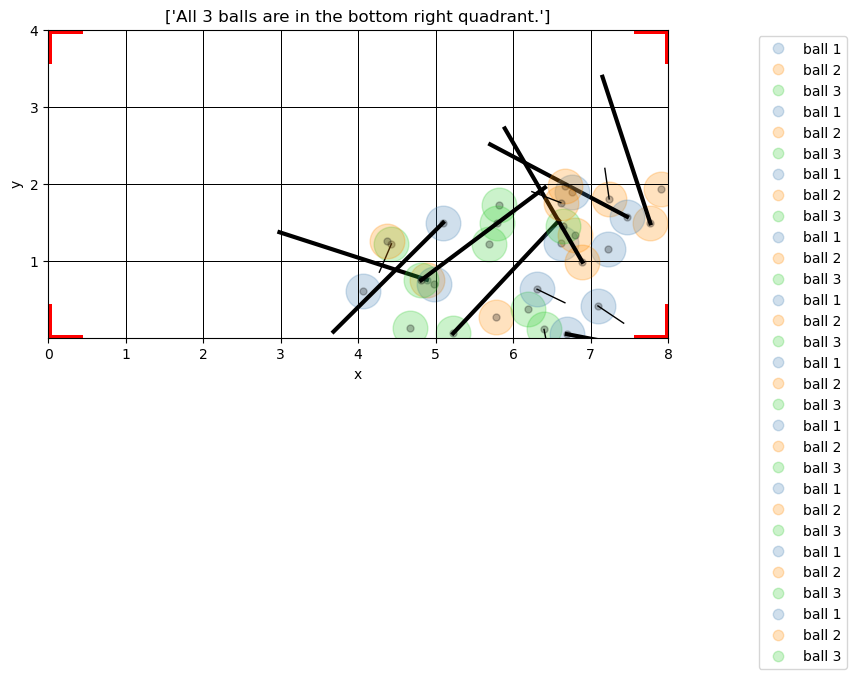

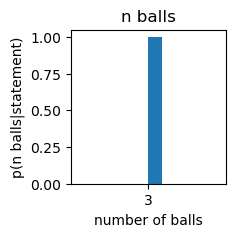

  0.604268 seconds (2.33 M allocations: 152.725 MiB, 5.24% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [575]:
reference_statements = ["All 3 balls are in the bottom right quadrant."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 1000, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

["All 3 balls are in the bottom left quadrant."]
All 3 balls are in the bottom left quadrant.
----------------
-9.305650551780507
-9.711115659888671
-9.711115659888671
-9.711115659888671
-10.404262840448617
-9.998797732340453
-10.404262840448617
-9.998797732340453
-9.48797210857446
-10.404262840448617
  

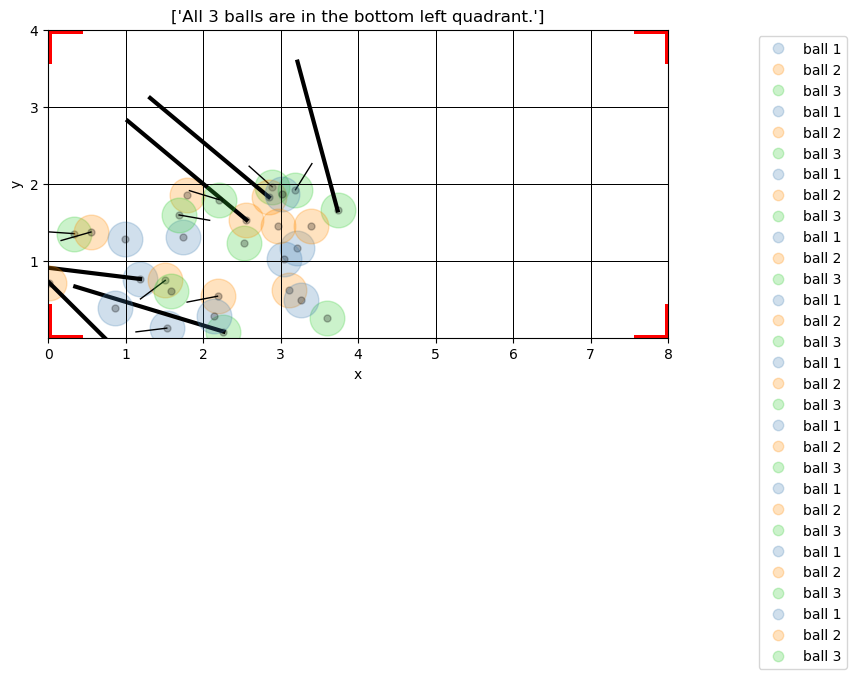

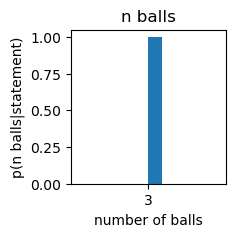

0.658969 seconds (2.36 M allocations: 155.174 MiB, 6.54% gc time)


PyObject Text(0.5, 1.0, 'n balls')

In [576]:
reference_statements = ["All 3 balls are in the bottom left quadrant."]
println(reference_statements)

@time traces = infer_worlds((8,4), 1, reference_statements, 1000, 10, verbose=true);
ns = get_infered_n_balls(traces)
render_distribution(ns, "number of balls"; t="n balls", condition="statement", ax=nothing)

# The conditioning worked! yay.
Comparison with direct input of :n :

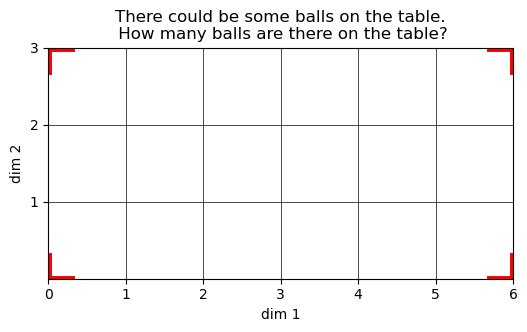

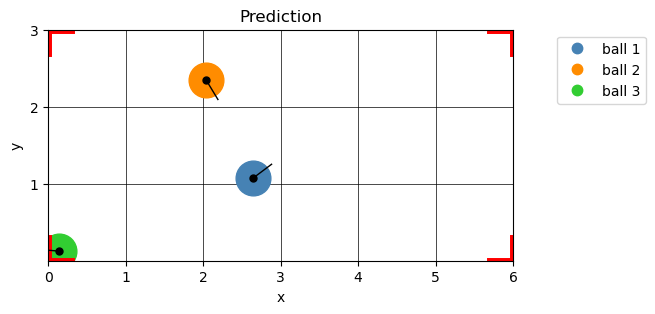

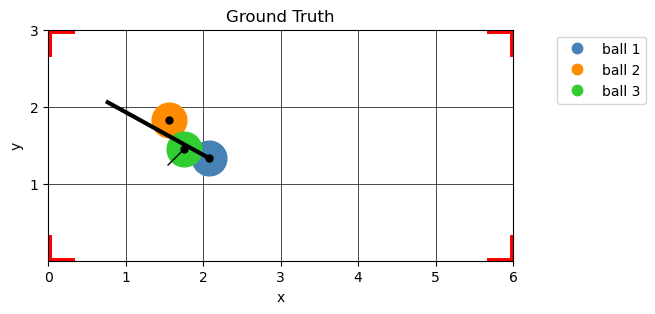

3
----------------
There are 3 balls on the table.
There is at least 1 ball on the table.
There are at least 2 balls on the table.
There are some balls on the table.
There are at least 3 balls on the table.
There are a lot of balls on the table.
There are no more than 3 balls on the table.
There could be some balls on the table.


In [85]:
@gen function test_constrain_n(model, tableSize, nStatements, reference_trace, amount_of_computation)
    #
    #  We want to constrain the statement to be possible for a given world.
    #
    constraint = reference_trace[:n];
    println(constraint[1])
    println("----------------")
    constraints = Gen.choicemap();
    constraints[:n] = constraint[1];
    
    (trace, _) = Gen.generate(model, (tableSize, false, nStatements), constraints)
    ret = Gen.get_retval(trace);
#     statements = ret[1]
    posssibleStatements = ret[2]
#     println(" ...Inferring a possible world that matches")
#     println("    Generated statements:")
    pretty_print_list(posssibleStatements)

#     println(" ")
#     println("    Possible statements:")
#     pretty_print_list(posssibleStatements)
    return trace
end;


ret = present_world((6,3),1)
reference_statements = ret[1];
reference_trace = ret[2];

inferred_trace = test_constrain_n(pool_world_model, (6,3),1,reference_trace,100);
# inferred_trace = infer_n_balls(pool_world_model, (6,3),1,reference_statements,100);
plot_pool_world(inferred_trace,true);
title("Prediction");

plot_pool_world(reference_trace,false);
title("Ground Truth");
# println(string("The statement given was: ",reference_statements))

# Implementing other verbal descriptions to describe the scene

Tomorrow we should list out the other predictors and their levels of ambiguity

We should also brainstorm interesting inferences to try and show a proof of concept of each one both on humans and on the inferred posterior

We also want to have a wsy of asking which scenario more likely, e.g., get a point probability for each spot on the grid. Compare to human results

## Importance Resampling -- ok if only need to get one parameter conditioned...but if need multiple things right, it'll be too slow

The problem is if we want to condition on a lot of things being true, the chances the model will guess that thing in a reasonable number of tries is really unlikely. Instead, want to use iterative sampling that will go till the gen model hits one of the conditions correctly and then searches again for a next hit so we don't waste so much time throwing out the many models that won't ever fit the conditioning...

### We will next apply an MCMC method to gather a posterior for the paramter of interest, e.g., number of balls on the table, will a ball collide, etc...

I'll note that MCMC probably not needed unless we want to set multiple constraints...or if we get lots of random choices. The more statements we choose, for example...